# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [11]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [12]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [13]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [14]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

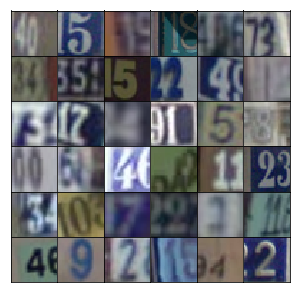

In [15]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [16]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [17]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [18]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [19]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        # change shape to work with the convolutional layers, we do have a flat array now
        x = tf.reshape(x, (-1, 4, 4, 512))
        # introduce batch normalization at input
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        # Dimensions: 4 * 4 * 512
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        # Dimensions: 8 * 8 * 256
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        # Dimensions: 16 * 16 * 128
        logits = tf.layers.conv2d_transpose(x, output_dim, 5, strides=2, padding='same')
        # Dimensions: 32 * 32 * 3
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [30]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')  # No batch normalization here
        x = tf.maximum(alpha * x, x) # LeakyRelu
        # 16x16x64
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='same') # deepening
        x = tf.layers.batch_normalization(x, training=True) # Batch normalization
        x = tf.maximum(alpha * x, x) # LeakyRelu
        # 8x8x128
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same') # deepening
        x = tf.layers.batch_normalization(x, training=True) # Batch normalization
        x = tf.maximum(alpha * x, x) # LeakyRelu
        # 4x4x256
        reshaped = tf.reshape(x, (-1, 4*4*256))
        logits = tf.layers.dense(reshaped, 1) # ON/OFF layer
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [22]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [23]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [24]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [25]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [26]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [31]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5586... Generator Loss: 0.5518
Epoch 1/25... Discriminator Loss: 0.3211... Generator Loss: 2.3354
Epoch 1/25... Discriminator Loss: 0.1512... Generator Loss: 2.5869
Epoch 1/25... Discriminator Loss: 0.1382... Generator Loss: 2.6513
Epoch 1/25... Discriminator Loss: 0.2111... Generator Loss: 2.5236
Epoch 1/25... Discriminator Loss: 0.0990... Generator Loss: 3.2073
Epoch 1/25... Discriminator Loss: 0.2872... Generator Loss: 2.8960
Epoch 1/25... Discriminator Loss: 1.2627... Generator Loss: 1.3387
Epoch 1/25... Discriminator Loss: 0.9258... Generator Loss: 1.5604
Epoch 1/25... Discriminator Loss: 0.6650... Generator Loss: 1.5300


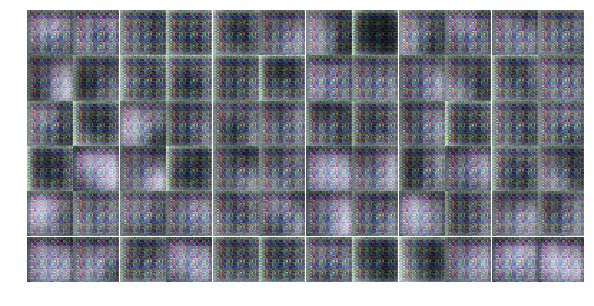

Epoch 1/25... Discriminator Loss: 0.4697... Generator Loss: 1.7813
Epoch 1/25... Discriminator Loss: 0.4379... Generator Loss: 1.4036
Epoch 1/25... Discriminator Loss: 0.5457... Generator Loss: 1.3270
Epoch 1/25... Discriminator Loss: 0.3448... Generator Loss: 2.6346
Epoch 1/25... Discriminator Loss: 0.4495... Generator Loss: 1.7110
Epoch 1/25... Discriminator Loss: 0.6970... Generator Loss: 1.0899
Epoch 1/25... Discriminator Loss: 0.1564... Generator Loss: 3.0871
Epoch 1/25... Discriminator Loss: 0.7552... Generator Loss: 1.5639
Epoch 1/25... Discriminator Loss: 0.7513... Generator Loss: 3.8876
Epoch 1/25... Discriminator Loss: 0.5002... Generator Loss: 4.1044


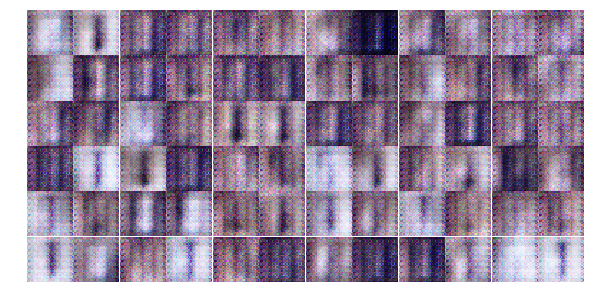

Epoch 1/25... Discriminator Loss: 0.6254... Generator Loss: 1.2280
Epoch 1/25... Discriminator Loss: 0.5236... Generator Loss: 1.6033
Epoch 1/25... Discriminator Loss: 0.3769... Generator Loss: 5.0224
Epoch 1/25... Discriminator Loss: 1.3957... Generator Loss: 1.2572
Epoch 1/25... Discriminator Loss: 0.4344... Generator Loss: 2.5677
Epoch 1/25... Discriminator Loss: 0.5879... Generator Loss: 1.2479
Epoch 1/25... Discriminator Loss: 0.1986... Generator Loss: 2.6364
Epoch 1/25... Discriminator Loss: 0.3896... Generator Loss: 3.0947
Epoch 1/25... Discriminator Loss: 0.6617... Generator Loss: 3.9860
Epoch 1/25... Discriminator Loss: 0.7919... Generator Loss: 1.2478


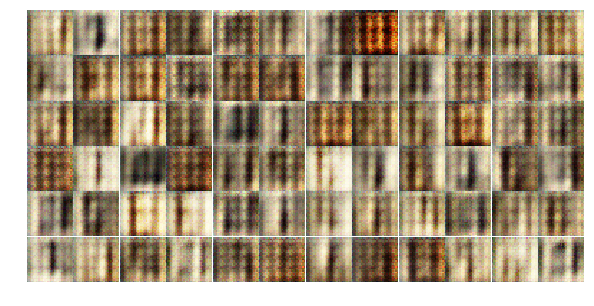

Epoch 1/25... Discriminator Loss: 0.8288... Generator Loss: 3.0680
Epoch 1/25... Discriminator Loss: 0.6919... Generator Loss: 1.7228
Epoch 1/25... Discriminator Loss: 0.3792... Generator Loss: 1.9538
Epoch 1/25... Discriminator Loss: 0.5730... Generator Loss: 1.5481
Epoch 1/25... Discriminator Loss: 0.7408... Generator Loss: 1.6444
Epoch 1/25... Discriminator Loss: 0.5172... Generator Loss: 2.0650
Epoch 1/25... Discriminator Loss: 0.4416... Generator Loss: 1.8667
Epoch 1/25... Discriminator Loss: 0.5644... Generator Loss: 2.2527
Epoch 1/25... Discriminator Loss: 0.7517... Generator Loss: 1.4460
Epoch 1/25... Discriminator Loss: 0.5885... Generator Loss: 1.8564


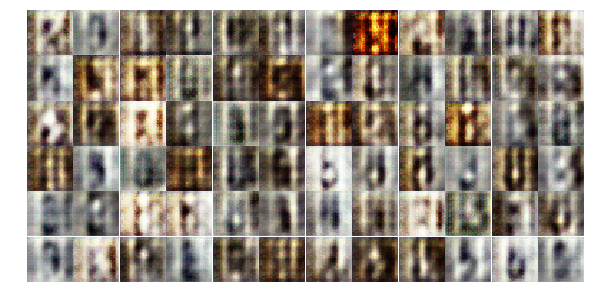

Epoch 1/25... Discriminator Loss: 0.5771... Generator Loss: 1.3528
Epoch 1/25... Discriminator Loss: 0.9348... Generator Loss: 1.4281
Epoch 1/25... Discriminator Loss: 0.9772... Generator Loss: 2.7939
Epoch 1/25... Discriminator Loss: 0.9405... Generator Loss: 2.5501
Epoch 1/25... Discriminator Loss: 0.5332... Generator Loss: 1.7502
Epoch 1/25... Discriminator Loss: 0.3186... Generator Loss: 2.2869
Epoch 1/25... Discriminator Loss: 1.0010... Generator Loss: 0.8396
Epoch 1/25... Discriminator Loss: 1.2885... Generator Loss: 0.5874
Epoch 1/25... Discriminator Loss: 0.8280... Generator Loss: 1.2280
Epoch 1/25... Discriminator Loss: 0.6509... Generator Loss: 1.7974


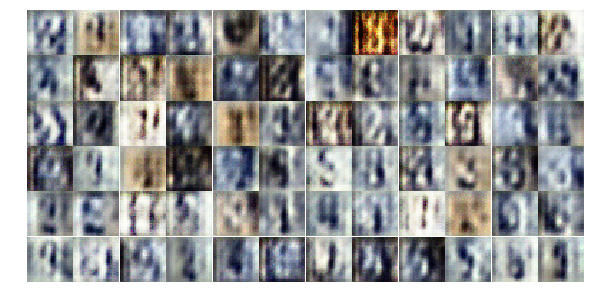

Epoch 1/25... Discriminator Loss: 0.7362... Generator Loss: 1.4923
Epoch 1/25... Discriminator Loss: 1.1925... Generator Loss: 0.6874
Epoch 1/25... Discriminator Loss: 0.8576... Generator Loss: 1.1167
Epoch 1/25... Discriminator Loss: 0.5533... Generator Loss: 1.8045
Epoch 1/25... Discriminator Loss: 0.5930... Generator Loss: 1.5680
Epoch 1/25... Discriminator Loss: 0.9453... Generator Loss: 0.8947
Epoch 1/25... Discriminator Loss: 0.7298... Generator Loss: 1.3000
Epoch 2/25... Discriminator Loss: 0.6797... Generator Loss: 1.7949
Epoch 2/25... Discriminator Loss: 0.6467... Generator Loss: 1.6866
Epoch 2/25... Discriminator Loss: 0.7311... Generator Loss: 1.2171


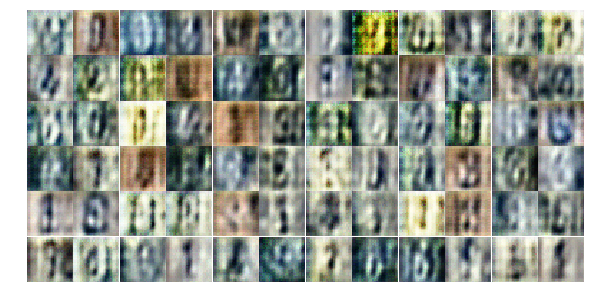

Epoch 2/25... Discriminator Loss: 0.8086... Generator Loss: 1.3380
Epoch 2/25... Discriminator Loss: 0.9586... Generator Loss: 0.9870
Epoch 2/25... Discriminator Loss: 1.1101... Generator Loss: 1.0667
Epoch 2/25... Discriminator Loss: 0.9691... Generator Loss: 1.4462
Epoch 2/25... Discriminator Loss: 0.9505... Generator Loss: 0.9180
Epoch 2/25... Discriminator Loss: 0.8684... Generator Loss: 1.0505
Epoch 2/25... Discriminator Loss: 0.9198... Generator Loss: 1.1479
Epoch 2/25... Discriminator Loss: 0.7374... Generator Loss: 1.1933
Epoch 2/25... Discriminator Loss: 0.8423... Generator Loss: 1.6388
Epoch 2/25... Discriminator Loss: 0.6672... Generator Loss: 1.1047


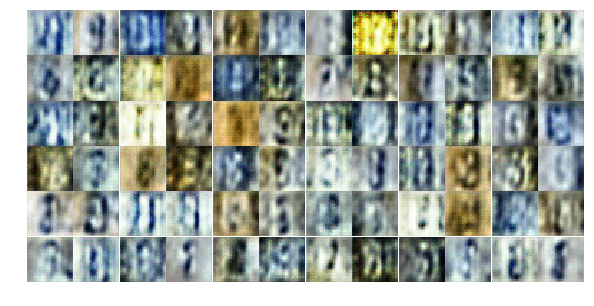

Epoch 2/25... Discriminator Loss: 0.8711... Generator Loss: 0.9234
Epoch 2/25... Discriminator Loss: 1.2128... Generator Loss: 1.9868
Epoch 2/25... Discriminator Loss: 1.1509... Generator Loss: 1.1760
Epoch 2/25... Discriminator Loss: 0.9430... Generator Loss: 0.9251
Epoch 2/25... Discriminator Loss: 1.1303... Generator Loss: 0.7851
Epoch 2/25... Discriminator Loss: 1.1470... Generator Loss: 1.0370
Epoch 2/25... Discriminator Loss: 1.4140... Generator Loss: 0.4911
Epoch 2/25... Discriminator Loss: 1.0342... Generator Loss: 0.8696
Epoch 2/25... Discriminator Loss: 1.0606... Generator Loss: 1.0220
Epoch 2/25... Discriminator Loss: 0.9131... Generator Loss: 0.8285


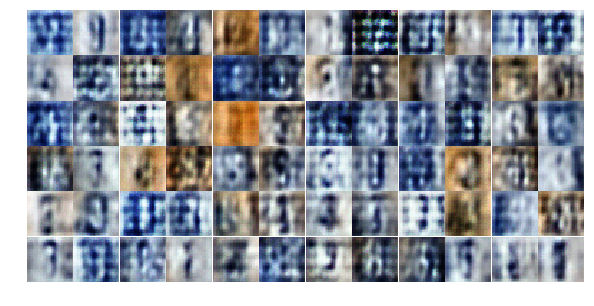

Epoch 2/25... Discriminator Loss: 0.9184... Generator Loss: 1.1046
Epoch 2/25... Discriminator Loss: 0.8649... Generator Loss: 1.1132
Epoch 2/25... Discriminator Loss: 0.7949... Generator Loss: 1.0299
Epoch 2/25... Discriminator Loss: 1.1443... Generator Loss: 1.2516
Epoch 2/25... Discriminator Loss: 1.0535... Generator Loss: 1.0467
Epoch 2/25... Discriminator Loss: 0.8783... Generator Loss: 2.0654
Epoch 2/25... Discriminator Loss: 0.8814... Generator Loss: 0.8651
Epoch 2/25... Discriminator Loss: 0.8199... Generator Loss: 1.0107
Epoch 2/25... Discriminator Loss: 1.0549... Generator Loss: 1.3586
Epoch 2/25... Discriminator Loss: 0.9790... Generator Loss: 0.7174


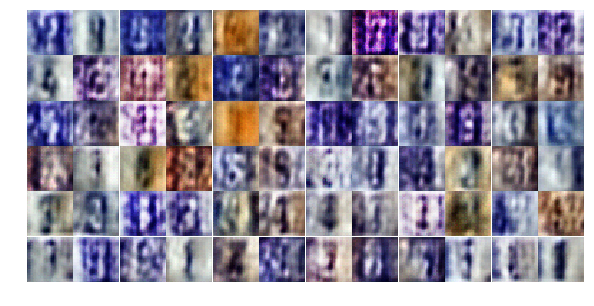

Epoch 2/25... Discriminator Loss: 1.2404... Generator Loss: 0.6973
Epoch 2/25... Discriminator Loss: 1.1063... Generator Loss: 0.8119
Epoch 2/25... Discriminator Loss: 1.2730... Generator Loss: 0.6244
Epoch 2/25... Discriminator Loss: 0.7886... Generator Loss: 0.9442
Epoch 2/25... Discriminator Loss: 0.7753... Generator Loss: 1.3922
Epoch 2/25... Discriminator Loss: 0.6155... Generator Loss: 1.5961
Epoch 2/25... Discriminator Loss: 0.9738... Generator Loss: 1.1566
Epoch 2/25... Discriminator Loss: 0.6833... Generator Loss: 1.3949
Epoch 2/25... Discriminator Loss: 1.2177... Generator Loss: 0.4894
Epoch 2/25... Discriminator Loss: 0.6277... Generator Loss: 1.4157


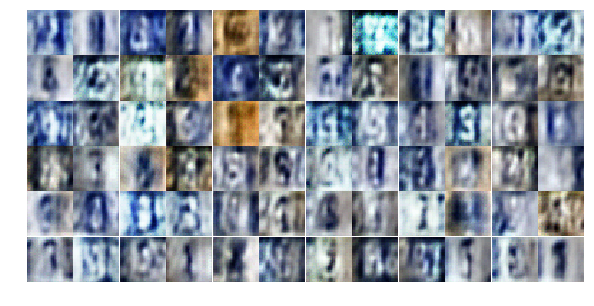

Epoch 2/25... Discriminator Loss: 0.5081... Generator Loss: 1.8054
Epoch 2/25... Discriminator Loss: 1.0418... Generator Loss: 3.1270
Epoch 2/25... Discriminator Loss: 0.9347... Generator Loss: 0.8307
Epoch 2/25... Discriminator Loss: 0.8157... Generator Loss: 1.4138
Epoch 2/25... Discriminator Loss: 0.8955... Generator Loss: 0.9349
Epoch 2/25... Discriminator Loss: 0.7760... Generator Loss: 1.0616
Epoch 2/25... Discriminator Loss: 0.4540... Generator Loss: 1.7354
Epoch 2/25... Discriminator Loss: 0.5913... Generator Loss: 1.7013
Epoch 2/25... Discriminator Loss: 0.9291... Generator Loss: 2.0479
Epoch 2/25... Discriminator Loss: 0.9231... Generator Loss: 1.4208


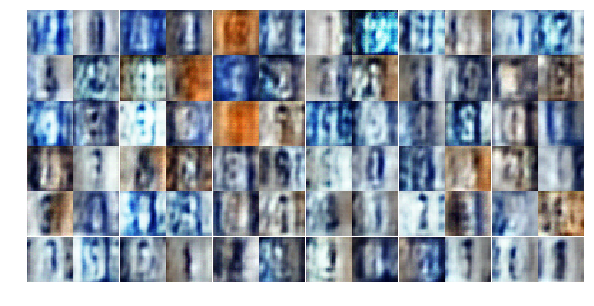

Epoch 2/25... Discriminator Loss: 0.5572... Generator Loss: 1.7614
Epoch 2/25... Discriminator Loss: 0.7683... Generator Loss: 1.1635
Epoch 2/25... Discriminator Loss: 1.6712... Generator Loss: 0.3325
Epoch 2/25... Discriminator Loss: 0.6070... Generator Loss: 1.7417
Epoch 3/25... Discriminator Loss: 0.7201... Generator Loss: 1.9280
Epoch 3/25... Discriminator Loss: 0.6317... Generator Loss: 1.9655
Epoch 3/25... Discriminator Loss: 0.6490... Generator Loss: 1.7289
Epoch 3/25... Discriminator Loss: 0.8728... Generator Loss: 0.7920
Epoch 3/25... Discriminator Loss: 0.6045... Generator Loss: 1.2944
Epoch 3/25... Discriminator Loss: 0.6434... Generator Loss: 2.2718


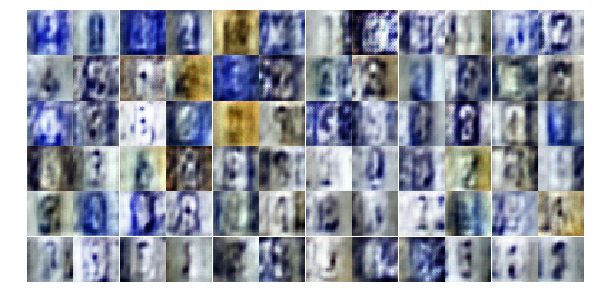

Epoch 3/25... Discriminator Loss: 0.5536... Generator Loss: 1.9365
Epoch 3/25... Discriminator Loss: 0.8634... Generator Loss: 0.7550
Epoch 3/25... Discriminator Loss: 0.4656... Generator Loss: 1.5101
Epoch 3/25... Discriminator Loss: 0.9057... Generator Loss: 0.7355
Epoch 3/25... Discriminator Loss: 0.6475... Generator Loss: 2.8931
Epoch 3/25... Discriminator Loss: 0.8320... Generator Loss: 0.9941
Epoch 3/25... Discriminator Loss: 0.5292... Generator Loss: 2.1802
Epoch 3/25... Discriminator Loss: 2.0187... Generator Loss: 0.2335
Epoch 3/25... Discriminator Loss: 0.7683... Generator Loss: 0.9441
Epoch 3/25... Discriminator Loss: 0.5188... Generator Loss: 1.7891


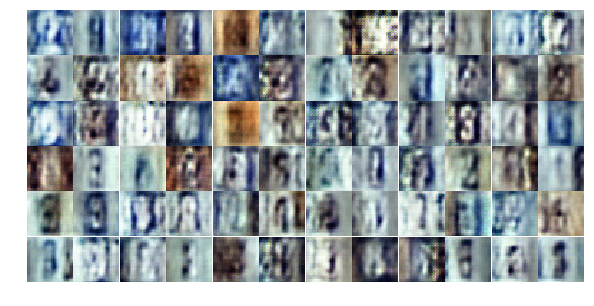

Epoch 3/25... Discriminator Loss: 0.5774... Generator Loss: 1.9110
Epoch 3/25... Discriminator Loss: 0.4737... Generator Loss: 1.5170
Epoch 3/25... Discriminator Loss: 1.1692... Generator Loss: 0.6294
Epoch 3/25... Discriminator Loss: 0.8993... Generator Loss: 1.1847
Epoch 3/25... Discriminator Loss: 0.4914... Generator Loss: 1.9424
Epoch 3/25... Discriminator Loss: 1.3025... Generator Loss: 0.4834
Epoch 3/25... Discriminator Loss: 1.4000... Generator Loss: 0.3770
Epoch 3/25... Discriminator Loss: 0.4333... Generator Loss: 1.8913
Epoch 3/25... Discriminator Loss: 0.5798... Generator Loss: 1.1728
Epoch 3/25... Discriminator Loss: 0.9035... Generator Loss: 0.8715


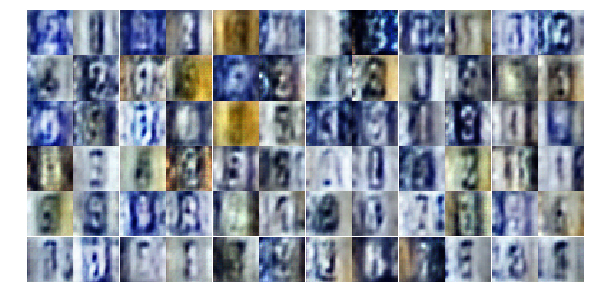

Epoch 3/25... Discriminator Loss: 0.4680... Generator Loss: 1.6295
Epoch 3/25... Discriminator Loss: 0.5425... Generator Loss: 1.5047
Epoch 3/25... Discriminator Loss: 0.8208... Generator Loss: 0.8035
Epoch 3/25... Discriminator Loss: 1.0077... Generator Loss: 1.4338
Epoch 3/25... Discriminator Loss: 0.6215... Generator Loss: 1.5009
Epoch 3/25... Discriminator Loss: 0.3380... Generator Loss: 2.0274
Epoch 3/25... Discriminator Loss: 0.8183... Generator Loss: 0.9703
Epoch 3/25... Discriminator Loss: 0.3226... Generator Loss: 3.1874
Epoch 3/25... Discriminator Loss: 0.7001... Generator Loss: 1.0789
Epoch 3/25... Discriminator Loss: 0.8571... Generator Loss: 1.1163


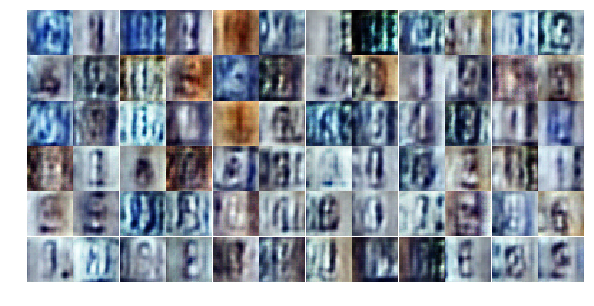

Epoch 3/25... Discriminator Loss: 1.0541... Generator Loss: 2.7474
Epoch 3/25... Discriminator Loss: 0.3796... Generator Loss: 1.8482
Epoch 3/25... Discriminator Loss: 0.5533... Generator Loss: 1.9862
Epoch 3/25... Discriminator Loss: 0.9294... Generator Loss: 0.8009
Epoch 3/25... Discriminator Loss: 0.3813... Generator Loss: 2.6126
Epoch 3/25... Discriminator Loss: 0.5586... Generator Loss: 1.6164
Epoch 3/25... Discriminator Loss: 0.7581... Generator Loss: 3.6212
Epoch 3/25... Discriminator Loss: 0.5616... Generator Loss: 1.5408
Epoch 3/25... Discriminator Loss: 0.6604... Generator Loss: 1.6160
Epoch 3/25... Discriminator Loss: 0.7718... Generator Loss: 1.1478


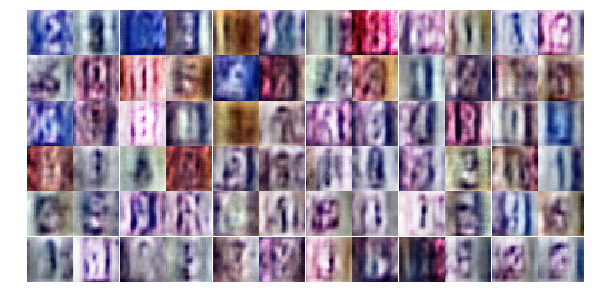

Epoch 3/25... Discriminator Loss: 0.7032... Generator Loss: 1.8317
Epoch 3/25... Discriminator Loss: 0.7054... Generator Loss: 1.1064
Epoch 3/25... Discriminator Loss: 0.5649... Generator Loss: 1.5739
Epoch 3/25... Discriminator Loss: 0.6664... Generator Loss: 1.5424
Epoch 3/25... Discriminator Loss: 0.8120... Generator Loss: 2.5480
Epoch 3/25... Discriminator Loss: 0.3321... Generator Loss: 2.9015
Epoch 3/25... Discriminator Loss: 0.4872... Generator Loss: 1.8915
Epoch 3/25... Discriminator Loss: 0.5685... Generator Loss: 1.1550
Epoch 3/25... Discriminator Loss: 0.3732... Generator Loss: 1.8938
Epoch 3/25... Discriminator Loss: 0.9644... Generator Loss: 1.0006


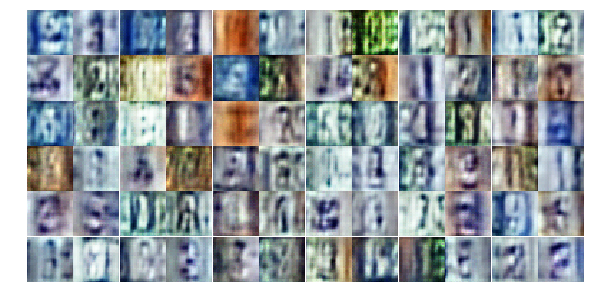

Epoch 3/25... Discriminator Loss: 0.5563... Generator Loss: 1.7567
Epoch 4/25... Discriminator Loss: 1.0904... Generator Loss: 0.6215
Epoch 4/25... Discriminator Loss: 1.4449... Generator Loss: 3.9678
Epoch 4/25... Discriminator Loss: 0.9243... Generator Loss: 0.9394
Epoch 4/25... Discriminator Loss: 0.5043... Generator Loss: 1.8104
Epoch 4/25... Discriminator Loss: 0.6412... Generator Loss: 1.4052
Epoch 4/25... Discriminator Loss: 0.5970... Generator Loss: 1.5033
Epoch 4/25... Discriminator Loss: 0.7336... Generator Loss: 1.1472
Epoch 4/25... Discriminator Loss: 0.9822... Generator Loss: 2.7919
Epoch 4/25... Discriminator Loss: 0.8358... Generator Loss: 0.8038


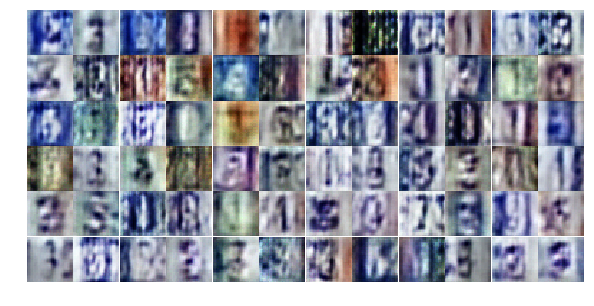

Epoch 4/25... Discriminator Loss: 0.5988... Generator Loss: 1.2579
Epoch 4/25... Discriminator Loss: 0.9956... Generator Loss: 0.6822
Epoch 4/25... Discriminator Loss: 0.8866... Generator Loss: 1.0396
Epoch 4/25... Discriminator Loss: 0.6278... Generator Loss: 1.1731
Epoch 4/25... Discriminator Loss: 0.7455... Generator Loss: 1.0167
Epoch 4/25... Discriminator Loss: 1.2929... Generator Loss: 0.4227
Epoch 4/25... Discriminator Loss: 1.4716... Generator Loss: 0.3695
Epoch 4/25... Discriminator Loss: 0.3570... Generator Loss: 1.8834
Epoch 4/25... Discriminator Loss: 0.5728... Generator Loss: 1.7269
Epoch 4/25... Discriminator Loss: 0.4647... Generator Loss: 1.8080


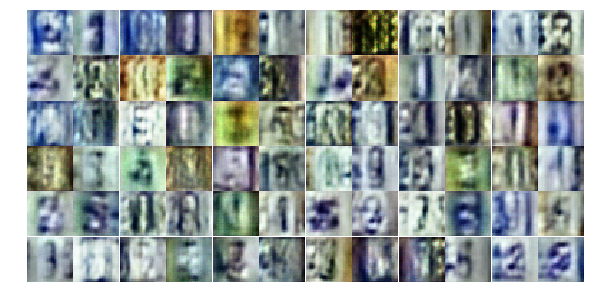

Epoch 4/25... Discriminator Loss: 0.5767... Generator Loss: 1.1966
Epoch 4/25... Discriminator Loss: 0.5044... Generator Loss: 1.5352
Epoch 4/25... Discriminator Loss: 0.5306... Generator Loss: 1.2980
Epoch 4/25... Discriminator Loss: 0.8185... Generator Loss: 0.8445
Epoch 4/25... Discriminator Loss: 0.3084... Generator Loss: 1.9936
Epoch 4/25... Discriminator Loss: 1.2474... Generator Loss: 4.4075
Epoch 4/25... Discriminator Loss: 1.0320... Generator Loss: 0.6109
Epoch 4/25... Discriminator Loss: 0.8662... Generator Loss: 0.8285
Epoch 4/25... Discriminator Loss: 0.7936... Generator Loss: 0.9574
Epoch 4/25... Discriminator Loss: 0.5437... Generator Loss: 1.1774


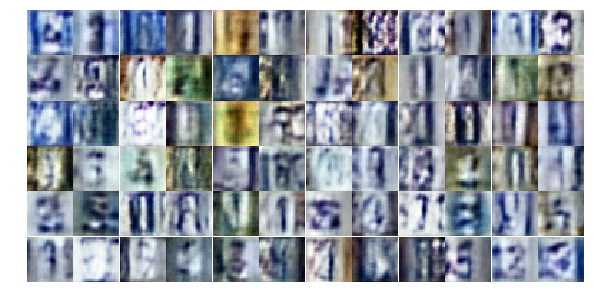

Epoch 4/25... Discriminator Loss: 0.4886... Generator Loss: 1.3819
Epoch 4/25... Discriminator Loss: 0.7193... Generator Loss: 1.0839
Epoch 4/25... Discriminator Loss: 0.6387... Generator Loss: 1.7673
Epoch 4/25... Discriminator Loss: 0.4898... Generator Loss: 2.2394
Epoch 4/25... Discriminator Loss: 0.3887... Generator Loss: 2.2832
Epoch 4/25... Discriminator Loss: 0.3676... Generator Loss: 1.9131
Epoch 4/25... Discriminator Loss: 0.4462... Generator Loss: 1.5416
Epoch 4/25... Discriminator Loss: 0.6191... Generator Loss: 2.8821
Epoch 4/25... Discriminator Loss: 0.6394... Generator Loss: 1.5483
Epoch 4/25... Discriminator Loss: 0.5142... Generator Loss: 1.3600


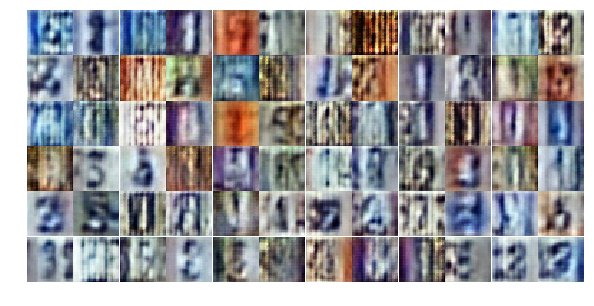

Epoch 4/25... Discriminator Loss: 0.8619... Generator Loss: 0.7941
Epoch 4/25... Discriminator Loss: 0.4211... Generator Loss: 2.0107
Epoch 4/25... Discriminator Loss: 0.5819... Generator Loss: 1.1651
Epoch 4/25... Discriminator Loss: 0.3035... Generator Loss: 2.0828
Epoch 4/25... Discriminator Loss: 0.2517... Generator Loss: 2.8292
Epoch 4/25... Discriminator Loss: 0.7086... Generator Loss: 2.0006
Epoch 4/25... Discriminator Loss: 0.9213... Generator Loss: 0.7250
Epoch 4/25... Discriminator Loss: 0.6890... Generator Loss: 1.1043
Epoch 4/25... Discriminator Loss: 0.6899... Generator Loss: 1.0069
Epoch 4/25... Discriminator Loss: 0.3442... Generator Loss: 1.7704


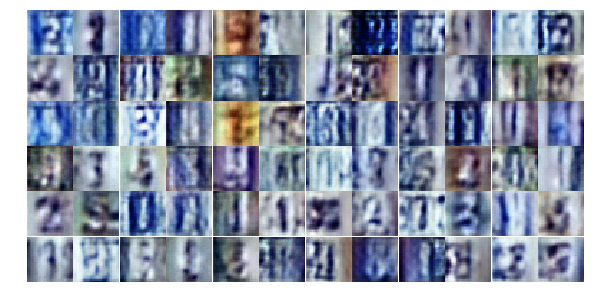

Epoch 4/25... Discriminator Loss: 0.4229... Generator Loss: 1.8965
Epoch 4/25... Discriminator Loss: 0.3650... Generator Loss: 1.7961
Epoch 4/25... Discriminator Loss: 0.3369... Generator Loss: 1.9210
Epoch 4/25... Discriminator Loss: 0.6274... Generator Loss: 1.6815
Epoch 4/25... Discriminator Loss: 0.4979... Generator Loss: 1.3715
Epoch 4/25... Discriminator Loss: 0.4320... Generator Loss: 1.6197
Epoch 4/25... Discriminator Loss: 0.3486... Generator Loss: 1.9798
Epoch 4/25... Discriminator Loss: 1.2567... Generator Loss: 0.4464
Epoch 4/25... Discriminator Loss: 0.6742... Generator Loss: 2.2859
Epoch 5/25... Discriminator Loss: 0.6500... Generator Loss: 1.8801


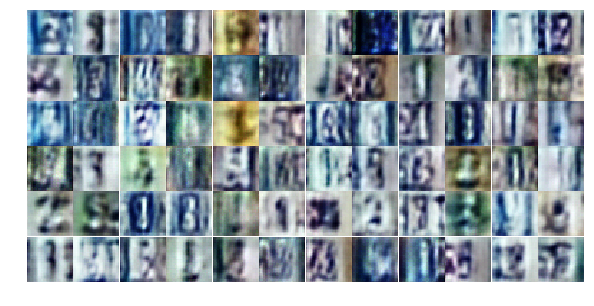

Epoch 5/25... Discriminator Loss: 0.2421... Generator Loss: 2.4668
Epoch 5/25... Discriminator Loss: 0.2453... Generator Loss: 2.3364
Epoch 5/25... Discriminator Loss: 0.7357... Generator Loss: 0.8979
Epoch 5/25... Discriminator Loss: 0.4214... Generator Loss: 1.5372
Epoch 5/25... Discriminator Loss: 0.4964... Generator Loss: 2.7105
Epoch 5/25... Discriminator Loss: 0.7719... Generator Loss: 1.0560
Epoch 5/25... Discriminator Loss: 0.3185... Generator Loss: 2.2527
Epoch 5/25... Discriminator Loss: 0.2410... Generator Loss: 2.1882
Epoch 5/25... Discriminator Loss: 0.5173... Generator Loss: 1.7775
Epoch 5/25... Discriminator Loss: 0.9405... Generator Loss: 2.3739


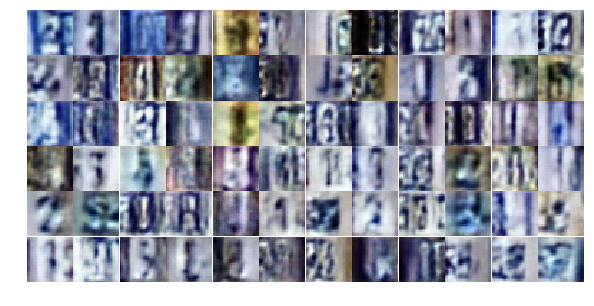

Epoch 5/25... Discriminator Loss: 0.5044... Generator Loss: 1.8806
Epoch 5/25... Discriminator Loss: 0.6493... Generator Loss: 2.4361
Epoch 5/25... Discriminator Loss: 0.4281... Generator Loss: 1.8960
Epoch 5/25... Discriminator Loss: 0.5305... Generator Loss: 1.2688
Epoch 5/25... Discriminator Loss: 0.4946... Generator Loss: 1.4045
Epoch 5/25... Discriminator Loss: 0.6697... Generator Loss: 0.9119
Epoch 5/25... Discriminator Loss: 0.4097... Generator Loss: 1.6537
Epoch 5/25... Discriminator Loss: 1.0764... Generator Loss: 0.7427
Epoch 5/25... Discriminator Loss: 0.3302... Generator Loss: 2.4172
Epoch 5/25... Discriminator Loss: 1.1542... Generator Loss: 0.5465


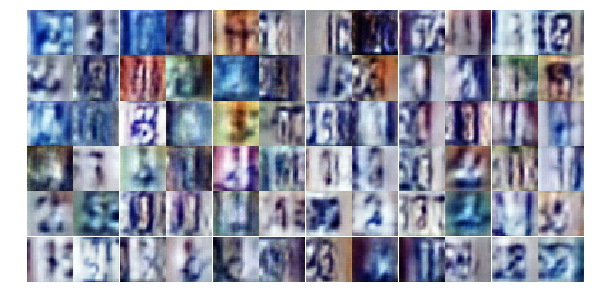

Epoch 5/25... Discriminator Loss: 0.3925... Generator Loss: 1.8874
Epoch 5/25... Discriminator Loss: 0.4176... Generator Loss: 1.6525
Epoch 5/25... Discriminator Loss: 0.4592... Generator Loss: 1.4633
Epoch 5/25... Discriminator Loss: 0.3872... Generator Loss: 1.6978
Epoch 5/25... Discriminator Loss: 1.0777... Generator Loss: 0.6404
Epoch 5/25... Discriminator Loss: 0.7047... Generator Loss: 1.2631
Epoch 5/25... Discriminator Loss: 1.7035... Generator Loss: 0.3066
Epoch 5/25... Discriminator Loss: 0.5330... Generator Loss: 1.8337
Epoch 5/25... Discriminator Loss: 0.5867... Generator Loss: 1.3004
Epoch 5/25... Discriminator Loss: 0.3411... Generator Loss: 1.9072


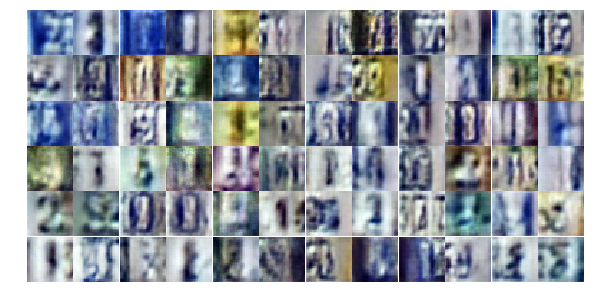

Epoch 5/25... Discriminator Loss: 0.4945... Generator Loss: 1.6122
Epoch 5/25... Discriminator Loss: 0.4684... Generator Loss: 1.5008
Epoch 5/25... Discriminator Loss: 0.4719... Generator Loss: 1.5768
Epoch 5/25... Discriminator Loss: 0.4351... Generator Loss: 1.9737
Epoch 5/25... Discriminator Loss: 0.9856... Generator Loss: 0.6222
Epoch 5/25... Discriminator Loss: 0.4727... Generator Loss: 2.3401
Epoch 5/25... Discriminator Loss: 0.5360... Generator Loss: 1.3305
Epoch 5/25... Discriminator Loss: 0.4636... Generator Loss: 1.4804
Epoch 5/25... Discriminator Loss: 0.5729... Generator Loss: 1.2077
Epoch 5/25... Discriminator Loss: 0.3727... Generator Loss: 1.6784


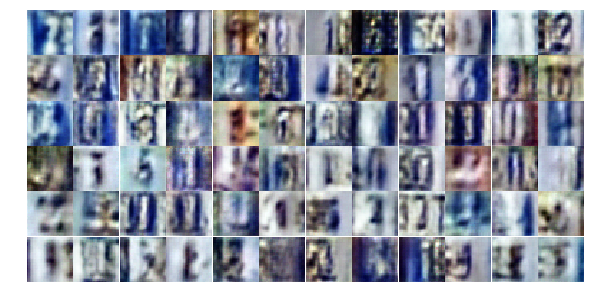

Epoch 5/25... Discriminator Loss: 0.3052... Generator Loss: 2.0616
Epoch 5/25... Discriminator Loss: 0.5059... Generator Loss: 1.1932
Epoch 5/25... Discriminator Loss: 1.8690... Generator Loss: 0.2612
Epoch 5/25... Discriminator Loss: 0.4750... Generator Loss: 1.7931
Epoch 5/25... Discriminator Loss: 0.7952... Generator Loss: 1.3138
Epoch 5/25... Discriminator Loss: 1.2878... Generator Loss: 0.5274
Epoch 5/25... Discriminator Loss: 0.8956... Generator Loss: 0.7552
Epoch 5/25... Discriminator Loss: 0.4459... Generator Loss: 1.5943
Epoch 5/25... Discriminator Loss: 0.7304... Generator Loss: 0.8857
Epoch 5/25... Discriminator Loss: 0.3891... Generator Loss: 1.9783


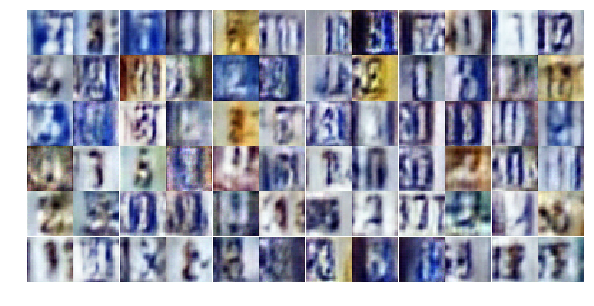

Epoch 5/25... Discriminator Loss: 0.6853... Generator Loss: 0.9639
Epoch 5/25... Discriminator Loss: 0.4913... Generator Loss: 1.3893
Epoch 5/25... Discriminator Loss: 0.6408... Generator Loss: 1.0988
Epoch 5/25... Discriminator Loss: 0.4210... Generator Loss: 1.4882
Epoch 5/25... Discriminator Loss: 0.4355... Generator Loss: 1.4507
Epoch 5/25... Discriminator Loss: 1.1135... Generator Loss: 0.5738
Epoch 6/25... Discriminator Loss: 0.8758... Generator Loss: 0.7704
Epoch 6/25... Discriminator Loss: 0.4058... Generator Loss: 1.8146
Epoch 6/25... Discriminator Loss: 0.5404... Generator Loss: 1.3704
Epoch 6/25... Discriminator Loss: 0.5597... Generator Loss: 1.4136


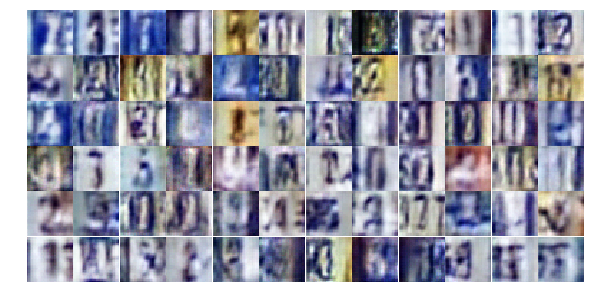

Epoch 6/25... Discriminator Loss: 0.6409... Generator Loss: 1.0057
Epoch 6/25... Discriminator Loss: 1.2747... Generator Loss: 0.5678
Epoch 6/25... Discriminator Loss: 0.6955... Generator Loss: 1.2794
Epoch 6/25... Discriminator Loss: 0.5916... Generator Loss: 1.3901
Epoch 6/25... Discriminator Loss: 0.7200... Generator Loss: 0.9555
Epoch 6/25... Discriminator Loss: 0.4674... Generator Loss: 1.2624
Epoch 6/25... Discriminator Loss: 0.3253... Generator Loss: 1.8440
Epoch 6/25... Discriminator Loss: 0.7279... Generator Loss: 0.9556
Epoch 6/25... Discriminator Loss: 0.5629... Generator Loss: 1.1676
Epoch 6/25... Discriminator Loss: 2.7933... Generator Loss: 0.0914


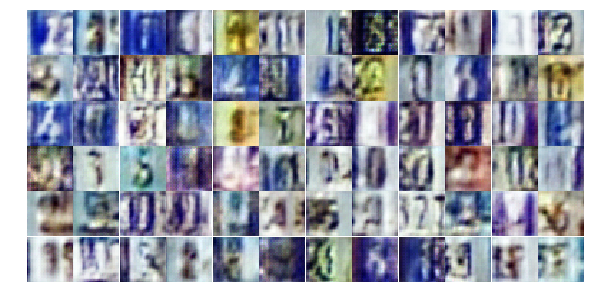

Epoch 6/25... Discriminator Loss: 0.5173... Generator Loss: 1.5453
Epoch 6/25... Discriminator Loss: 0.9187... Generator Loss: 0.8055
Epoch 6/25... Discriminator Loss: 1.1232... Generator Loss: 0.5326
Epoch 6/25... Discriminator Loss: 1.7537... Generator Loss: 0.2709
Epoch 6/25... Discriminator Loss: 0.5252... Generator Loss: 1.7557
Epoch 6/25... Discriminator Loss: 0.5507... Generator Loss: 1.4703
Epoch 6/25... Discriminator Loss: 0.5129... Generator Loss: 1.3608
Epoch 6/25... Discriminator Loss: 0.6249... Generator Loss: 1.0730
Epoch 6/25... Discriminator Loss: 1.2350... Generator Loss: 3.2812
Epoch 6/25... Discriminator Loss: 0.7627... Generator Loss: 0.9982


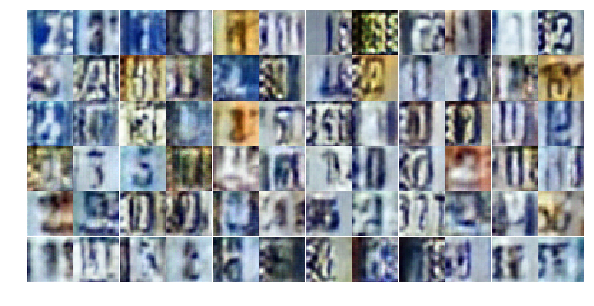

Epoch 6/25... Discriminator Loss: 0.6963... Generator Loss: 1.0016
Epoch 6/25... Discriminator Loss: 0.5559... Generator Loss: 1.2790
Epoch 6/25... Discriminator Loss: 0.7981... Generator Loss: 0.8364
Epoch 6/25... Discriminator Loss: 0.4458... Generator Loss: 1.5581
Epoch 6/25... Discriminator Loss: 0.3718... Generator Loss: 1.6974
Epoch 6/25... Discriminator Loss: 1.0099... Generator Loss: 1.7139
Epoch 6/25... Discriminator Loss: 0.8983... Generator Loss: 2.7024
Epoch 6/25... Discriminator Loss: 0.3571... Generator Loss: 1.6949
Epoch 6/25... Discriminator Loss: 0.6295... Generator Loss: 1.1733
Epoch 6/25... Discriminator Loss: 0.4709... Generator Loss: 2.3438


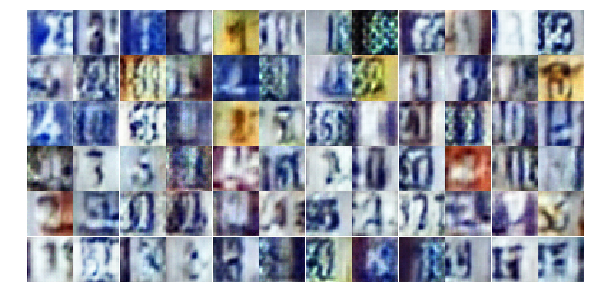

Epoch 6/25... Discriminator Loss: 0.7418... Generator Loss: 0.9633
Epoch 6/25... Discriminator Loss: 0.6865... Generator Loss: 1.6116
Epoch 6/25... Discriminator Loss: 1.2203... Generator Loss: 0.5224
Epoch 6/25... Discriminator Loss: 0.7831... Generator Loss: 0.8286
Epoch 6/25... Discriminator Loss: 0.9617... Generator Loss: 0.6570
Epoch 6/25... Discriminator Loss: 0.8455... Generator Loss: 1.3812
Epoch 6/25... Discriminator Loss: 0.5501... Generator Loss: 1.2819
Epoch 6/25... Discriminator Loss: 0.5035... Generator Loss: 1.9288
Epoch 6/25... Discriminator Loss: 0.8310... Generator Loss: 0.7754
Epoch 6/25... Discriminator Loss: 0.6193... Generator Loss: 1.1284


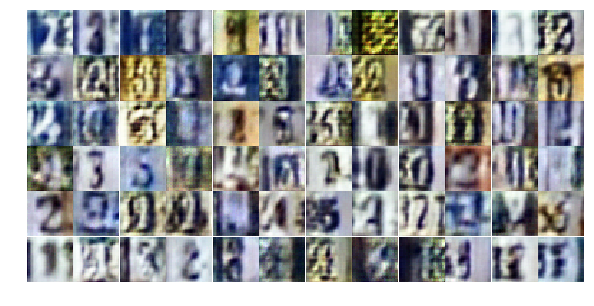

Epoch 6/25... Discriminator Loss: 0.6744... Generator Loss: 2.3751
Epoch 6/25... Discriminator Loss: 0.7432... Generator Loss: 0.9716
Epoch 6/25... Discriminator Loss: 0.7201... Generator Loss: 1.2358
Epoch 6/25... Discriminator Loss: 0.5500... Generator Loss: 1.2872
Epoch 6/25... Discriminator Loss: 0.5677... Generator Loss: 1.2131
Epoch 6/25... Discriminator Loss: 0.3172... Generator Loss: 2.0340
Epoch 6/25... Discriminator Loss: 0.8280... Generator Loss: 0.8288
Epoch 6/25... Discriminator Loss: 1.7549... Generator Loss: 0.3194
Epoch 6/25... Discriminator Loss: 1.1321... Generator Loss: 0.5449
Epoch 6/25... Discriminator Loss: 1.9472... Generator Loss: 0.2146


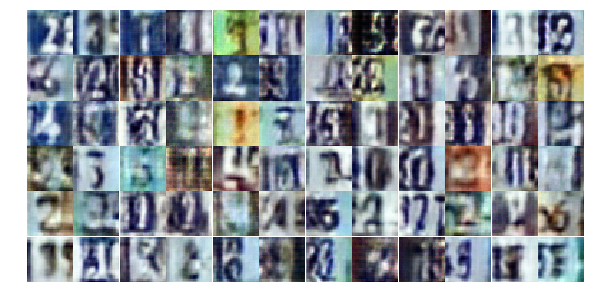

Epoch 6/25... Discriminator Loss: 0.6574... Generator Loss: 1.0748
Epoch 6/25... Discriminator Loss: 0.9730... Generator Loss: 0.6339
Epoch 6/25... Discriminator Loss: 0.7684... Generator Loss: 0.9050
Epoch 7/25... Discriminator Loss: 0.6071... Generator Loss: 1.9132
Epoch 7/25... Discriminator Loss: 0.5588... Generator Loss: 1.1740
Epoch 7/25... Discriminator Loss: 0.3966... Generator Loss: 1.7951
Epoch 7/25... Discriminator Loss: 0.9650... Generator Loss: 0.8093
Epoch 7/25... Discriminator Loss: 0.8904... Generator Loss: 2.6341
Epoch 7/25... Discriminator Loss: 0.7125... Generator Loss: 2.3214
Epoch 7/25... Discriminator Loss: 0.8619... Generator Loss: 1.7413


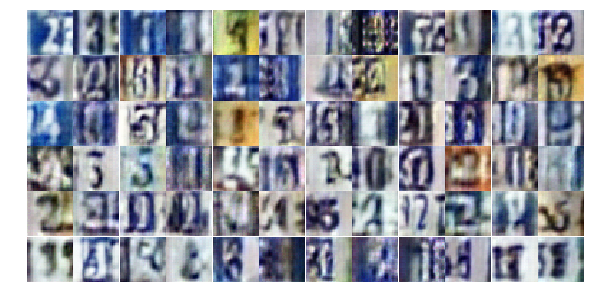

Epoch 7/25... Discriminator Loss: 0.5352... Generator Loss: 1.4916
Epoch 7/25... Discriminator Loss: 0.6919... Generator Loss: 1.0785
Epoch 7/25... Discriminator Loss: 0.9978... Generator Loss: 0.6105
Epoch 7/25... Discriminator Loss: 1.2818... Generator Loss: 2.8157
Epoch 7/25... Discriminator Loss: 0.5256... Generator Loss: 1.6017
Epoch 7/25... Discriminator Loss: 0.4879... Generator Loss: 1.4303
Epoch 7/25... Discriminator Loss: 0.6061... Generator Loss: 1.5312
Epoch 7/25... Discriminator Loss: 1.0714... Generator Loss: 2.5723
Epoch 7/25... Discriminator Loss: 0.8536... Generator Loss: 1.0352
Epoch 7/25... Discriminator Loss: 1.3925... Generator Loss: 0.4033


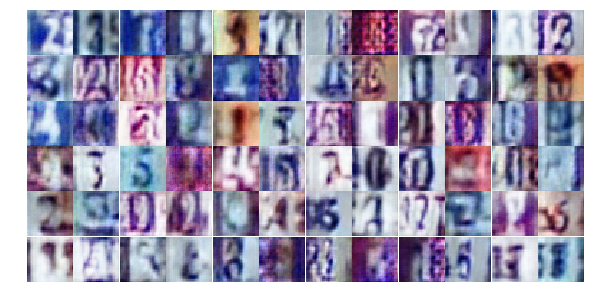

Epoch 7/25... Discriminator Loss: 1.0177... Generator Loss: 0.6486
Epoch 7/25... Discriminator Loss: 0.4455... Generator Loss: 1.7361
Epoch 7/25... Discriminator Loss: 0.5551... Generator Loss: 1.5150
Epoch 7/25... Discriminator Loss: 0.5517... Generator Loss: 1.4726
Epoch 7/25... Discriminator Loss: 0.4965... Generator Loss: 1.4749
Epoch 7/25... Discriminator Loss: 0.4907... Generator Loss: 1.3104
Epoch 7/25... Discriminator Loss: 0.4662... Generator Loss: 1.8296
Epoch 7/25... Discriminator Loss: 1.5310... Generator Loss: 0.3261
Epoch 7/25... Discriminator Loss: 0.3296... Generator Loss: 1.8968
Epoch 7/25... Discriminator Loss: 0.5558... Generator Loss: 1.6951


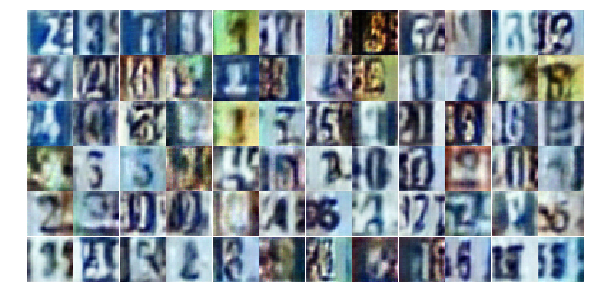

Epoch 7/25... Discriminator Loss: 1.1654... Generator Loss: 0.5237
Epoch 7/25... Discriminator Loss: 0.8842... Generator Loss: 0.7075
Epoch 7/25... Discriminator Loss: 0.6621... Generator Loss: 1.0593
Epoch 7/25... Discriminator Loss: 0.6172... Generator Loss: 1.0535
Epoch 7/25... Discriminator Loss: 0.6625... Generator Loss: 0.9713
Epoch 7/25... Discriminator Loss: 0.8621... Generator Loss: 0.7944
Epoch 7/25... Discriminator Loss: 0.4818... Generator Loss: 1.3667
Epoch 7/25... Discriminator Loss: 0.6677... Generator Loss: 1.1175
Epoch 7/25... Discriminator Loss: 0.8757... Generator Loss: 0.7389
Epoch 7/25... Discriminator Loss: 1.0129... Generator Loss: 3.0762


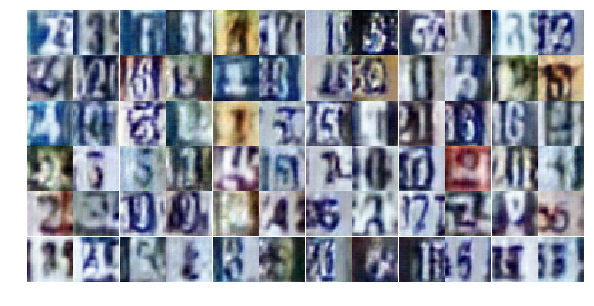

Epoch 7/25... Discriminator Loss: 0.8551... Generator Loss: 1.9765
Epoch 7/25... Discriminator Loss: 0.4273... Generator Loss: 1.8159
Epoch 7/25... Discriminator Loss: 0.5412... Generator Loss: 1.7079
Epoch 7/25... Discriminator Loss: 0.5674... Generator Loss: 1.3776
Epoch 7/25... Discriminator Loss: 0.9627... Generator Loss: 0.6130
Epoch 7/25... Discriminator Loss: 0.4361... Generator Loss: 1.5398
Epoch 7/25... Discriminator Loss: 0.2942... Generator Loss: 2.0836
Epoch 7/25... Discriminator Loss: 1.9634... Generator Loss: 0.2409
Epoch 7/25... Discriminator Loss: 0.4424... Generator Loss: 1.4607
Epoch 7/25... Discriminator Loss: 0.6733... Generator Loss: 1.2494


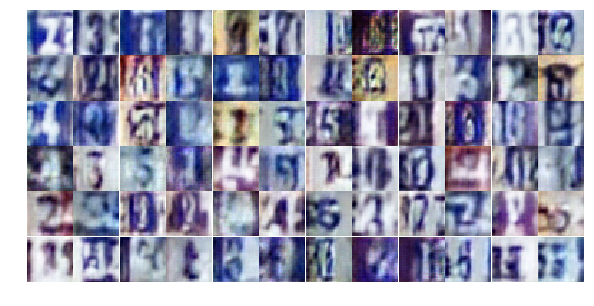

Epoch 7/25... Discriminator Loss: 0.4097... Generator Loss: 1.8342
Epoch 7/25... Discriminator Loss: 0.5924... Generator Loss: 1.2388
Epoch 7/25... Discriminator Loss: 0.8561... Generator Loss: 0.8111
Epoch 7/25... Discriminator Loss: 0.4832... Generator Loss: 1.3298
Epoch 7/25... Discriminator Loss: 0.5692... Generator Loss: 1.1045
Epoch 7/25... Discriminator Loss: 0.7844... Generator Loss: 0.8903
Epoch 7/25... Discriminator Loss: 1.8285... Generator Loss: 0.2747
Epoch 7/25... Discriminator Loss: 0.6693... Generator Loss: 1.7433
Epoch 7/25... Discriminator Loss: 0.7345... Generator Loss: 0.9477
Epoch 7/25... Discriminator Loss: 0.5190... Generator Loss: 1.2402


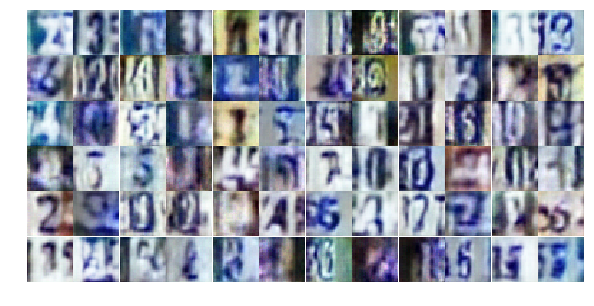

Epoch 7/25... Discriminator Loss: 0.5852... Generator Loss: 1.9827
Epoch 8/25... Discriminator Loss: 0.9720... Generator Loss: 0.6277
Epoch 8/25... Discriminator Loss: 0.7632... Generator Loss: 0.8808
Epoch 8/25... Discriminator Loss: 0.6573... Generator Loss: 0.9708
Epoch 8/25... Discriminator Loss: 0.6773... Generator Loss: 1.6844
Epoch 8/25... Discriminator Loss: 0.9055... Generator Loss: 1.0402
Epoch 8/25... Discriminator Loss: 1.4282... Generator Loss: 0.3554
Epoch 8/25... Discriminator Loss: 0.4770... Generator Loss: 1.3927
Epoch 8/25... Discriminator Loss: 0.7470... Generator Loss: 1.0524
Epoch 8/25... Discriminator Loss: 0.7367... Generator Loss: 0.9345


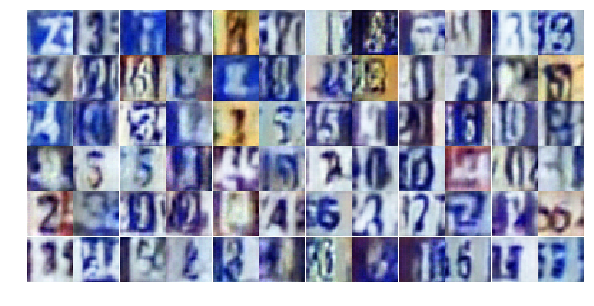

Epoch 8/25... Discriminator Loss: 0.4280... Generator Loss: 1.7707
Epoch 8/25... Discriminator Loss: 0.4204... Generator Loss: 1.9895
Epoch 8/25... Discriminator Loss: 0.8242... Generator Loss: 0.8136
Epoch 8/25... Discriminator Loss: 0.5828... Generator Loss: 2.4941
Epoch 8/25... Discriminator Loss: 1.7165... Generator Loss: 0.4528
Epoch 8/25... Discriminator Loss: 0.5099... Generator Loss: 2.6480
Epoch 8/25... Discriminator Loss: 0.5095... Generator Loss: 1.6523
Epoch 8/25... Discriminator Loss: 0.7934... Generator Loss: 0.9815
Epoch 8/25... Discriminator Loss: 0.7289... Generator Loss: 0.9292
Epoch 8/25... Discriminator Loss: 1.3610... Generator Loss: 0.4356


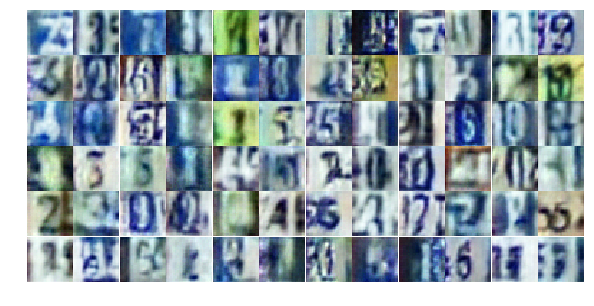

Epoch 8/25... Discriminator Loss: 0.5506... Generator Loss: 1.3766
Epoch 8/25... Discriminator Loss: 0.6212... Generator Loss: 1.0479
Epoch 8/25... Discriminator Loss: 0.7882... Generator Loss: 0.8833
Epoch 8/25... Discriminator Loss: 0.7700... Generator Loss: 1.5846
Epoch 8/25... Discriminator Loss: 0.3842... Generator Loss: 1.7314
Epoch 8/25... Discriminator Loss: 0.7433... Generator Loss: 0.9498
Epoch 8/25... Discriminator Loss: 0.7689... Generator Loss: 1.2766
Epoch 8/25... Discriminator Loss: 0.4915... Generator Loss: 1.4018
Epoch 8/25... Discriminator Loss: 0.6404... Generator Loss: 2.2099
Epoch 8/25... Discriminator Loss: 0.7770... Generator Loss: 0.8961


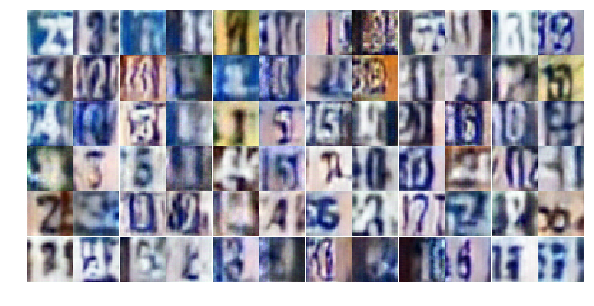

Epoch 8/25... Discriminator Loss: 0.4411... Generator Loss: 1.5822
Epoch 8/25... Discriminator Loss: 1.2805... Generator Loss: 0.4091
Epoch 8/25... Discriminator Loss: 1.0954... Generator Loss: 0.6117
Epoch 8/25... Discriminator Loss: 0.6499... Generator Loss: 1.0508
Epoch 8/25... Discriminator Loss: 0.9727... Generator Loss: 0.6251
Epoch 8/25... Discriminator Loss: 0.4216... Generator Loss: 1.4742
Epoch 8/25... Discriminator Loss: 0.9077... Generator Loss: 0.6836
Epoch 8/25... Discriminator Loss: 0.5601... Generator Loss: 1.4447
Epoch 8/25... Discriminator Loss: 0.5894... Generator Loss: 1.3345
Epoch 8/25... Discriminator Loss: 0.4655... Generator Loss: 1.7853


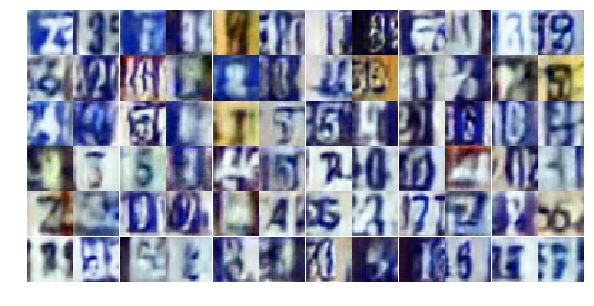

Epoch 8/25... Discriminator Loss: 0.4454... Generator Loss: 1.4537
Epoch 8/25... Discriminator Loss: 1.2525... Generator Loss: 0.4583
Epoch 8/25... Discriminator Loss: 1.0130... Generator Loss: 0.5916
Epoch 8/25... Discriminator Loss: 0.5258... Generator Loss: 1.3895
Epoch 8/25... Discriminator Loss: 1.9692... Generator Loss: 3.6340
Epoch 8/25... Discriminator Loss: 0.6619... Generator Loss: 1.3528
Epoch 8/25... Discriminator Loss: 0.5680... Generator Loss: 1.6454
Epoch 8/25... Discriminator Loss: 0.4759... Generator Loss: 1.5492
Epoch 8/25... Discriminator Loss: 0.5047... Generator Loss: 1.8609
Epoch 8/25... Discriminator Loss: 0.6804... Generator Loss: 1.0580


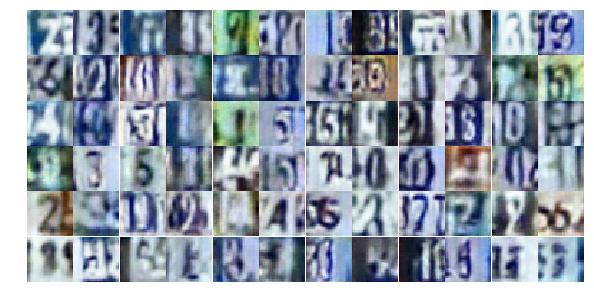

Epoch 8/25... Discriminator Loss: 0.4297... Generator Loss: 1.5712
Epoch 8/25... Discriminator Loss: 0.7617... Generator Loss: 0.8896
Epoch 8/25... Discriminator Loss: 0.3624... Generator Loss: 1.7261
Epoch 8/25... Discriminator Loss: 1.1216... Generator Loss: 0.6201
Epoch 8/25... Discriminator Loss: 0.4503... Generator Loss: 1.9686
Epoch 8/25... Discriminator Loss: 0.8793... Generator Loss: 0.7999
Epoch 8/25... Discriminator Loss: 0.7708... Generator Loss: 0.9012
Epoch 8/25... Discriminator Loss: 0.4885... Generator Loss: 1.4803
Epoch 9/25... Discriminator Loss: 0.7453... Generator Loss: 0.8895
Epoch 9/25... Discriminator Loss: 0.9572... Generator Loss: 0.6101


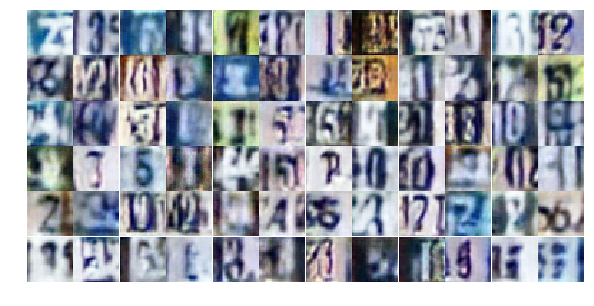

Epoch 9/25... Discriminator Loss: 0.6313... Generator Loss: 1.1134
Epoch 9/25... Discriminator Loss: 0.5906... Generator Loss: 1.6694
Epoch 9/25... Discriminator Loss: 1.2428... Generator Loss: 0.4718
Epoch 9/25... Discriminator Loss: 0.7411... Generator Loss: 0.9577
Epoch 9/25... Discriminator Loss: 0.9081... Generator Loss: 0.7446
Epoch 9/25... Discriminator Loss: 0.6677... Generator Loss: 1.9229
Epoch 9/25... Discriminator Loss: 0.7321... Generator Loss: 1.7507
Epoch 9/25... Discriminator Loss: 0.6360... Generator Loss: 1.0091
Epoch 9/25... Discriminator Loss: 0.7237... Generator Loss: 1.0673
Epoch 9/25... Discriminator Loss: 0.5489... Generator Loss: 1.8196


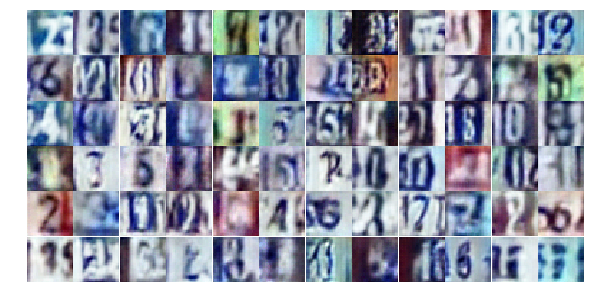

Epoch 9/25... Discriminator Loss: 0.8541... Generator Loss: 1.5548
Epoch 9/25... Discriminator Loss: 1.0876... Generator Loss: 0.8040
Epoch 9/25... Discriminator Loss: 0.6252... Generator Loss: 1.1921
Epoch 9/25... Discriminator Loss: 0.7952... Generator Loss: 0.8571
Epoch 9/25... Discriminator Loss: 0.6686... Generator Loss: 1.0914
Epoch 9/25... Discriminator Loss: 0.7017... Generator Loss: 0.9724
Epoch 9/25... Discriminator Loss: 1.0405... Generator Loss: 0.6397
Epoch 9/25... Discriminator Loss: 0.5195... Generator Loss: 1.3863
Epoch 9/25... Discriminator Loss: 0.8947... Generator Loss: 0.6678
Epoch 9/25... Discriminator Loss: 0.6636... Generator Loss: 1.1304


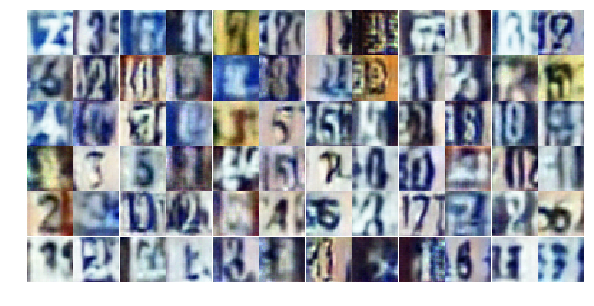

Epoch 9/25... Discriminator Loss: 0.7226... Generator Loss: 1.1873
Epoch 9/25... Discriminator Loss: 0.5703... Generator Loss: 1.7744
Epoch 9/25... Discriminator Loss: 0.8818... Generator Loss: 2.5836
Epoch 9/25... Discriminator Loss: 0.6121... Generator Loss: 1.1395
Epoch 9/25... Discriminator Loss: 0.5044... Generator Loss: 1.6159
Epoch 9/25... Discriminator Loss: 0.5403... Generator Loss: 1.2738
Epoch 9/25... Discriminator Loss: 2.9465... Generator Loss: 0.0992
Epoch 9/25... Discriminator Loss: 0.6202... Generator Loss: 1.2309
Epoch 9/25... Discriminator Loss: 0.5610... Generator Loss: 1.2285
Epoch 9/25... Discriminator Loss: 0.7659... Generator Loss: 0.8498


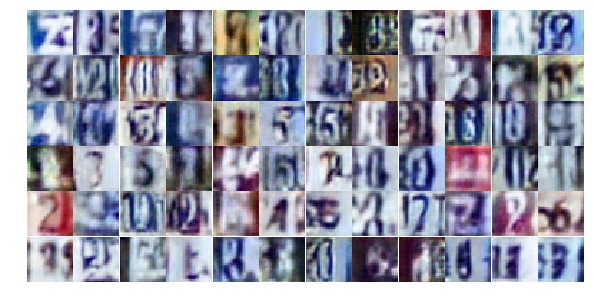

Epoch 9/25... Discriminator Loss: 0.5033... Generator Loss: 1.2841
Epoch 9/25... Discriminator Loss: 0.4715... Generator Loss: 1.6848
Epoch 9/25... Discriminator Loss: 0.7712... Generator Loss: 1.0559
Epoch 9/25... Discriminator Loss: 0.6216... Generator Loss: 1.1194
Epoch 9/25... Discriminator Loss: 0.6170... Generator Loss: 1.1835
Epoch 9/25... Discriminator Loss: 0.5395... Generator Loss: 1.7330
Epoch 9/25... Discriminator Loss: 0.6349... Generator Loss: 1.7436
Epoch 9/25... Discriminator Loss: 0.4072... Generator Loss: 1.4579
Epoch 9/25... Discriminator Loss: 0.9185... Generator Loss: 0.7021
Epoch 9/25... Discriminator Loss: 0.5954... Generator Loss: 1.1895


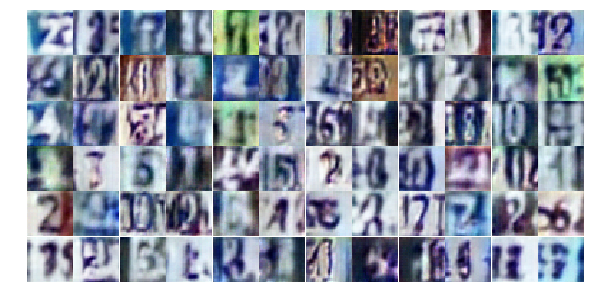

Epoch 9/25... Discriminator Loss: 0.4709... Generator Loss: 1.3834
Epoch 9/25... Discriminator Loss: 0.4068... Generator Loss: 2.5567
Epoch 9/25... Discriminator Loss: 0.5572... Generator Loss: 1.3273
Epoch 9/25... Discriminator Loss: 0.6585... Generator Loss: 1.1410
Epoch 9/25... Discriminator Loss: 0.3962... Generator Loss: 2.0234
Epoch 9/25... Discriminator Loss: 0.5403... Generator Loss: 1.2119
Epoch 9/25... Discriminator Loss: 0.6229... Generator Loss: 1.6266
Epoch 9/25... Discriminator Loss: 1.0195... Generator Loss: 0.6032
Epoch 9/25... Discriminator Loss: 0.4495... Generator Loss: 1.6478
Epoch 9/25... Discriminator Loss: 0.7718... Generator Loss: 2.9936


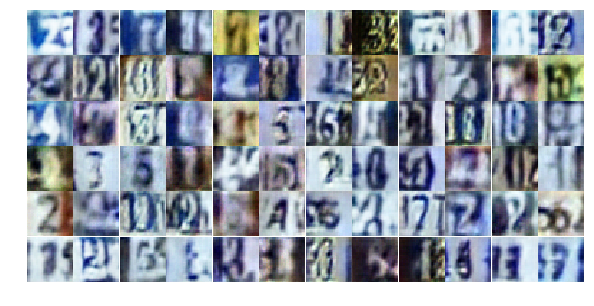

Epoch 9/25... Discriminator Loss: 0.9570... Generator Loss: 1.1769
Epoch 9/25... Discriminator Loss: 4.0268... Generator Loss: 5.7791
Epoch 9/25... Discriminator Loss: 0.6485... Generator Loss: 1.2431
Epoch 9/25... Discriminator Loss: 1.2264... Generator Loss: 0.4698
Epoch 9/25... Discriminator Loss: 0.6961... Generator Loss: 1.1245
Epoch 10/25... Discriminator Loss: 0.6476... Generator Loss: 1.2026
Epoch 10/25... Discriminator Loss: 0.5429... Generator Loss: 1.3610
Epoch 10/25... Discriminator Loss: 1.0233... Generator Loss: 0.6125
Epoch 10/25... Discriminator Loss: 1.0008... Generator Loss: 0.6184
Epoch 10/25... Discriminator Loss: 1.1667... Generator Loss: 0.5479


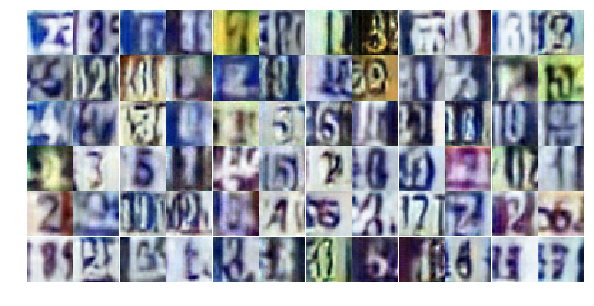

Epoch 10/25... Discriminator Loss: 0.6163... Generator Loss: 1.0859
Epoch 10/25... Discriminator Loss: 0.8201... Generator Loss: 3.5580
Epoch 10/25... Discriminator Loss: 0.8823... Generator Loss: 0.7491
Epoch 10/25... Discriminator Loss: 0.6715... Generator Loss: 1.5333
Epoch 10/25... Discriminator Loss: 0.5219... Generator Loss: 1.4374
Epoch 10/25... Discriminator Loss: 0.6288... Generator Loss: 1.3242
Epoch 10/25... Discriminator Loss: 0.6497... Generator Loss: 0.9904
Epoch 10/25... Discriminator Loss: 1.2351... Generator Loss: 0.5272
Epoch 10/25... Discriminator Loss: 0.8360... Generator Loss: 0.9177
Epoch 10/25... Discriminator Loss: 0.7635... Generator Loss: 0.9662


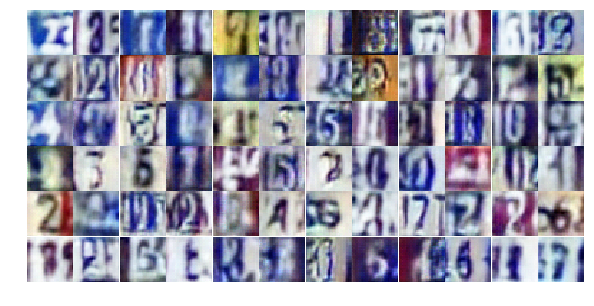

Epoch 10/25... Discriminator Loss: 0.5802... Generator Loss: 1.3295
Epoch 10/25... Discriminator Loss: 0.7152... Generator Loss: 0.9744
Epoch 10/25... Discriminator Loss: 0.8125... Generator Loss: 0.8397
Epoch 10/25... Discriminator Loss: 0.9949... Generator Loss: 0.6603
Epoch 10/25... Discriminator Loss: 0.5951... Generator Loss: 1.3391
Epoch 10/25... Discriminator Loss: 0.4621... Generator Loss: 1.3906
Epoch 10/25... Discriminator Loss: 0.9388... Generator Loss: 0.6913
Epoch 10/25... Discriminator Loss: 0.5559... Generator Loss: 1.4209
Epoch 10/25... Discriminator Loss: 0.6008... Generator Loss: 1.2310
Epoch 10/25... Discriminator Loss: 0.2597... Generator Loss: 2.3041


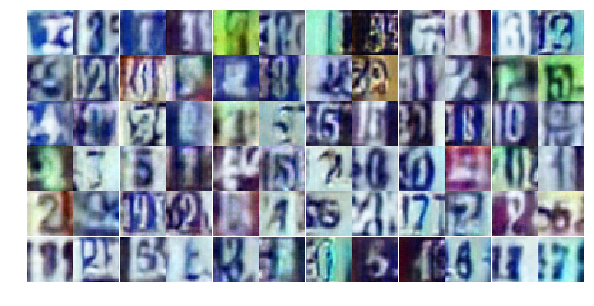

Epoch 10/25... Discriminator Loss: 1.2415... Generator Loss: 0.4355
Epoch 10/25... Discriminator Loss: 0.6749... Generator Loss: 1.1736
Epoch 10/25... Discriminator Loss: 0.5113... Generator Loss: 1.2777
Epoch 10/25... Discriminator Loss: 0.4488... Generator Loss: 1.4211
Epoch 10/25... Discriminator Loss: 1.7012... Generator Loss: 0.2658
Epoch 10/25... Discriminator Loss: 0.7613... Generator Loss: 0.9176
Epoch 10/25... Discriminator Loss: 0.4084... Generator Loss: 1.5267
Epoch 10/25... Discriminator Loss: 0.8671... Generator Loss: 0.7549
Epoch 10/25... Discriminator Loss: 0.7183... Generator Loss: 0.9490
Epoch 10/25... Discriminator Loss: 0.5399... Generator Loss: 1.1833


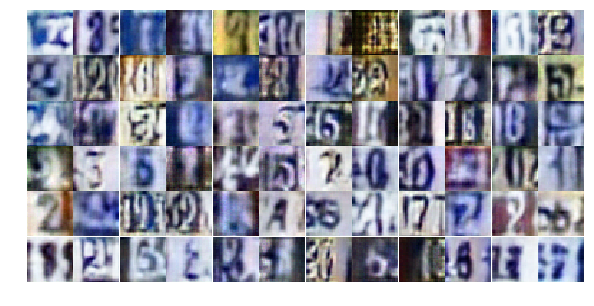

Epoch 10/25... Discriminator Loss: 0.5320... Generator Loss: 1.7711
Epoch 10/25... Discriminator Loss: 0.8263... Generator Loss: 0.7592
Epoch 10/25... Discriminator Loss: 1.8302... Generator Loss: 5.1858
Epoch 10/25... Discriminator Loss: 1.8677... Generator Loss: 3.5783
Epoch 10/25... Discriminator Loss: 0.8522... Generator Loss: 0.8477
Epoch 10/25... Discriminator Loss: 1.7228... Generator Loss: 0.2913
Epoch 10/25... Discriminator Loss: 1.0627... Generator Loss: 0.7736
Epoch 10/25... Discriminator Loss: 0.9784... Generator Loss: 0.7370
Epoch 10/25... Discriminator Loss: 0.6271... Generator Loss: 1.1794
Epoch 10/25... Discriminator Loss: 0.4913... Generator Loss: 2.2451


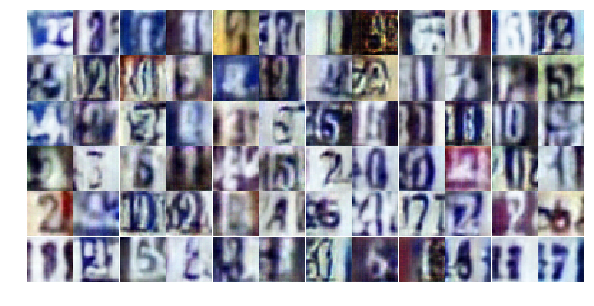

Epoch 10/25... Discriminator Loss: 1.0043... Generator Loss: 0.6964
Epoch 10/25... Discriminator Loss: 0.5384... Generator Loss: 1.3858
Epoch 10/25... Discriminator Loss: 0.7424... Generator Loss: 1.1482
Epoch 10/25... Discriminator Loss: 0.6891... Generator Loss: 2.1400
Epoch 10/25... Discriminator Loss: 0.4861... Generator Loss: 1.4190
Epoch 10/25... Discriminator Loss: 0.5981... Generator Loss: 1.1335
Epoch 10/25... Discriminator Loss: 0.6023... Generator Loss: 1.1848
Epoch 10/25... Discriminator Loss: 0.5711... Generator Loss: 2.1474
Epoch 10/25... Discriminator Loss: 0.6046... Generator Loss: 2.1379
Epoch 10/25... Discriminator Loss: 0.6808... Generator Loss: 1.6791


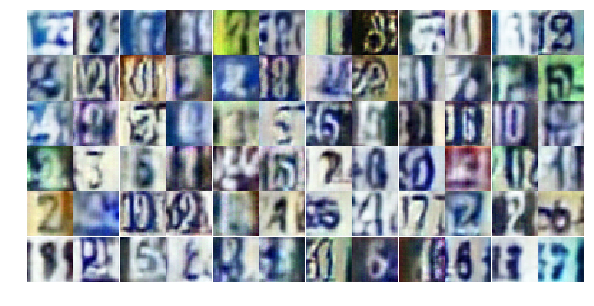

Epoch 10/25... Discriminator Loss: 0.7783... Generator Loss: 1.5943
Epoch 10/25... Discriminator Loss: 0.7299... Generator Loss: 0.9239
Epoch 10/25... Discriminator Loss: 0.4585... Generator Loss: 1.3997
Epoch 11/25... Discriminator Loss: 0.7542... Generator Loss: 0.9963
Epoch 11/25... Discriminator Loss: 0.5374... Generator Loss: 1.1710
Epoch 11/25... Discriminator Loss: 1.7403... Generator Loss: 0.2781
Epoch 11/25... Discriminator Loss: 0.5910... Generator Loss: 1.1565
Epoch 11/25... Discriminator Loss: 0.6553... Generator Loss: 1.2204
Epoch 11/25... Discriminator Loss: 1.8016... Generator Loss: 0.2534
Epoch 11/25... Discriminator Loss: 0.6091... Generator Loss: 1.4435


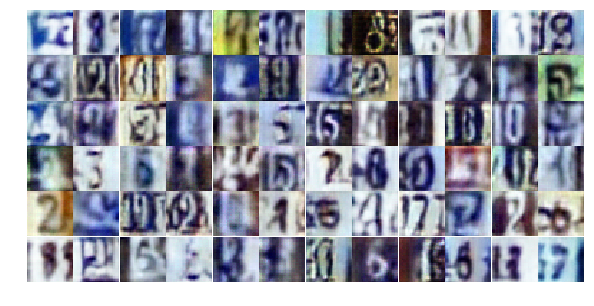

Epoch 11/25... Discriminator Loss: 0.5045... Generator Loss: 1.4071
Epoch 11/25... Discriminator Loss: 0.7540... Generator Loss: 0.9449
Epoch 11/25... Discriminator Loss: 0.2702... Generator Loss: 2.1902
Epoch 11/25... Discriminator Loss: 0.5491... Generator Loss: 1.1677
Epoch 11/25... Discriminator Loss: 0.6739... Generator Loss: 1.1942
Epoch 11/25... Discriminator Loss: 0.4045... Generator Loss: 1.9498
Epoch 11/25... Discriminator Loss: 0.9493... Generator Loss: 2.1584
Epoch 11/25... Discriminator Loss: 0.3930... Generator Loss: 1.7855
Epoch 11/25... Discriminator Loss: 0.7299... Generator Loss: 0.8949
Epoch 11/25... Discriminator Loss: 1.6549... Generator Loss: 0.3404


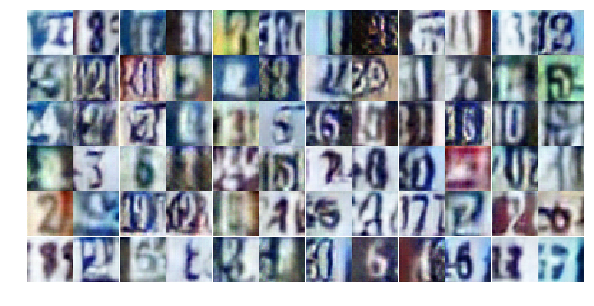

Epoch 11/25... Discriminator Loss: 1.1200... Generator Loss: 0.5669
Epoch 11/25... Discriminator Loss: 0.5729... Generator Loss: 1.9248
Epoch 11/25... Discriminator Loss: 0.8794... Generator Loss: 0.7562
Epoch 11/25... Discriminator Loss: 1.1755... Generator Loss: 0.5008
Epoch 11/25... Discriminator Loss: 0.4347... Generator Loss: 1.6499
Epoch 11/25... Discriminator Loss: 0.4945... Generator Loss: 1.4448
Epoch 11/25... Discriminator Loss: 0.4733... Generator Loss: 1.3429
Epoch 11/25... Discriminator Loss: 0.7467... Generator Loss: 0.8696
Epoch 11/25... Discriminator Loss: 0.3335... Generator Loss: 2.3204
Epoch 11/25... Discriminator Loss: 1.0702... Generator Loss: 0.6191


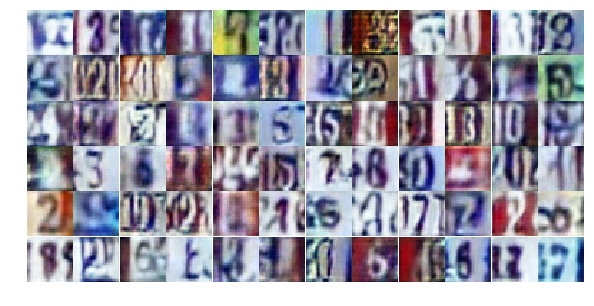

Epoch 11/25... Discriminator Loss: 0.6958... Generator Loss: 1.1723
Epoch 11/25... Discriminator Loss: 0.6112... Generator Loss: 1.1249
Epoch 11/25... Discriminator Loss: 1.1035... Generator Loss: 0.5781
Epoch 11/25... Discriminator Loss: 0.5211... Generator Loss: 1.2862
Epoch 11/25... Discriminator Loss: 0.6730... Generator Loss: 0.9828
Epoch 11/25... Discriminator Loss: 1.3506... Generator Loss: 0.4290
Epoch 11/25... Discriminator Loss: 1.1947... Generator Loss: 0.4778
Epoch 11/25... Discriminator Loss: 0.8886... Generator Loss: 0.7759
Epoch 11/25... Discriminator Loss: 0.8800... Generator Loss: 0.7843
Epoch 11/25... Discriminator Loss: 0.9566... Generator Loss: 0.6502


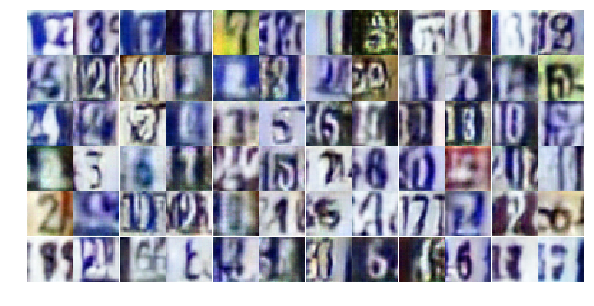

Epoch 11/25... Discriminator Loss: 0.4998... Generator Loss: 1.5229
Epoch 11/25... Discriminator Loss: 0.6162... Generator Loss: 1.3338
Epoch 11/25... Discriminator Loss: 1.2703... Generator Loss: 0.4765
Epoch 11/25... Discriminator Loss: 0.6432... Generator Loss: 1.0948
Epoch 11/25... Discriminator Loss: 0.6770... Generator Loss: 1.8836
Epoch 11/25... Discriminator Loss: 0.6962... Generator Loss: 0.9694
Epoch 11/25... Discriminator Loss: 0.4400... Generator Loss: 1.7832
Epoch 11/25... Discriminator Loss: 0.9696... Generator Loss: 2.2296
Epoch 11/25... Discriminator Loss: 1.2405... Generator Loss: 0.5147
Epoch 11/25... Discriminator Loss: 0.6222... Generator Loss: 1.1117


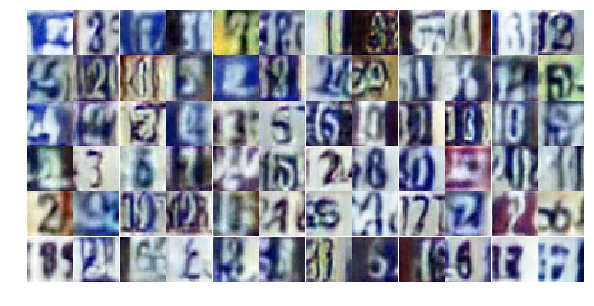

Epoch 11/25... Discriminator Loss: 1.2321... Generator Loss: 0.5120
Epoch 11/25... Discriminator Loss: 0.4546... Generator Loss: 1.4993
Epoch 11/25... Discriminator Loss: 0.4562... Generator Loss: 1.5543
Epoch 11/25... Discriminator Loss: 0.7444... Generator Loss: 0.9206
Epoch 11/25... Discriminator Loss: 1.1909... Generator Loss: 0.5006
Epoch 11/25... Discriminator Loss: 2.5073... Generator Loss: 0.1410
Epoch 11/25... Discriminator Loss: 0.8696... Generator Loss: 0.9923
Epoch 11/25... Discriminator Loss: 0.5719... Generator Loss: 1.4577
Epoch 11/25... Discriminator Loss: 0.8701... Generator Loss: 0.8430
Epoch 11/25... Discriminator Loss: 0.7492... Generator Loss: 0.9392


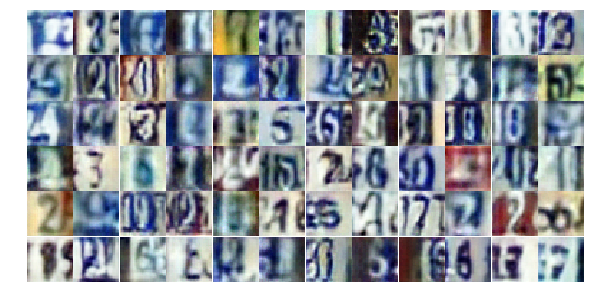

Epoch 12/25... Discriminator Loss: 0.7116... Generator Loss: 1.1820
Epoch 12/25... Discriminator Loss: 0.7967... Generator Loss: 1.1051
Epoch 12/25... Discriminator Loss: 0.8020... Generator Loss: 0.8121
Epoch 12/25... Discriminator Loss: 0.4759... Generator Loss: 1.3194
Epoch 12/25... Discriminator Loss: 0.5202... Generator Loss: 1.7474
Epoch 12/25... Discriminator Loss: 1.0190... Generator Loss: 0.6673
Epoch 12/25... Discriminator Loss: 0.7865... Generator Loss: 0.8569
Epoch 12/25... Discriminator Loss: 0.4643... Generator Loss: 1.6326
Epoch 12/25... Discriminator Loss: 0.6461... Generator Loss: 1.5590
Epoch 12/25... Discriminator Loss: 1.3914... Generator Loss: 0.4062


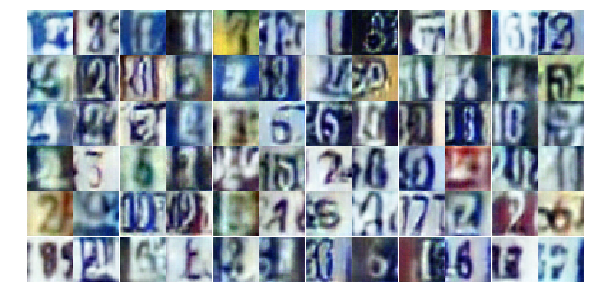

Epoch 12/25... Discriminator Loss: 0.5909... Generator Loss: 1.1424
Epoch 12/25... Discriminator Loss: 0.7693... Generator Loss: 1.0431
Epoch 12/25... Discriminator Loss: 0.5441... Generator Loss: 1.1802
Epoch 12/25... Discriminator Loss: 0.5973... Generator Loss: 1.3929
Epoch 12/25... Discriminator Loss: 0.7064... Generator Loss: 2.4250
Epoch 12/25... Discriminator Loss: 1.0355... Generator Loss: 0.6374
Epoch 12/25... Discriminator Loss: 1.2159... Generator Loss: 0.4970
Epoch 12/25... Discriminator Loss: 0.4586... Generator Loss: 1.4117
Epoch 12/25... Discriminator Loss: 0.6044... Generator Loss: 1.0546
Epoch 12/25... Discriminator Loss: 0.6917... Generator Loss: 1.1826


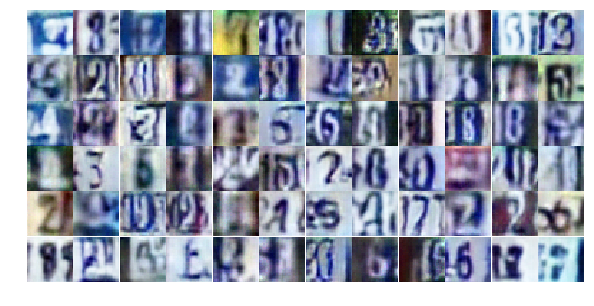

Epoch 12/25... Discriminator Loss: 0.4745... Generator Loss: 1.2242
Epoch 12/25... Discriminator Loss: 0.4388... Generator Loss: 1.9129
Epoch 12/25... Discriminator Loss: 0.5875... Generator Loss: 1.3403
Epoch 12/25... Discriminator Loss: 0.3783... Generator Loss: 1.7692
Epoch 12/25... Discriminator Loss: 0.6771... Generator Loss: 1.1293
Epoch 12/25... Discriminator Loss: 0.6026... Generator Loss: 1.1387
Epoch 12/25... Discriminator Loss: 1.2498... Generator Loss: 0.4650
Epoch 12/25... Discriminator Loss: 0.3646... Generator Loss: 1.7987
Epoch 12/25... Discriminator Loss: 0.5498... Generator Loss: 1.1787
Epoch 12/25... Discriminator Loss: 0.6056... Generator Loss: 1.0032


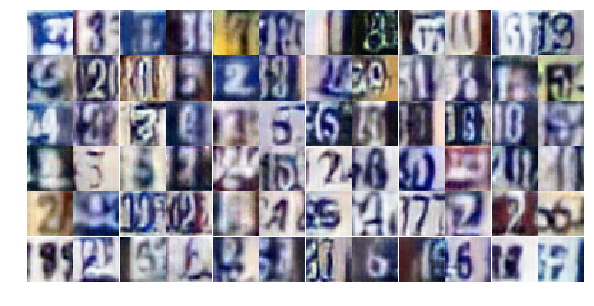

Epoch 12/25... Discriminator Loss: 0.5171... Generator Loss: 1.2688
Epoch 12/25... Discriminator Loss: 0.9894... Generator Loss: 0.6485
Epoch 12/25... Discriminator Loss: 0.8012... Generator Loss: 0.7937
Epoch 12/25... Discriminator Loss: 1.8751... Generator Loss: 0.2330
Epoch 12/25... Discriminator Loss: 1.1041... Generator Loss: 2.4811
Epoch 12/25... Discriminator Loss: 0.8738... Generator Loss: 0.9044
Epoch 12/25... Discriminator Loss: 0.8391... Generator Loss: 0.7796
Epoch 12/25... Discriminator Loss: 0.9610... Generator Loss: 0.7645
Epoch 12/25... Discriminator Loss: 0.5295... Generator Loss: 1.5836
Epoch 12/25... Discriminator Loss: 0.3894... Generator Loss: 1.4694


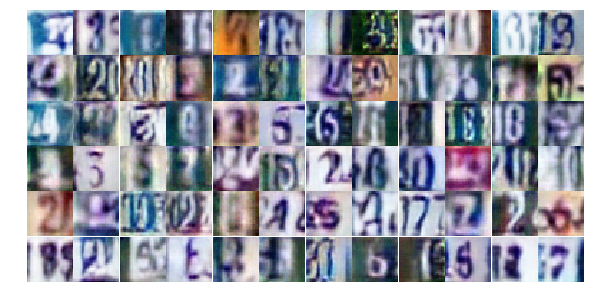

Epoch 12/25... Discriminator Loss: 0.5312... Generator Loss: 1.3955
Epoch 12/25... Discriminator Loss: 0.5553... Generator Loss: 1.0922
Epoch 12/25... Discriminator Loss: 0.5961... Generator Loss: 1.0666
Epoch 12/25... Discriminator Loss: 1.3293... Generator Loss: 0.4749
Epoch 12/25... Discriminator Loss: 0.7031... Generator Loss: 1.5262
Epoch 12/25... Discriminator Loss: 2.1119... Generator Loss: 0.2031
Epoch 12/25... Discriminator Loss: 0.8432... Generator Loss: 0.8496
Epoch 12/25... Discriminator Loss: 1.3206... Generator Loss: 0.4258
Epoch 12/25... Discriminator Loss: 0.5865... Generator Loss: 1.3906
Epoch 12/25... Discriminator Loss: 0.5918... Generator Loss: 1.4196


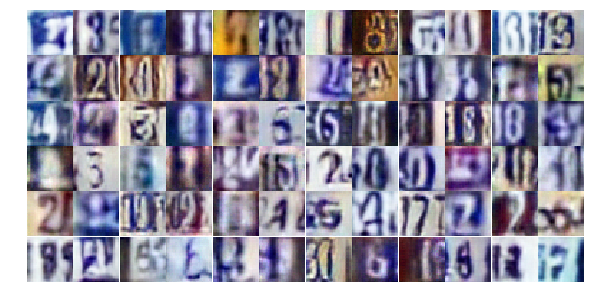

Epoch 12/25... Discriminator Loss: 1.1290... Generator Loss: 1.2883
Epoch 12/25... Discriminator Loss: 0.6302... Generator Loss: 1.1407
Epoch 12/25... Discriminator Loss: 0.7574... Generator Loss: 1.6053
Epoch 12/25... Discriminator Loss: 3.1477... Generator Loss: 0.0892
Epoch 12/25... Discriminator Loss: 0.7404... Generator Loss: 0.9352
Epoch 12/25... Discriminator Loss: 0.8779... Generator Loss: 1.3670
Epoch 12/25... Discriminator Loss: 0.7096... Generator Loss: 1.1263
Epoch 13/25... Discriminator Loss: 0.5771... Generator Loss: 1.1482
Epoch 13/25... Discriminator Loss: 0.4695... Generator Loss: 1.4169
Epoch 13/25... Discriminator Loss: 1.0088... Generator Loss: 0.6406


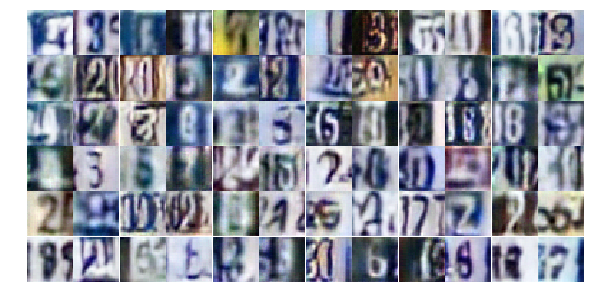

Epoch 13/25... Discriminator Loss: 0.6230... Generator Loss: 1.1835
Epoch 13/25... Discriminator Loss: 0.5798... Generator Loss: 1.3443
Epoch 13/25... Discriminator Loss: 1.1554... Generator Loss: 0.5117
Epoch 13/25... Discriminator Loss: 1.0742... Generator Loss: 0.8744
Epoch 13/25... Discriminator Loss: 0.8877... Generator Loss: 0.9024
Epoch 13/25... Discriminator Loss: 0.6023... Generator Loss: 1.1303
Epoch 13/25... Discriminator Loss: 0.4377... Generator Loss: 1.6500
Epoch 13/25... Discriminator Loss: 0.7675... Generator Loss: 0.8552
Epoch 13/25... Discriminator Loss: 0.5735... Generator Loss: 1.1113
Epoch 13/25... Discriminator Loss: 0.4653... Generator Loss: 1.7547


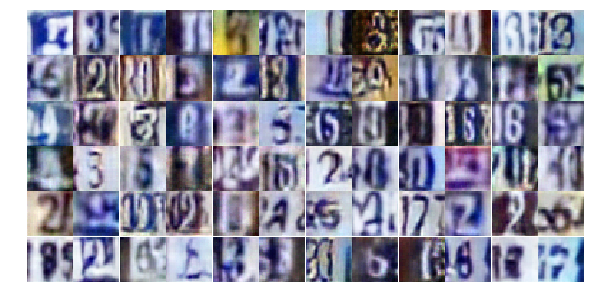

Epoch 13/25... Discriminator Loss: 0.6775... Generator Loss: 1.2770
Epoch 13/25... Discriminator Loss: 0.7779... Generator Loss: 0.9629
Epoch 13/25... Discriminator Loss: 1.0987... Generator Loss: 0.5521
Epoch 13/25... Discriminator Loss: 0.7850... Generator Loss: 0.9499
Epoch 13/25... Discriminator Loss: 0.5463... Generator Loss: 1.7679
Epoch 13/25... Discriminator Loss: 1.2079... Generator Loss: 0.5009
Epoch 13/25... Discriminator Loss: 0.6936... Generator Loss: 1.1298
Epoch 13/25... Discriminator Loss: 1.0556... Generator Loss: 0.6682
Epoch 13/25... Discriminator Loss: 0.6196... Generator Loss: 1.1127
Epoch 13/25... Discriminator Loss: 1.1781... Generator Loss: 0.5012


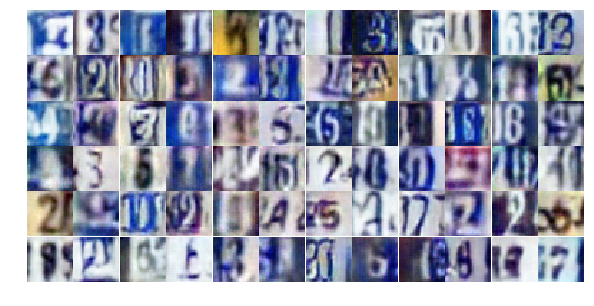

Epoch 13/25... Discriminator Loss: 0.7459... Generator Loss: 0.9714
Epoch 13/25... Discriminator Loss: 0.4624... Generator Loss: 1.7223
Epoch 13/25... Discriminator Loss: 0.5943... Generator Loss: 1.1870
Epoch 13/25... Discriminator Loss: 0.8361... Generator Loss: 0.7925
Epoch 13/25... Discriminator Loss: 0.5802... Generator Loss: 1.2555
Epoch 13/25... Discriminator Loss: 0.7281... Generator Loss: 0.9864
Epoch 13/25... Discriminator Loss: 0.8453... Generator Loss: 2.0716
Epoch 13/25... Discriminator Loss: 0.7353... Generator Loss: 0.8984
Epoch 13/25... Discriminator Loss: 0.6424... Generator Loss: 1.0890
Epoch 13/25... Discriminator Loss: 0.6062... Generator Loss: 1.2507


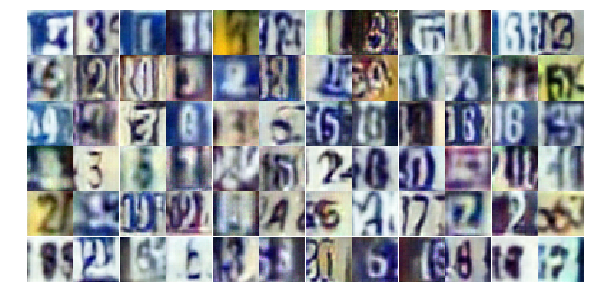

Epoch 13/25... Discriminator Loss: 0.8841... Generator Loss: 0.8480
Epoch 13/25... Discriminator Loss: 0.8578... Generator Loss: 0.9111
Epoch 13/25... Discriminator Loss: 0.6300... Generator Loss: 1.2083
Epoch 13/25... Discriminator Loss: 0.8547... Generator Loss: 0.8677
Epoch 13/25... Discriminator Loss: 0.5455... Generator Loss: 1.2394
Epoch 13/25... Discriminator Loss: 0.4859... Generator Loss: 1.6994
Epoch 13/25... Discriminator Loss: 0.5204... Generator Loss: 1.2146
Epoch 13/25... Discriminator Loss: 0.9282... Generator Loss: 0.8005
Epoch 13/25... Discriminator Loss: 0.7191... Generator Loss: 0.8948
Epoch 13/25... Discriminator Loss: 0.7969... Generator Loss: 0.8397


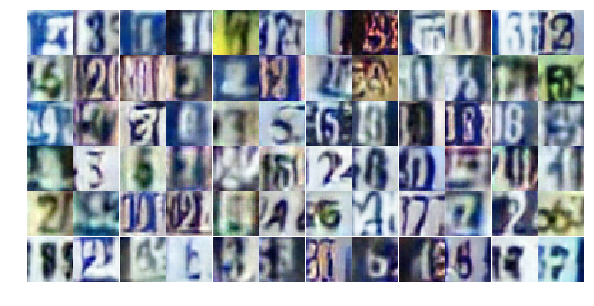

Epoch 13/25... Discriminator Loss: 0.6748... Generator Loss: 1.0573
Epoch 13/25... Discriminator Loss: 0.7199... Generator Loss: 1.0007
Epoch 13/25... Discriminator Loss: 0.9157... Generator Loss: 0.7019
Epoch 13/25... Discriminator Loss: 0.8676... Generator Loss: 1.2244
Epoch 13/25... Discriminator Loss: 1.0223... Generator Loss: 0.7122
Epoch 13/25... Discriminator Loss: 0.5386... Generator Loss: 1.2695
Epoch 13/25... Discriminator Loss: 1.4608... Generator Loss: 0.3658
Epoch 13/25... Discriminator Loss: 0.9435... Generator Loss: 0.6569
Epoch 13/25... Discriminator Loss: 1.3233... Generator Loss: 0.4480
Epoch 13/25... Discriminator Loss: 0.9297... Generator Loss: 0.7800


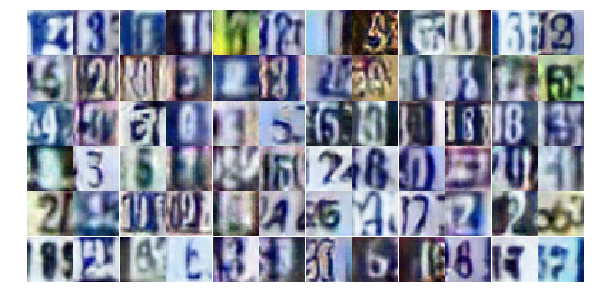

Epoch 13/25... Discriminator Loss: 0.3537... Generator Loss: 2.1526
Epoch 13/25... Discriminator Loss: 1.1778... Generator Loss: 0.4981
Epoch 13/25... Discriminator Loss: 0.9960... Generator Loss: 0.6480
Epoch 13/25... Discriminator Loss: 0.8679... Generator Loss: 0.7095
Epoch 14/25... Discriminator Loss: 0.9764... Generator Loss: 0.7142
Epoch 14/25... Discriminator Loss: 0.7262... Generator Loss: 1.2050
Epoch 14/25... Discriminator Loss: 0.8721... Generator Loss: 0.8366
Epoch 14/25... Discriminator Loss: 0.4779... Generator Loss: 1.9381
Epoch 14/25... Discriminator Loss: 0.6867... Generator Loss: 1.0971
Epoch 14/25... Discriminator Loss: 0.9788... Generator Loss: 0.6802


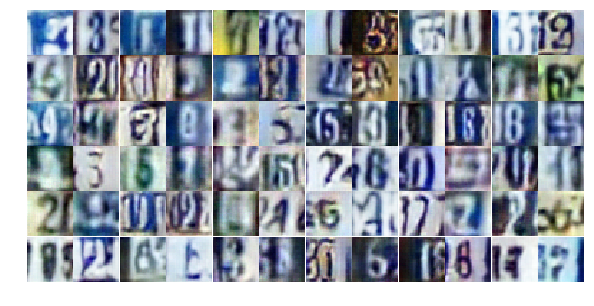

Epoch 14/25... Discriminator Loss: 1.2773... Generator Loss: 0.5390
Epoch 14/25... Discriminator Loss: 1.6765... Generator Loss: 0.3165
Epoch 14/25... Discriminator Loss: 0.6754... Generator Loss: 1.1587
Epoch 14/25... Discriminator Loss: 0.6888... Generator Loss: 1.0215
Epoch 14/25... Discriminator Loss: 1.3148... Generator Loss: 0.4682
Epoch 14/25... Discriminator Loss: 0.3000... Generator Loss: 1.8769
Epoch 14/25... Discriminator Loss: 0.2946... Generator Loss: 1.9747
Epoch 14/25... Discriminator Loss: 1.7407... Generator Loss: 0.3122
Epoch 14/25... Discriminator Loss: 1.3913... Generator Loss: 0.3943
Epoch 14/25... Discriminator Loss: 0.9227... Generator Loss: 0.7725


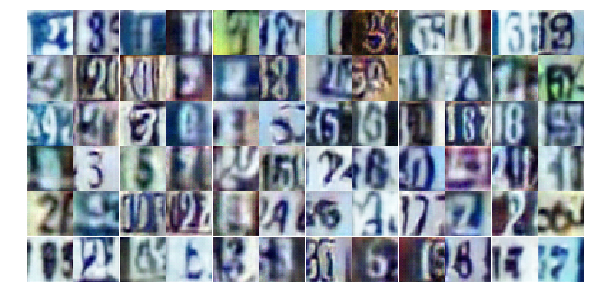

Epoch 14/25... Discriminator Loss: 0.4405... Generator Loss: 1.3568
Epoch 14/25... Discriminator Loss: 0.5938... Generator Loss: 1.9735
Epoch 14/25... Discriminator Loss: 0.9386... Generator Loss: 0.7282
Epoch 14/25... Discriminator Loss: 0.5276... Generator Loss: 1.3392
Epoch 14/25... Discriminator Loss: 1.0105... Generator Loss: 0.6526
Epoch 14/25... Discriminator Loss: 0.7159... Generator Loss: 1.0117
Epoch 14/25... Discriminator Loss: 0.5437... Generator Loss: 1.3540
Epoch 14/25... Discriminator Loss: 1.3061... Generator Loss: 0.4660
Epoch 14/25... Discriminator Loss: 0.7622... Generator Loss: 0.8427
Epoch 14/25... Discriminator Loss: 0.5334... Generator Loss: 1.3442


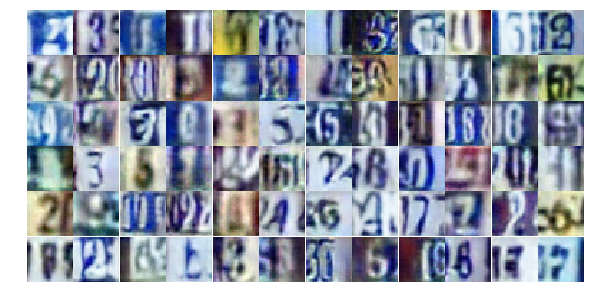

Epoch 14/25... Discriminator Loss: 1.2852... Generator Loss: 0.4508
Epoch 14/25... Discriminator Loss: 0.5247... Generator Loss: 1.6339
Epoch 14/25... Discriminator Loss: 0.4702... Generator Loss: 2.0113
Epoch 14/25... Discriminator Loss: 0.5072... Generator Loss: 1.2248
Epoch 14/25... Discriminator Loss: 0.7235... Generator Loss: 1.1307
Epoch 14/25... Discriminator Loss: 0.8444... Generator Loss: 0.8732
Epoch 14/25... Discriminator Loss: 0.7155... Generator Loss: 0.9296
Epoch 14/25... Discriminator Loss: 0.3619... Generator Loss: 1.6749
Epoch 14/25... Discriminator Loss: 0.3515... Generator Loss: 2.1209
Epoch 14/25... Discriminator Loss: 0.6476... Generator Loss: 1.0928


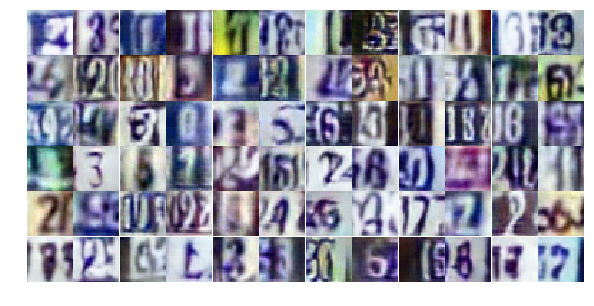

Epoch 14/25... Discriminator Loss: 1.2905... Generator Loss: 0.4835
Epoch 14/25... Discriminator Loss: 0.8909... Generator Loss: 0.8712
Epoch 14/25... Discriminator Loss: 1.5596... Generator Loss: 0.4967
Epoch 14/25... Discriminator Loss: 0.9955... Generator Loss: 0.6677
Epoch 14/25... Discriminator Loss: 0.9748... Generator Loss: 0.6972
Epoch 14/25... Discriminator Loss: 0.7753... Generator Loss: 0.9777
Epoch 14/25... Discriminator Loss: 0.8472... Generator Loss: 0.8154
Epoch 14/25... Discriminator Loss: 0.6032... Generator Loss: 1.1330
Epoch 14/25... Discriminator Loss: 1.4650... Generator Loss: 3.0022
Epoch 14/25... Discriminator Loss: 1.4808... Generator Loss: 0.6629


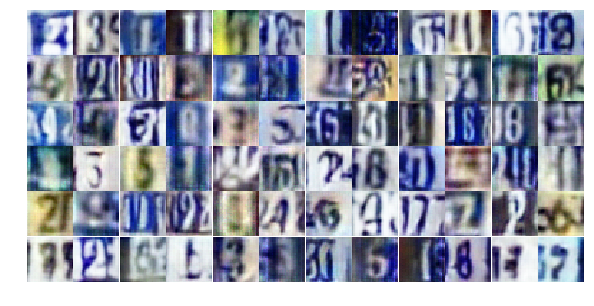

Epoch 14/25... Discriminator Loss: 0.8630... Generator Loss: 1.4140
Epoch 14/25... Discriminator Loss: 1.0323... Generator Loss: 0.6037
Epoch 14/25... Discriminator Loss: 0.7283... Generator Loss: 1.1658
Epoch 14/25... Discriminator Loss: 0.8770... Generator Loss: 0.7911
Epoch 14/25... Discriminator Loss: 0.8334... Generator Loss: 0.8287
Epoch 14/25... Discriminator Loss: 0.8112... Generator Loss: 0.8480
Epoch 14/25... Discriminator Loss: 0.6084... Generator Loss: 1.3337
Epoch 14/25... Discriminator Loss: 0.7100... Generator Loss: 1.0092
Epoch 14/25... Discriminator Loss: 1.2389... Generator Loss: 0.4756
Epoch 14/25... Discriminator Loss: 1.1993... Generator Loss: 0.5813


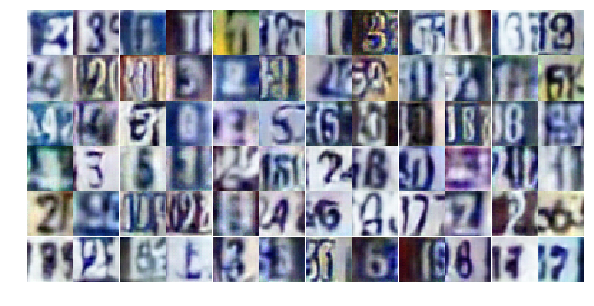

Epoch 14/25... Discriminator Loss: 1.0108... Generator Loss: 0.7438
Epoch 14/25... Discriminator Loss: 0.7359... Generator Loss: 1.0188
Epoch 15/25... Discriminator Loss: 0.9040... Generator Loss: 0.6671
Epoch 15/25... Discriminator Loss: 0.4792... Generator Loss: 1.5216
Epoch 15/25... Discriminator Loss: 0.5429... Generator Loss: 1.3536
Epoch 15/25... Discriminator Loss: 1.0509... Generator Loss: 0.6217
Epoch 15/25... Discriminator Loss: 0.9700... Generator Loss: 0.7035
Epoch 15/25... Discriminator Loss: 0.7565... Generator Loss: 0.9778
Epoch 15/25... Discriminator Loss: 1.5334... Generator Loss: 0.3469
Epoch 15/25... Discriminator Loss: 0.5560... Generator Loss: 1.2942


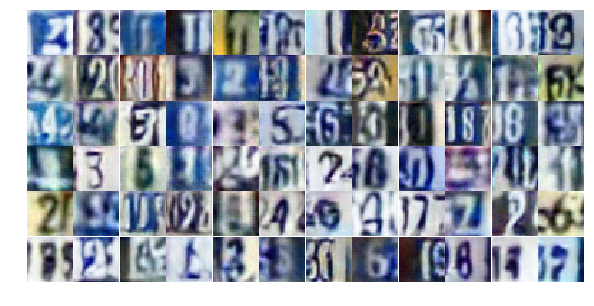

Epoch 15/25... Discriminator Loss: 0.8463... Generator Loss: 0.8872
Epoch 15/25... Discriminator Loss: 0.6973... Generator Loss: 1.2539
Epoch 15/25... Discriminator Loss: 0.7659... Generator Loss: 1.3146
Epoch 15/25... Discriminator Loss: 0.6336... Generator Loss: 1.1357
Epoch 15/25... Discriminator Loss: 0.7951... Generator Loss: 0.9758
Epoch 15/25... Discriminator Loss: 0.5273... Generator Loss: 1.3473
Epoch 15/25... Discriminator Loss: 0.7833... Generator Loss: 1.0816
Epoch 15/25... Discriminator Loss: 0.6128... Generator Loss: 1.8650
Epoch 15/25... Discriminator Loss: 0.5476... Generator Loss: 2.7126
Epoch 15/25... Discriminator Loss: 1.9479... Generator Loss: 0.2728


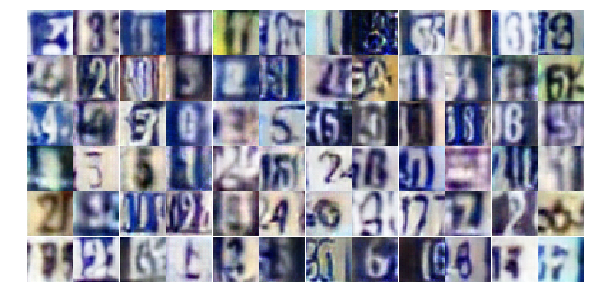

Epoch 15/25... Discriminator Loss: 2.0366... Generator Loss: 0.2766
Epoch 15/25... Discriminator Loss: 0.7517... Generator Loss: 1.9848
Epoch 15/25... Discriminator Loss: 0.6397... Generator Loss: 1.3207
Epoch 15/25... Discriminator Loss: 0.9123... Generator Loss: 0.8014
Epoch 15/25... Discriminator Loss: 0.9729... Generator Loss: 0.7988
Epoch 15/25... Discriminator Loss: 0.9387... Generator Loss: 0.7785
Epoch 15/25... Discriminator Loss: 1.0274... Generator Loss: 0.7301
Epoch 15/25... Discriminator Loss: 0.6898... Generator Loss: 0.9212
Epoch 15/25... Discriminator Loss: 0.6599... Generator Loss: 1.0471
Epoch 15/25... Discriminator Loss: 0.9030... Generator Loss: 0.7890


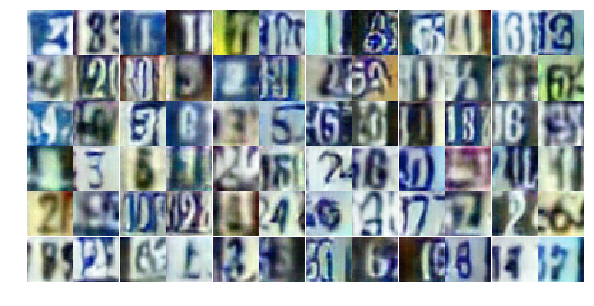

Epoch 15/25... Discriminator Loss: 0.7560... Generator Loss: 1.0049
Epoch 15/25... Discriminator Loss: 0.7257... Generator Loss: 0.9695
Epoch 15/25... Discriminator Loss: 0.4194... Generator Loss: 1.5487
Epoch 15/25... Discriminator Loss: 0.6832... Generator Loss: 1.1650
Epoch 15/25... Discriminator Loss: 0.5628... Generator Loss: 1.2764
Epoch 15/25... Discriminator Loss: 0.7030... Generator Loss: 1.5552
Epoch 15/25... Discriminator Loss: 0.5117... Generator Loss: 1.5753
Epoch 15/25... Discriminator Loss: 0.6124... Generator Loss: 1.1204
Epoch 15/25... Discriminator Loss: 0.6392... Generator Loss: 1.0432
Epoch 15/25... Discriminator Loss: 0.9927... Generator Loss: 0.6742


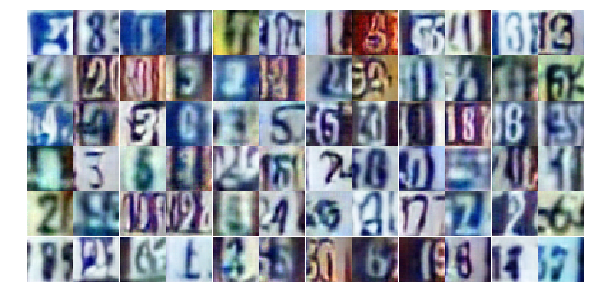

Epoch 15/25... Discriminator Loss: 0.7046... Generator Loss: 1.0828
Epoch 15/25... Discriminator Loss: 0.9089... Generator Loss: 0.7240
Epoch 15/25... Discriminator Loss: 0.5549... Generator Loss: 1.5828
Epoch 15/25... Discriminator Loss: 0.6343... Generator Loss: 1.0270
Epoch 15/25... Discriminator Loss: 1.1108... Generator Loss: 0.5289
Epoch 15/25... Discriminator Loss: 1.8227... Generator Loss: 0.3011
Epoch 15/25... Discriminator Loss: 0.5419... Generator Loss: 2.7618
Epoch 15/25... Discriminator Loss: 0.8375... Generator Loss: 0.9420
Epoch 15/25... Discriminator Loss: 0.6987... Generator Loss: 1.0086
Epoch 15/25... Discriminator Loss: 0.7734... Generator Loss: 1.2578


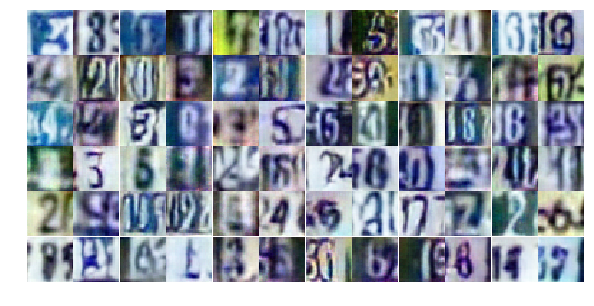

Epoch 15/25... Discriminator Loss: 0.7636... Generator Loss: 0.9307
Epoch 15/25... Discriminator Loss: 0.6129... Generator Loss: 1.3291
Epoch 15/25... Discriminator Loss: 0.4842... Generator Loss: 1.3993
Epoch 15/25... Discriminator Loss: 1.0288... Generator Loss: 0.6671
Epoch 15/25... Discriminator Loss: 0.5217... Generator Loss: 1.6069
Epoch 15/25... Discriminator Loss: 0.9414... Generator Loss: 0.7402
Epoch 15/25... Discriminator Loss: 1.0188... Generator Loss: 0.6536
Epoch 15/25... Discriminator Loss: 0.5508... Generator Loss: 1.4285
Epoch 15/25... Discriminator Loss: 1.3682... Generator Loss: 0.4438
Epoch 16/25... Discriminator Loss: 1.2128... Generator Loss: 0.4679


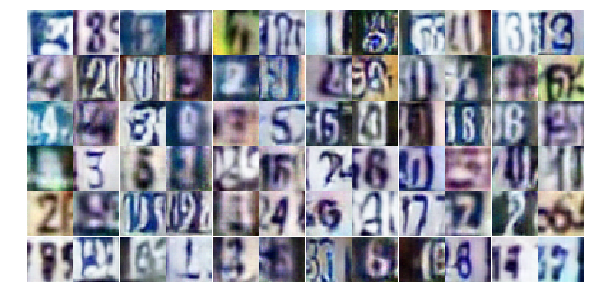

Epoch 16/25... Discriminator Loss: 0.7234... Generator Loss: 0.9916
Epoch 16/25... Discriminator Loss: 0.7617... Generator Loss: 0.9154
Epoch 16/25... Discriminator Loss: 0.6963... Generator Loss: 1.0490
Epoch 16/25... Discriminator Loss: 0.6012... Generator Loss: 1.1542
Epoch 16/25... Discriminator Loss: 0.5105... Generator Loss: 2.3631
Epoch 16/25... Discriminator Loss: 0.9343... Generator Loss: 2.4954
Epoch 16/25... Discriminator Loss: 1.6305... Generator Loss: 0.3234
Epoch 16/25... Discriminator Loss: 0.9483... Generator Loss: 0.7417
Epoch 16/25... Discriminator Loss: 0.5922... Generator Loss: 1.1032
Epoch 16/25... Discriminator Loss: 0.7024... Generator Loss: 0.9276


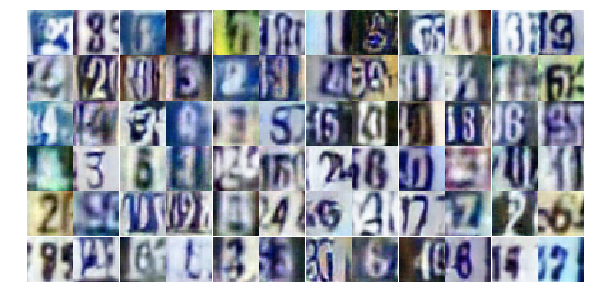

Epoch 16/25... Discriminator Loss: 0.9167... Generator Loss: 0.7509
Epoch 16/25... Discriminator Loss: 0.5624... Generator Loss: 1.4108
Epoch 16/25... Discriminator Loss: 0.6549... Generator Loss: 1.2210
Epoch 16/25... Discriminator Loss: 1.5353... Generator Loss: 0.4022
Epoch 16/25... Discriminator Loss: 0.3902... Generator Loss: 1.7211
Epoch 16/25... Discriminator Loss: 0.5705... Generator Loss: 1.4018
Epoch 16/25... Discriminator Loss: 1.8876... Generator Loss: 0.2361
Epoch 16/25... Discriminator Loss: 0.4872... Generator Loss: 1.7521
Epoch 16/25... Discriminator Loss: 0.5342... Generator Loss: 1.4123
Epoch 16/25... Discriminator Loss: 0.7062... Generator Loss: 1.0658


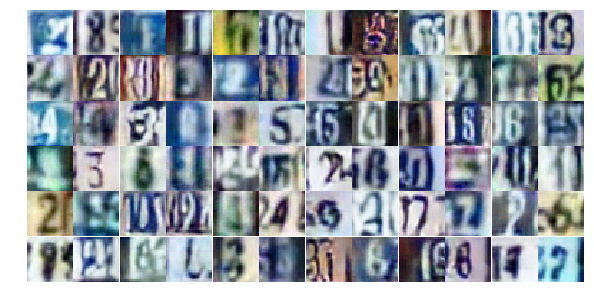

Epoch 16/25... Discriminator Loss: 0.6092... Generator Loss: 1.2522
Epoch 16/25... Discriminator Loss: 0.6800... Generator Loss: 1.0748
Epoch 16/25... Discriminator Loss: 0.7711... Generator Loss: 0.8532
Epoch 16/25... Discriminator Loss: 1.1138... Generator Loss: 0.5868
Epoch 16/25... Discriminator Loss: 0.6773... Generator Loss: 1.3420
Epoch 16/25... Discriminator Loss: 0.8340... Generator Loss: 0.8486
Epoch 16/25... Discriminator Loss: 0.8185... Generator Loss: 0.8272
Epoch 16/25... Discriminator Loss: 0.5778... Generator Loss: 1.1890
Epoch 16/25... Discriminator Loss: 0.8123... Generator Loss: 0.8825
Epoch 16/25... Discriminator Loss: 0.5981... Generator Loss: 1.0615


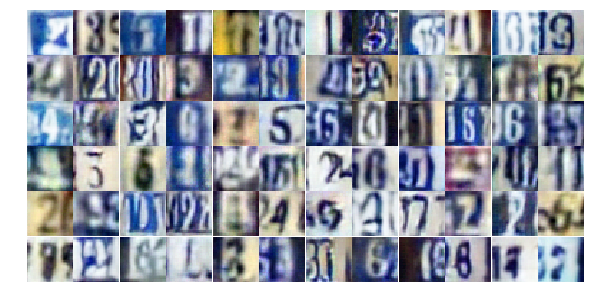

Epoch 16/25... Discriminator Loss: 0.5446... Generator Loss: 1.1453
Epoch 16/25... Discriminator Loss: 0.5777... Generator Loss: 1.2850
Epoch 16/25... Discriminator Loss: 0.5210... Generator Loss: 1.8713
Epoch 16/25... Discriminator Loss: 1.1874... Generator Loss: 0.6291
Epoch 16/25... Discriminator Loss: 0.8642... Generator Loss: 1.1588
Epoch 16/25... Discriminator Loss: 0.8606... Generator Loss: 0.8931
Epoch 16/25... Discriminator Loss: 1.0528... Generator Loss: 0.5839
Epoch 16/25... Discriminator Loss: 1.5883... Generator Loss: 0.3233
Epoch 16/25... Discriminator Loss: 1.3661... Generator Loss: 0.4227
Epoch 16/25... Discriminator Loss: 0.6150... Generator Loss: 2.2524


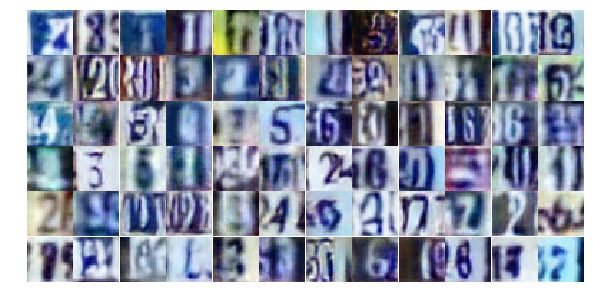

Epoch 16/25... Discriminator Loss: 0.5314... Generator Loss: 1.2808
Epoch 16/25... Discriminator Loss: 0.5189... Generator Loss: 1.5106
Epoch 16/25... Discriminator Loss: 1.4517... Generator Loss: 0.4410
Epoch 16/25... Discriminator Loss: 1.3600... Generator Loss: 0.5060
Epoch 16/25... Discriminator Loss: 0.6537... Generator Loss: 0.9810
Epoch 16/25... Discriminator Loss: 1.0503... Generator Loss: 0.6245
Epoch 16/25... Discriminator Loss: 0.4271... Generator Loss: 1.8755
Epoch 16/25... Discriminator Loss: 0.8842... Generator Loss: 0.7217
Epoch 16/25... Discriminator Loss: 0.5271... Generator Loss: 1.2626
Epoch 16/25... Discriminator Loss: 1.0157... Generator Loss: 0.6859


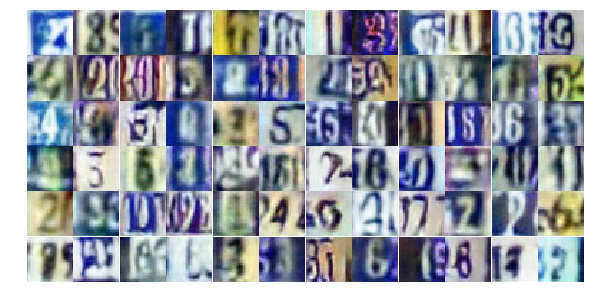

Epoch 16/25... Discriminator Loss: 0.9713... Generator Loss: 0.8912
Epoch 16/25... Discriminator Loss: 0.9523... Generator Loss: 0.7063
Epoch 16/25... Discriminator Loss: 2.7657... Generator Loss: 0.1437
Epoch 16/25... Discriminator Loss: 0.5871... Generator Loss: 1.3358
Epoch 16/25... Discriminator Loss: 0.5646... Generator Loss: 1.5286
Epoch 16/25... Discriminator Loss: 0.8523... Generator Loss: 0.8028
Epoch 17/25... Discriminator Loss: 0.7863... Generator Loss: 1.0240
Epoch 17/25... Discriminator Loss: 1.0325... Generator Loss: 0.7769
Epoch 17/25... Discriminator Loss: 0.5623... Generator Loss: 1.4000
Epoch 17/25... Discriminator Loss: 1.1160... Generator Loss: 0.6104


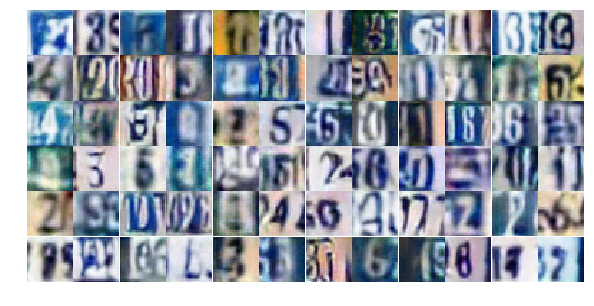

Epoch 17/25... Discriminator Loss: 0.4429... Generator Loss: 1.5844
Epoch 17/25... Discriminator Loss: 0.5130... Generator Loss: 1.3915
Epoch 17/25... Discriminator Loss: 0.7406... Generator Loss: 1.1623
Epoch 17/25... Discriminator Loss: 0.7443... Generator Loss: 0.9459
Epoch 17/25... Discriminator Loss: 0.8832... Generator Loss: 0.8569
Epoch 17/25... Discriminator Loss: 0.8615... Generator Loss: 1.0549
Epoch 17/25... Discriminator Loss: 0.7739... Generator Loss: 1.6624
Epoch 17/25... Discriminator Loss: 0.6408... Generator Loss: 1.0975
Epoch 17/25... Discriminator Loss: 0.5624... Generator Loss: 1.3608
Epoch 17/25... Discriminator Loss: 0.5474... Generator Loss: 1.4898


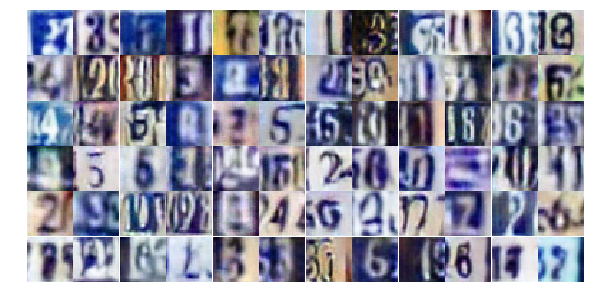

Epoch 17/25... Discriminator Loss: 0.7636... Generator Loss: 1.0316
Epoch 17/25... Discriminator Loss: 0.6476... Generator Loss: 1.3136
Epoch 17/25... Discriminator Loss: 0.7694... Generator Loss: 1.1650
Epoch 17/25... Discriminator Loss: 0.8188... Generator Loss: 1.0132
Epoch 17/25... Discriminator Loss: 0.6130... Generator Loss: 1.2904
Epoch 17/25... Discriminator Loss: 0.7825... Generator Loss: 0.8794
Epoch 17/25... Discriminator Loss: 0.5798... Generator Loss: 1.3114
Epoch 17/25... Discriminator Loss: 0.6500... Generator Loss: 1.0567
Epoch 17/25... Discriminator Loss: 0.5020... Generator Loss: 1.2813
Epoch 17/25... Discriminator Loss: 0.6846... Generator Loss: 0.9218


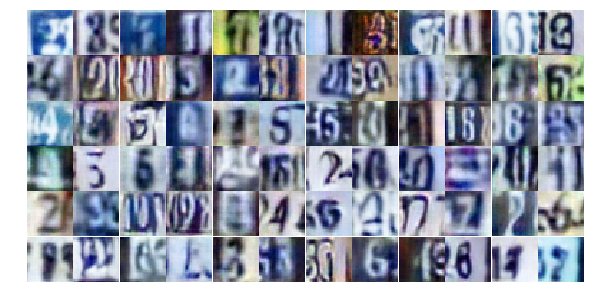

Epoch 17/25... Discriminator Loss: 1.8665... Generator Loss: 0.2877
Epoch 17/25... Discriminator Loss: 0.3820... Generator Loss: 1.8304
Epoch 17/25... Discriminator Loss: 0.6072... Generator Loss: 1.1151
Epoch 17/25... Discriminator Loss: 1.5420... Generator Loss: 0.4001
Epoch 17/25... Discriminator Loss: 1.4001... Generator Loss: 0.3877
Epoch 17/25... Discriminator Loss: 0.6271... Generator Loss: 1.2359
Epoch 17/25... Discriminator Loss: 0.7285... Generator Loss: 0.9795
Epoch 17/25... Discriminator Loss: 1.2468... Generator Loss: 0.4655
Epoch 17/25... Discriminator Loss: 0.8426... Generator Loss: 0.8557
Epoch 17/25... Discriminator Loss: 0.3895... Generator Loss: 1.7448


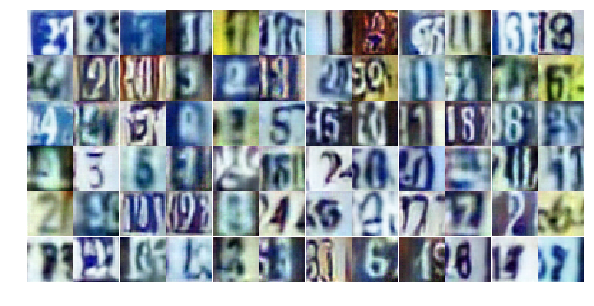

Epoch 17/25... Discriminator Loss: 1.1325... Generator Loss: 0.5591
Epoch 17/25... Discriminator Loss: 1.1307... Generator Loss: 2.4088
Epoch 17/25... Discriminator Loss: 0.6892... Generator Loss: 0.9785
Epoch 17/25... Discriminator Loss: 0.7016... Generator Loss: 1.3986
Epoch 17/25... Discriminator Loss: 0.9987... Generator Loss: 0.7226
Epoch 17/25... Discriminator Loss: 0.8012... Generator Loss: 0.8499
Epoch 17/25... Discriminator Loss: 0.8260... Generator Loss: 1.2127
Epoch 17/25... Discriminator Loss: 0.5710... Generator Loss: 1.3410
Epoch 17/25... Discriminator Loss: 0.3047... Generator Loss: 2.0059
Epoch 17/25... Discriminator Loss: 0.9315... Generator Loss: 0.6603


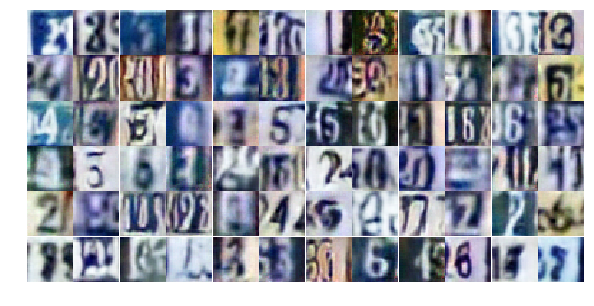

Epoch 17/25... Discriminator Loss: 1.7728... Generator Loss: 2.7344
Epoch 17/25... Discriminator Loss: 0.3998... Generator Loss: 1.7552
Epoch 17/25... Discriminator Loss: 0.8701... Generator Loss: 2.4789
Epoch 17/25... Discriminator Loss: 0.4569... Generator Loss: 1.9999
Epoch 17/25... Discriminator Loss: 0.7508... Generator Loss: 0.9850
Epoch 17/25... Discriminator Loss: 1.0339... Generator Loss: 0.6321
Epoch 17/25... Discriminator Loss: 0.9136... Generator Loss: 0.7514
Epoch 17/25... Discriminator Loss: 0.9388... Generator Loss: 0.6850
Epoch 17/25... Discriminator Loss: 1.1211... Generator Loss: 0.5584
Epoch 17/25... Discriminator Loss: 1.1692... Generator Loss: 0.5508


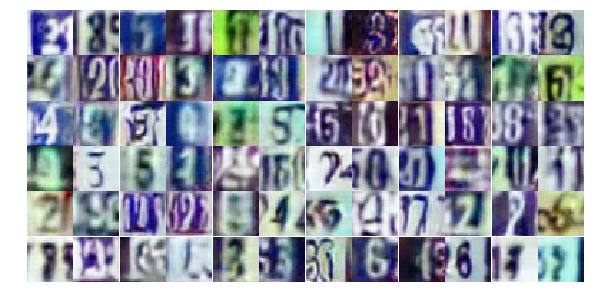

Epoch 17/25... Discriminator Loss: 0.5995... Generator Loss: 1.2538
Epoch 17/25... Discriminator Loss: 0.7898... Generator Loss: 1.0727
Epoch 17/25... Discriminator Loss: 0.5130... Generator Loss: 1.3285
Epoch 17/25... Discriminator Loss: 0.5539... Generator Loss: 1.4241
Epoch 18/25... Discriminator Loss: 1.6413... Generator Loss: 0.3336
Epoch 18/25... Discriminator Loss: 1.0319... Generator Loss: 0.6124
Epoch 18/25... Discriminator Loss: 0.8117... Generator Loss: 0.8870
Epoch 18/25... Discriminator Loss: 0.7413... Generator Loss: 0.9351
Epoch 18/25... Discriminator Loss: 0.9119... Generator Loss: 0.8533
Epoch 18/25... Discriminator Loss: 0.8072... Generator Loss: 1.1189


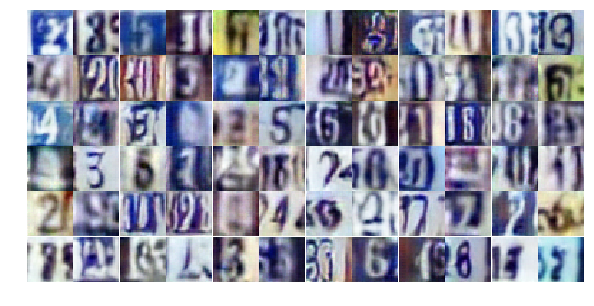

Epoch 18/25... Discriminator Loss: 0.4934... Generator Loss: 1.6718
Epoch 18/25... Discriminator Loss: 1.4974... Generator Loss: 0.3394
Epoch 18/25... Discriminator Loss: 1.0136... Generator Loss: 0.6340
Epoch 18/25... Discriminator Loss: 0.5662... Generator Loss: 1.4448
Epoch 18/25... Discriminator Loss: 0.7867... Generator Loss: 0.9027
Epoch 18/25... Discriminator Loss: 1.1571... Generator Loss: 0.5532
Epoch 18/25... Discriminator Loss: 0.7123... Generator Loss: 0.9585
Epoch 18/25... Discriminator Loss: 0.8529... Generator Loss: 0.7694
Epoch 18/25... Discriminator Loss: 0.7469... Generator Loss: 0.9283
Epoch 18/25... Discriminator Loss: 0.6631... Generator Loss: 0.9448


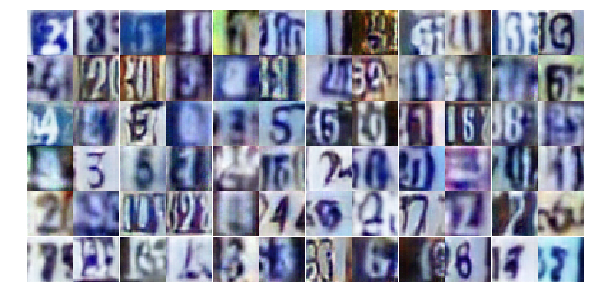

Epoch 18/25... Discriminator Loss: 0.5173... Generator Loss: 1.5542
Epoch 18/25... Discriminator Loss: 0.5712... Generator Loss: 1.8181
Epoch 18/25... Discriminator Loss: 1.0226... Generator Loss: 0.7494
Epoch 18/25... Discriminator Loss: 0.5760... Generator Loss: 1.3605
Epoch 18/25... Discriminator Loss: 0.8626... Generator Loss: 0.7216
Epoch 18/25... Discriminator Loss: 1.0905... Generator Loss: 2.3090
Epoch 18/25... Discriminator Loss: 1.0509... Generator Loss: 0.7365
Epoch 18/25... Discriminator Loss: 0.6816... Generator Loss: 1.1848
Epoch 18/25... Discriminator Loss: 0.7641... Generator Loss: 0.9195
Epoch 18/25... Discriminator Loss: 0.7885... Generator Loss: 0.9068


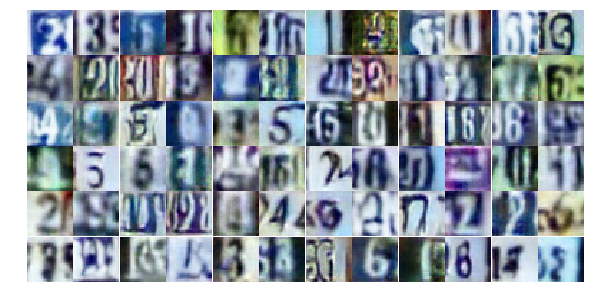

Epoch 18/25... Discriminator Loss: 0.5910... Generator Loss: 1.1153
Epoch 18/25... Discriminator Loss: 0.8246... Generator Loss: 0.8604
Epoch 18/25... Discriminator Loss: 0.8222... Generator Loss: 0.8704
Epoch 18/25... Discriminator Loss: 0.6829... Generator Loss: 1.0427
Epoch 18/25... Discriminator Loss: 1.2057... Generator Loss: 0.4760
Epoch 18/25... Discriminator Loss: 0.5796... Generator Loss: 1.1802
Epoch 18/25... Discriminator Loss: 0.6415... Generator Loss: 1.0383
Epoch 18/25... Discriminator Loss: 0.4129... Generator Loss: 1.6846
Epoch 18/25... Discriminator Loss: 0.8196... Generator Loss: 0.8767
Epoch 18/25... Discriminator Loss: 1.1817... Generator Loss: 0.6134


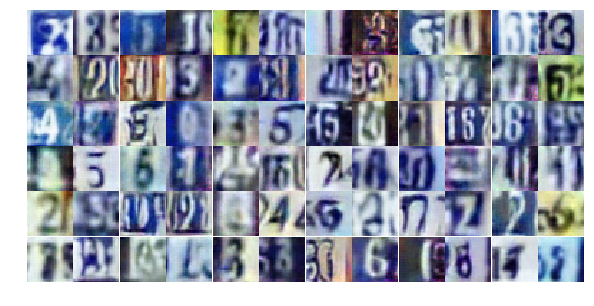

Epoch 18/25... Discriminator Loss: 0.7672... Generator Loss: 0.9147
Epoch 18/25... Discriminator Loss: 0.7065... Generator Loss: 1.0471
Epoch 18/25... Discriminator Loss: 0.6369... Generator Loss: 1.3928
Epoch 18/25... Discriminator Loss: 0.5927... Generator Loss: 1.3363
Epoch 18/25... Discriminator Loss: 0.8095... Generator Loss: 0.8928
Epoch 18/25... Discriminator Loss: 0.4800... Generator Loss: 1.3172
Epoch 18/25... Discriminator Loss: 1.0922... Generator Loss: 0.6075
Epoch 18/25... Discriminator Loss: 3.2676... Generator Loss: 5.5214
Epoch 18/25... Discriminator Loss: 0.8518... Generator Loss: 1.1409
Epoch 18/25... Discriminator Loss: 0.3733... Generator Loss: 2.5256


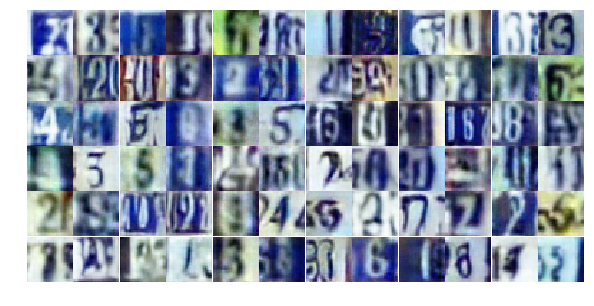

Epoch 18/25... Discriminator Loss: 0.9374... Generator Loss: 0.6976
Epoch 18/25... Discriminator Loss: 1.6278... Generator Loss: 0.3244
Epoch 18/25... Discriminator Loss: 0.9526... Generator Loss: 0.7281
Epoch 18/25... Discriminator Loss: 1.0370... Generator Loss: 0.6240
Epoch 18/25... Discriminator Loss: 0.7248... Generator Loss: 0.9601
Epoch 18/25... Discriminator Loss: 0.7708... Generator Loss: 3.1746
Epoch 18/25... Discriminator Loss: 0.6272... Generator Loss: 1.1829
Epoch 18/25... Discriminator Loss: 0.4585... Generator Loss: 1.5339
Epoch 18/25... Discriminator Loss: 1.2734... Generator Loss: 0.4668
Epoch 18/25... Discriminator Loss: 1.0387... Generator Loss: 0.6356


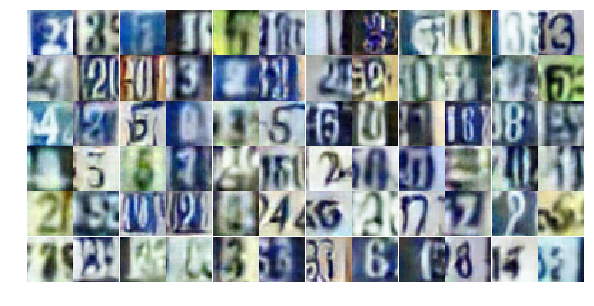

Epoch 18/25... Discriminator Loss: 0.8050... Generator Loss: 2.6902
Epoch 19/25... Discriminator Loss: 1.3366... Generator Loss: 0.4807
Epoch 19/25... Discriminator Loss: 1.0796... Generator Loss: 0.5818
Epoch 19/25... Discriminator Loss: 1.0297... Generator Loss: 0.6303
Epoch 19/25... Discriminator Loss: 0.7284... Generator Loss: 1.0496
Epoch 19/25... Discriminator Loss: 0.8819... Generator Loss: 0.8499
Epoch 19/25... Discriminator Loss: 0.4090... Generator Loss: 1.6809
Epoch 19/25... Discriminator Loss: 0.7893... Generator Loss: 0.9507
Epoch 19/25... Discriminator Loss: 0.5539... Generator Loss: 1.7619
Epoch 19/25... Discriminator Loss: 0.9451... Generator Loss: 0.7149


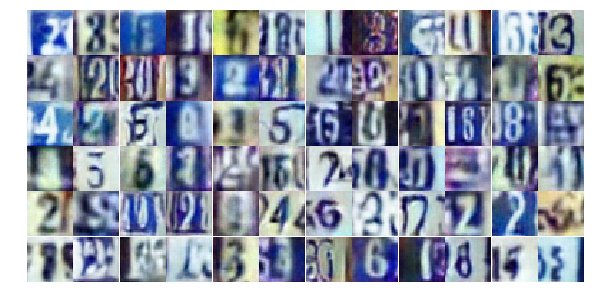

Epoch 19/25... Discriminator Loss: 0.6669... Generator Loss: 0.9874
Epoch 19/25... Discriminator Loss: 0.9408... Generator Loss: 0.6966
Epoch 19/25... Discriminator Loss: 0.7993... Generator Loss: 1.1956
Epoch 19/25... Discriminator Loss: 1.0965... Generator Loss: 0.5346
Epoch 19/25... Discriminator Loss: 1.0624... Generator Loss: 0.5994
Epoch 19/25... Discriminator Loss: 0.6224... Generator Loss: 1.4306
Epoch 19/25... Discriminator Loss: 4.5462... Generator Loss: 5.7384
Epoch 19/25... Discriminator Loss: 1.1795... Generator Loss: 0.6271
Epoch 19/25... Discriminator Loss: 0.6959... Generator Loss: 1.6965
Epoch 19/25... Discriminator Loss: 0.8805... Generator Loss: 0.8501


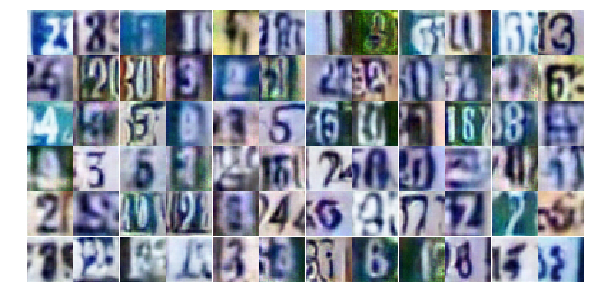

Epoch 19/25... Discriminator Loss: 0.7500... Generator Loss: 0.9383
Epoch 19/25... Discriminator Loss: 1.4035... Generator Loss: 0.4261
Epoch 19/25... Discriminator Loss: 1.1612... Generator Loss: 0.5417
Epoch 19/25... Discriminator Loss: 0.8444... Generator Loss: 0.9005
Epoch 19/25... Discriminator Loss: 1.0618... Generator Loss: 0.6440
Epoch 19/25... Discriminator Loss: 1.0668... Generator Loss: 0.6559
Epoch 19/25... Discriminator Loss: 0.7384... Generator Loss: 1.0656
Epoch 19/25... Discriminator Loss: 0.8026... Generator Loss: 0.8365
Epoch 19/25... Discriminator Loss: 0.7289... Generator Loss: 1.0187
Epoch 19/25... Discriminator Loss: 1.2259... Generator Loss: 0.5047


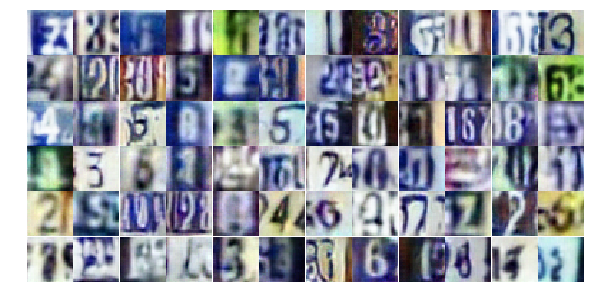

Epoch 19/25... Discriminator Loss: 0.8151... Generator Loss: 0.8700
Epoch 19/25... Discriminator Loss: 0.7640... Generator Loss: 0.8812
Epoch 19/25... Discriminator Loss: 0.8353... Generator Loss: 0.8059
Epoch 19/25... Discriminator Loss: 0.9014... Generator Loss: 0.7895
Epoch 19/25... Discriminator Loss: 0.7699... Generator Loss: 0.9232
Epoch 19/25... Discriminator Loss: 1.4845... Generator Loss: 0.4034
Epoch 19/25... Discriminator Loss: 0.7497... Generator Loss: 1.6539
Epoch 19/25... Discriminator Loss: 0.5211... Generator Loss: 1.5325
Epoch 19/25... Discriminator Loss: 0.9497... Generator Loss: 0.8042
Epoch 19/25... Discriminator Loss: 0.7020... Generator Loss: 1.0317


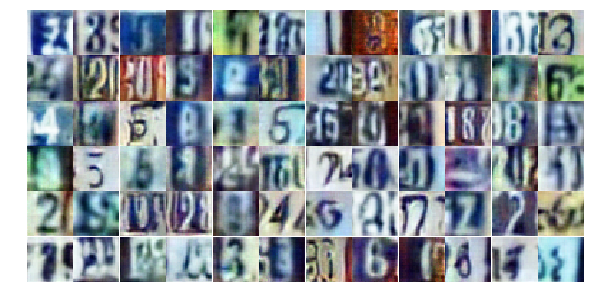

Epoch 19/25... Discriminator Loss: 0.6224... Generator Loss: 1.0528
Epoch 19/25... Discriminator Loss: 0.8560... Generator Loss: 0.8256
Epoch 19/25... Discriminator Loss: 0.8505... Generator Loss: 0.8007
Epoch 19/25... Discriminator Loss: 1.0205... Generator Loss: 0.6781
Epoch 19/25... Discriminator Loss: 0.6625... Generator Loss: 1.6602
Epoch 19/25... Discriminator Loss: 1.4117... Generator Loss: 0.4745
Epoch 19/25... Discriminator Loss: 0.6736... Generator Loss: 1.0344
Epoch 19/25... Discriminator Loss: 0.5502... Generator Loss: 1.2490
Epoch 19/25... Discriminator Loss: 0.7703... Generator Loss: 0.9341
Epoch 19/25... Discriminator Loss: 1.2552... Generator Loss: 0.5609


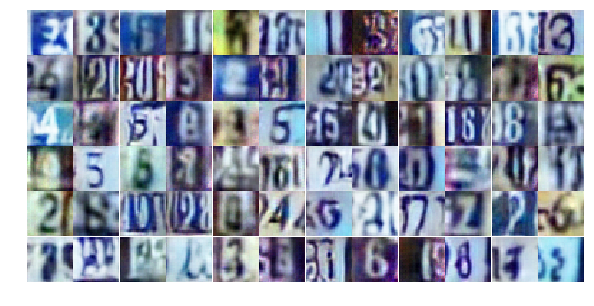

Epoch 19/25... Discriminator Loss: 0.7966... Generator Loss: 0.8039
Epoch 19/25... Discriminator Loss: 0.6519... Generator Loss: 1.0296
Epoch 19/25... Discriminator Loss: 0.8827... Generator Loss: 3.1623
Epoch 19/25... Discriminator Loss: 1.2555... Generator Loss: 0.4831
Epoch 19/25... Discriminator Loss: 0.8364... Generator Loss: 2.2066
Epoch 19/25... Discriminator Loss: 0.5705... Generator Loss: 1.5866
Epoch 19/25... Discriminator Loss: 1.5779... Generator Loss: 0.3658
Epoch 19/25... Discriminator Loss: 0.7047... Generator Loss: 1.1427
Epoch 20/25... Discriminator Loss: 0.7638... Generator Loss: 1.1281
Epoch 20/25... Discriminator Loss: 0.7052... Generator Loss: 0.9939


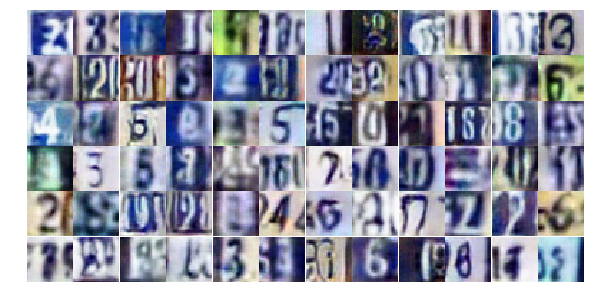

Epoch 20/25... Discriminator Loss: 0.6253... Generator Loss: 1.0726
Epoch 20/25... Discriminator Loss: 0.7914... Generator Loss: 0.9774
Epoch 20/25... Discriminator Loss: 1.3967... Generator Loss: 0.3909
Epoch 20/25... Discriminator Loss: 1.1873... Generator Loss: 0.5598
Epoch 20/25... Discriminator Loss: 0.4677... Generator Loss: 2.0495
Epoch 20/25... Discriminator Loss: 0.7819... Generator Loss: 0.9841
Epoch 20/25... Discriminator Loss: 0.8015... Generator Loss: 0.9389
Epoch 20/25... Discriminator Loss: 0.9169... Generator Loss: 0.7888
Epoch 20/25... Discriminator Loss: 1.0979... Generator Loss: 0.5829
Epoch 20/25... Discriminator Loss: 0.6142... Generator Loss: 1.0703


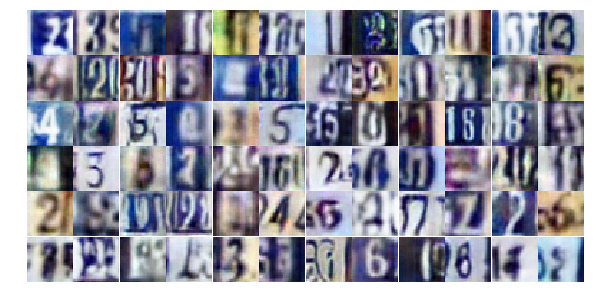

Epoch 20/25... Discriminator Loss: 1.1458... Generator Loss: 0.5711
Epoch 20/25... Discriminator Loss: 0.8970... Generator Loss: 0.7867
Epoch 20/25... Discriminator Loss: 0.6908... Generator Loss: 1.0679
Epoch 20/25... Discriminator Loss: 0.6094... Generator Loss: 1.2071
Epoch 20/25... Discriminator Loss: 0.7638... Generator Loss: 0.9061
Epoch 20/25... Discriminator Loss: 0.9270... Generator Loss: 0.8077
Epoch 20/25... Discriminator Loss: 1.6347... Generator Loss: 0.3191
Epoch 20/25... Discriminator Loss: 0.5464... Generator Loss: 1.3132
Epoch 20/25... Discriminator Loss: 0.7679... Generator Loss: 0.8797
Epoch 20/25... Discriminator Loss: 1.0085... Generator Loss: 0.7082


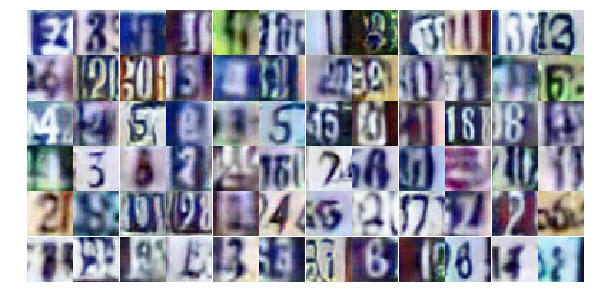

Epoch 20/25... Discriminator Loss: 0.5762... Generator Loss: 1.1237
Epoch 20/25... Discriminator Loss: 0.7145... Generator Loss: 0.9385
Epoch 20/25... Discriminator Loss: 0.3290... Generator Loss: 1.7495
Epoch 20/25... Discriminator Loss: 1.6620... Generator Loss: 0.3254
Epoch 20/25... Discriminator Loss: 0.8939... Generator Loss: 0.7889
Epoch 20/25... Discriminator Loss: 0.6011... Generator Loss: 1.1100
Epoch 20/25... Discriminator Loss: 0.7291... Generator Loss: 1.0770
Epoch 20/25... Discriminator Loss: 1.7351... Generator Loss: 0.4006
Epoch 20/25... Discriminator Loss: 0.8627... Generator Loss: 0.8699
Epoch 20/25... Discriminator Loss: 0.4518... Generator Loss: 1.3665


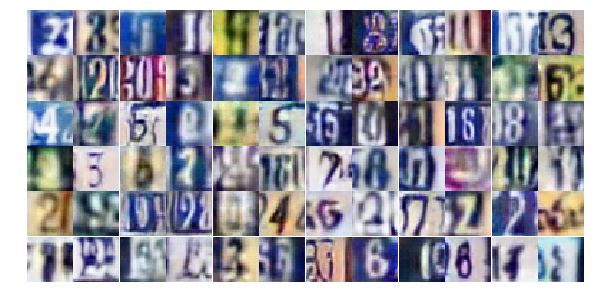

Epoch 20/25... Discriminator Loss: 0.6610... Generator Loss: 1.2822
Epoch 20/25... Discriminator Loss: 1.0509... Generator Loss: 0.6090
Epoch 20/25... Discriminator Loss: 0.8682... Generator Loss: 0.7899
Epoch 20/25... Discriminator Loss: 0.8367... Generator Loss: 1.0153
Epoch 20/25... Discriminator Loss: 0.9547... Generator Loss: 0.7208
Epoch 20/25... Discriminator Loss: 0.7487... Generator Loss: 0.9589
Epoch 20/25... Discriminator Loss: 1.0423... Generator Loss: 0.6242
Epoch 20/25... Discriminator Loss: 1.0629... Generator Loss: 0.6315
Epoch 20/25... Discriminator Loss: 0.6204... Generator Loss: 1.3383
Epoch 20/25... Discriminator Loss: 1.6852... Generator Loss: 0.2896


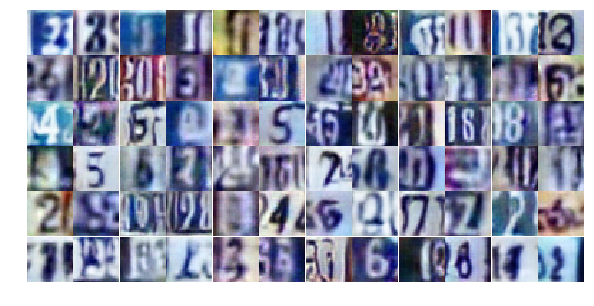

Epoch 20/25... Discriminator Loss: 0.5068... Generator Loss: 1.6045
Epoch 20/25... Discriminator Loss: 0.7458... Generator Loss: 1.3673
Epoch 20/25... Discriminator Loss: 1.1906... Generator Loss: 0.9279
Epoch 20/25... Discriminator Loss: 1.6151... Generator Loss: 0.4106
Epoch 20/25... Discriminator Loss: 1.0177... Generator Loss: 2.7236
Epoch 20/25... Discriminator Loss: 2.5076... Generator Loss: 0.1919
Epoch 20/25... Discriminator Loss: 1.7139... Generator Loss: 0.3124
Epoch 20/25... Discriminator Loss: 0.5481... Generator Loss: 1.5556
Epoch 20/25... Discriminator Loss: 0.8791... Generator Loss: 0.8129
Epoch 20/25... Discriminator Loss: 0.8773... Generator Loss: 0.8064


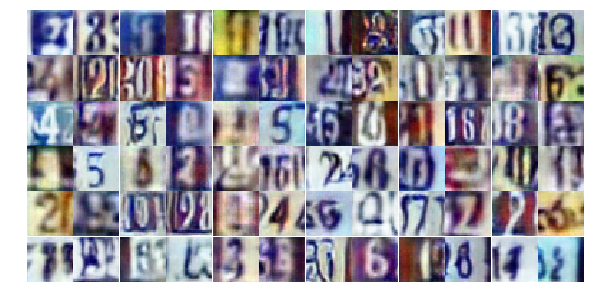

Epoch 20/25... Discriminator Loss: 0.6212... Generator Loss: 1.1683
Epoch 20/25... Discriminator Loss: 0.7207... Generator Loss: 1.7047
Epoch 20/25... Discriminator Loss: 0.6480... Generator Loss: 1.0966
Epoch 20/25... Discriminator Loss: 0.9125... Generator Loss: 1.8577
Epoch 20/25... Discriminator Loss: 0.7759... Generator Loss: 0.8372
Epoch 20/25... Discriminator Loss: 0.4497... Generator Loss: 1.4081
Epoch 21/25... Discriminator Loss: 0.8177... Generator Loss: 1.2633
Epoch 21/25... Discriminator Loss: 0.9220... Generator Loss: 0.8042
Epoch 21/25... Discriminator Loss: 1.1262... Generator Loss: 0.5875
Epoch 21/25... Discriminator Loss: 1.1101... Generator Loss: 0.5869


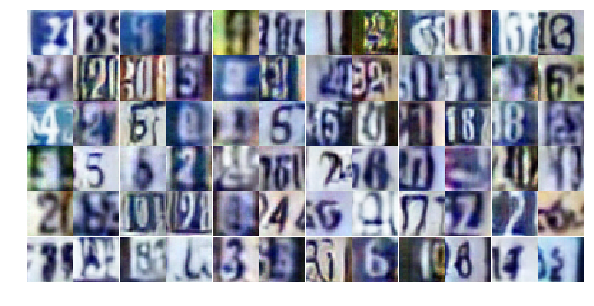

Epoch 21/25... Discriminator Loss: 0.8031... Generator Loss: 0.9523
Epoch 21/25... Discriminator Loss: 1.4986... Generator Loss: 0.3746
Epoch 21/25... Discriminator Loss: 0.4700... Generator Loss: 1.5520
Epoch 21/25... Discriminator Loss: 0.5109... Generator Loss: 1.4236
Epoch 21/25... Discriminator Loss: 0.7331... Generator Loss: 0.8802
Epoch 21/25... Discriminator Loss: 0.7696... Generator Loss: 0.8687
Epoch 21/25... Discriminator Loss: 0.8620... Generator Loss: 0.8373
Epoch 21/25... Discriminator Loss: 1.1948... Generator Loss: 0.5535
Epoch 21/25... Discriminator Loss: 0.9158... Generator Loss: 0.6966
Epoch 21/25... Discriminator Loss: 0.8371... Generator Loss: 0.7534


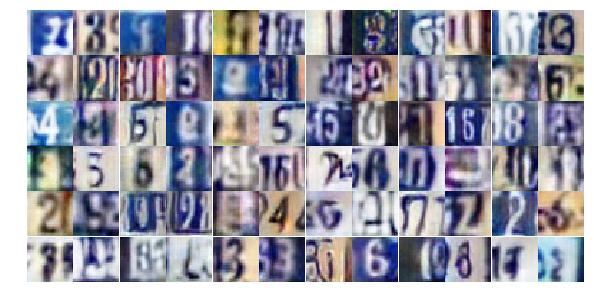

Epoch 21/25... Discriminator Loss: 0.3810... Generator Loss: 1.5793
Epoch 21/25... Discriminator Loss: 1.1978... Generator Loss: 0.5805
Epoch 21/25... Discriminator Loss: 0.8011... Generator Loss: 0.9800
Epoch 21/25... Discriminator Loss: 0.6449... Generator Loss: 1.2443
Epoch 21/25... Discriminator Loss: 0.5394... Generator Loss: 1.2191
Epoch 21/25... Discriminator Loss: 1.3197... Generator Loss: 0.4381
Epoch 21/25... Discriminator Loss: 0.9655... Generator Loss: 0.6839
Epoch 21/25... Discriminator Loss: 0.4301... Generator Loss: 1.4589
Epoch 21/25... Discriminator Loss: 0.8041... Generator Loss: 0.8062
Epoch 21/25... Discriminator Loss: 1.2057... Generator Loss: 0.5437


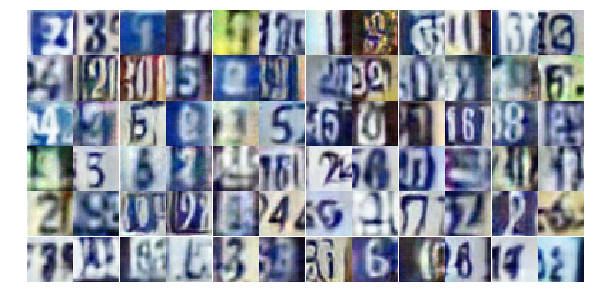

Epoch 21/25... Discriminator Loss: 0.7467... Generator Loss: 1.1466
Epoch 21/25... Discriminator Loss: 0.4203... Generator Loss: 1.7495
Epoch 21/25... Discriminator Loss: 1.2898... Generator Loss: 0.5091
Epoch 21/25... Discriminator Loss: 0.8029... Generator Loss: 1.1894
Epoch 21/25... Discriminator Loss: 1.0766... Generator Loss: 0.5669
Epoch 21/25... Discriminator Loss: 1.2904... Generator Loss: 0.5385
Epoch 21/25... Discriminator Loss: 0.6422... Generator Loss: 1.0264
Epoch 21/25... Discriminator Loss: 1.2540... Generator Loss: 0.4846
Epoch 21/25... Discriminator Loss: 1.2450... Generator Loss: 0.5282
Epoch 21/25... Discriminator Loss: 1.7971... Generator Loss: 0.2974


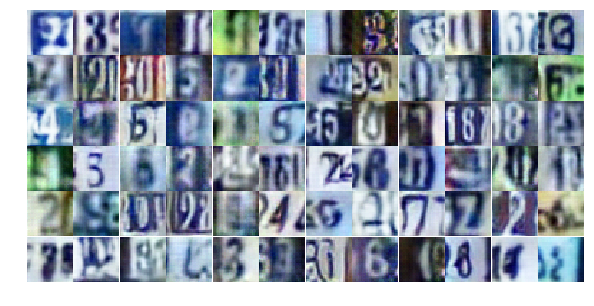

Epoch 21/25... Discriminator Loss: 0.8931... Generator Loss: 0.7691
Epoch 21/25... Discriminator Loss: 1.2726... Generator Loss: 0.4794
Epoch 21/25... Discriminator Loss: 1.0516... Generator Loss: 0.6053
Epoch 21/25... Discriminator Loss: 0.5428... Generator Loss: 1.2747
Epoch 21/25... Discriminator Loss: 0.4935... Generator Loss: 1.3671
Epoch 21/25... Discriminator Loss: 0.7182... Generator Loss: 1.0097
Epoch 21/25... Discriminator Loss: 0.6999... Generator Loss: 1.0180
Epoch 21/25... Discriminator Loss: 1.6645... Generator Loss: 0.2948
Epoch 21/25... Discriminator Loss: 0.4199... Generator Loss: 1.9284
Epoch 21/25... Discriminator Loss: 0.3819... Generator Loss: 3.5280


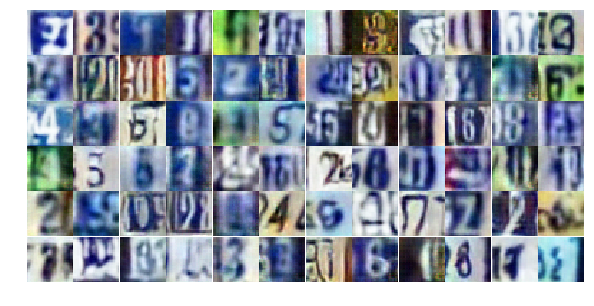

Epoch 21/25... Discriminator Loss: 0.6258... Generator Loss: 1.2659
Epoch 21/25... Discriminator Loss: 1.1959... Generator Loss: 0.5117
Epoch 21/25... Discriminator Loss: 0.5454... Generator Loss: 1.3413
Epoch 21/25... Discriminator Loss: 1.6782... Generator Loss: 0.3535
Epoch 21/25... Discriminator Loss: 0.3996... Generator Loss: 1.7113
Epoch 21/25... Discriminator Loss: 0.8099... Generator Loss: 0.8840
Epoch 21/25... Discriminator Loss: 1.0176... Generator Loss: 0.6204
Epoch 21/25... Discriminator Loss: 1.2660... Generator Loss: 0.6267
Epoch 21/25... Discriminator Loss: 1.2152... Generator Loss: 0.5939
Epoch 21/25... Discriminator Loss: 0.6745... Generator Loss: 1.2033


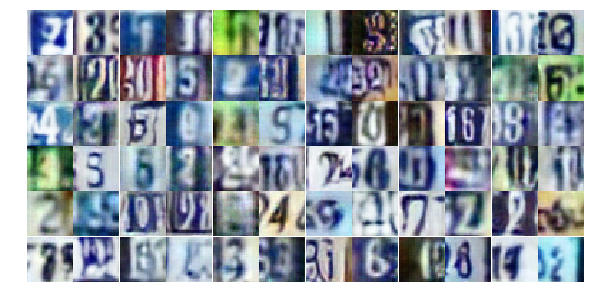

Epoch 21/25... Discriminator Loss: 0.6592... Generator Loss: 1.2683
Epoch 21/25... Discriminator Loss: 0.7146... Generator Loss: 1.5820
Epoch 21/25... Discriminator Loss: 1.1138... Generator Loss: 0.9293
Epoch 22/25... Discriminator Loss: 0.8259... Generator Loss: 1.5353
Epoch 22/25... Discriminator Loss: 0.8409... Generator Loss: 0.9124
Epoch 22/25... Discriminator Loss: 0.8452... Generator Loss: 0.9062
Epoch 22/25... Discriminator Loss: 0.5257... Generator Loss: 1.2480
Epoch 22/25... Discriminator Loss: 0.4840... Generator Loss: 2.1149
Epoch 22/25... Discriminator Loss: 2.0588... Generator Loss: 0.2084
Epoch 22/25... Discriminator Loss: 1.2966... Generator Loss: 0.4783


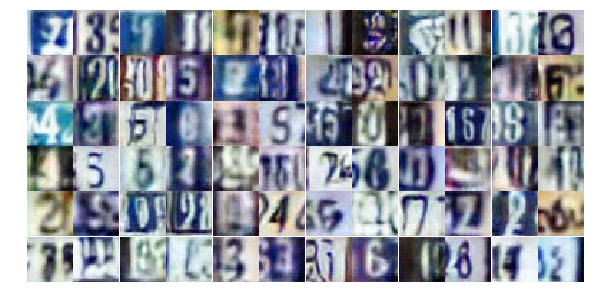

Epoch 22/25... Discriminator Loss: 0.6943... Generator Loss: 1.2132
Epoch 22/25... Discriminator Loss: 0.7912... Generator Loss: 0.9269
Epoch 22/25... Discriminator Loss: 1.1024... Generator Loss: 0.6584
Epoch 22/25... Discriminator Loss: 0.9696... Generator Loss: 0.7607
Epoch 22/25... Discriminator Loss: 0.8010... Generator Loss: 0.9050
Epoch 22/25... Discriminator Loss: 0.5824... Generator Loss: 1.3826
Epoch 22/25... Discriminator Loss: 0.9201... Generator Loss: 0.7309
Epoch 22/25... Discriminator Loss: 0.4279... Generator Loss: 1.6408
Epoch 22/25... Discriminator Loss: 1.4328... Generator Loss: 0.3708
Epoch 22/25... Discriminator Loss: 2.1306... Generator Loss: 0.2020


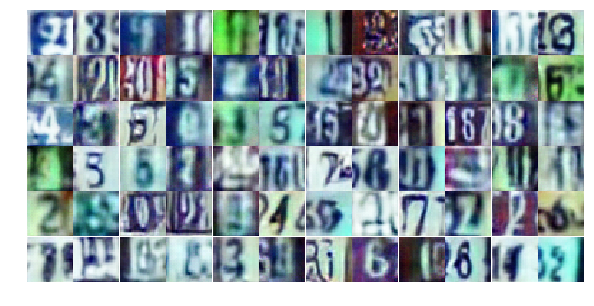

Epoch 22/25... Discriminator Loss: 0.5764... Generator Loss: 1.4785
Epoch 22/25... Discriminator Loss: 0.5913... Generator Loss: 1.3756
Epoch 22/25... Discriminator Loss: 0.6511... Generator Loss: 1.2004
Epoch 22/25... Discriminator Loss: 0.4428... Generator Loss: 1.5347
Epoch 22/25... Discriminator Loss: 0.7396... Generator Loss: 2.7624
Epoch 22/25... Discriminator Loss: 1.4047... Generator Loss: 0.4056
Epoch 22/25... Discriminator Loss: 0.5160... Generator Loss: 1.3524
Epoch 22/25... Discriminator Loss: 0.4672... Generator Loss: 1.4204
Epoch 22/25... Discriminator Loss: 0.6947... Generator Loss: 0.9834
Epoch 22/25... Discriminator Loss: 1.0863... Generator Loss: 0.5721


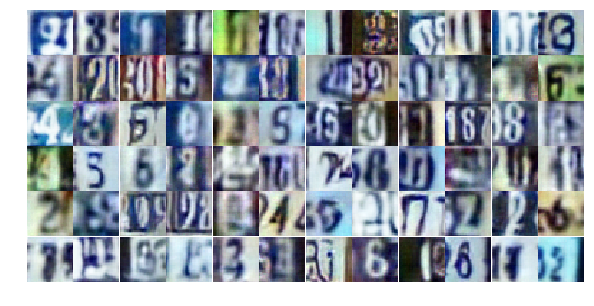

Epoch 22/25... Discriminator Loss: 0.5512... Generator Loss: 1.1253
Epoch 22/25... Discriminator Loss: 0.7182... Generator Loss: 0.9516
Epoch 22/25... Discriminator Loss: 0.8025... Generator Loss: 0.9049
Epoch 22/25... Discriminator Loss: 0.6502... Generator Loss: 1.1204
Epoch 22/25... Discriminator Loss: 1.1396... Generator Loss: 0.5246
Epoch 22/25... Discriminator Loss: 0.9017... Generator Loss: 0.8554
Epoch 22/25... Discriminator Loss: 1.7301... Generator Loss: 0.2776
Epoch 22/25... Discriminator Loss: 0.5228... Generator Loss: 2.2620
Epoch 22/25... Discriminator Loss: 1.1294... Generator Loss: 0.6832
Epoch 22/25... Discriminator Loss: 0.9403... Generator Loss: 0.6858


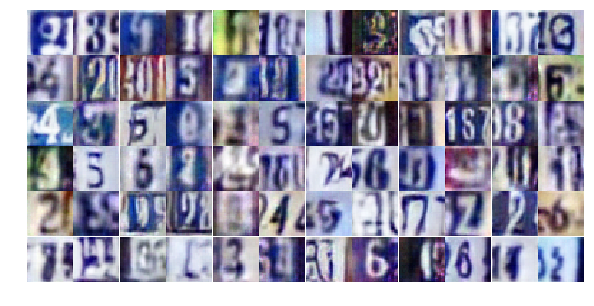

Epoch 22/25... Discriminator Loss: 0.6440... Generator Loss: 1.2893
Epoch 22/25... Discriminator Loss: 0.6137... Generator Loss: 1.2562
Epoch 22/25... Discriminator Loss: 0.4907... Generator Loss: 1.4612
Epoch 22/25... Discriminator Loss: 0.4003... Generator Loss: 1.6716
Epoch 22/25... Discriminator Loss: 0.4929... Generator Loss: 1.3241
Epoch 22/25... Discriminator Loss: 0.4702... Generator Loss: 1.3323
Epoch 22/25... Discriminator Loss: 0.6231... Generator Loss: 1.2180
Epoch 22/25... Discriminator Loss: 1.6825... Generator Loss: 0.3895
Epoch 22/25... Discriminator Loss: 1.3526... Generator Loss: 0.4570
Epoch 22/25... Discriminator Loss: 0.4654... Generator Loss: 1.5232


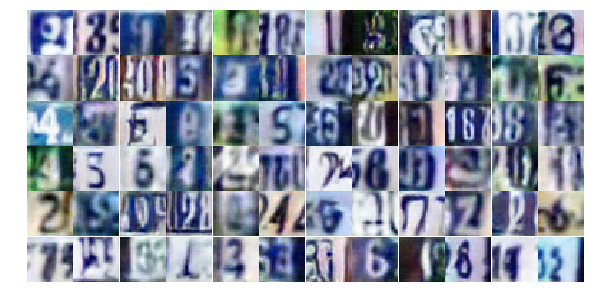

Epoch 22/25... Discriminator Loss: 1.0679... Generator Loss: 0.6112
Epoch 22/25... Discriminator Loss: 0.6579... Generator Loss: 0.9933
Epoch 22/25... Discriminator Loss: 0.7605... Generator Loss: 0.9196
Epoch 22/25... Discriminator Loss: 0.8585... Generator Loss: 0.9313
Epoch 22/25... Discriminator Loss: 1.2525... Generator Loss: 0.4770
Epoch 22/25... Discriminator Loss: 0.7115... Generator Loss: 1.1817
Epoch 22/25... Discriminator Loss: 2.0401... Generator Loss: 0.2285
Epoch 22/25... Discriminator Loss: 1.0364... Generator Loss: 2.3393
Epoch 22/25... Discriminator Loss: 0.9104... Generator Loss: 1.3624
Epoch 22/25... Discriminator Loss: 0.7098... Generator Loss: 1.3157


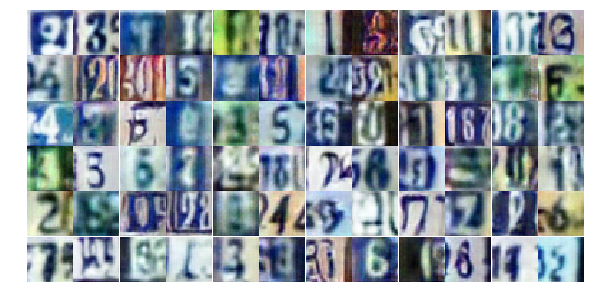

Epoch 23/25... Discriminator Loss: 0.6340... Generator Loss: 1.6530
Epoch 23/25... Discriminator Loss: 0.5712... Generator Loss: 1.4824
Epoch 23/25... Discriminator Loss: 1.2428... Generator Loss: 0.5072
Epoch 23/25... Discriminator Loss: 0.5785... Generator Loss: 1.3219
Epoch 23/25... Discriminator Loss: 0.7567... Generator Loss: 0.8896
Epoch 23/25... Discriminator Loss: 1.1770... Generator Loss: 0.5413
Epoch 23/25... Discriminator Loss: 1.5045... Generator Loss: 0.3935
Epoch 23/25... Discriminator Loss: 0.9247... Generator Loss: 0.7806
Epoch 23/25... Discriminator Loss: 0.6210... Generator Loss: 1.1602
Epoch 23/25... Discriminator Loss: 0.4409... Generator Loss: 1.5396


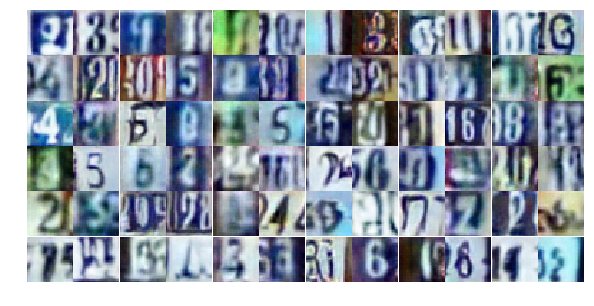

Epoch 23/25... Discriminator Loss: 0.6751... Generator Loss: 1.0370
Epoch 23/25... Discriminator Loss: 1.0062... Generator Loss: 0.7125
Epoch 23/25... Discriminator Loss: 0.7577... Generator Loss: 0.9814
Epoch 23/25... Discriminator Loss: 0.6622... Generator Loss: 1.0736
Epoch 23/25... Discriminator Loss: 0.5787... Generator Loss: 1.1459
Epoch 23/25... Discriminator Loss: 1.8979... Generator Loss: 0.2523
Epoch 23/25... Discriminator Loss: 0.9845... Generator Loss: 0.6928
Epoch 23/25... Discriminator Loss: 0.5871... Generator Loss: 1.5299
Epoch 23/25... Discriminator Loss: 1.1369... Generator Loss: 0.6035
Epoch 23/25... Discriminator Loss: 0.9088... Generator Loss: 0.9137


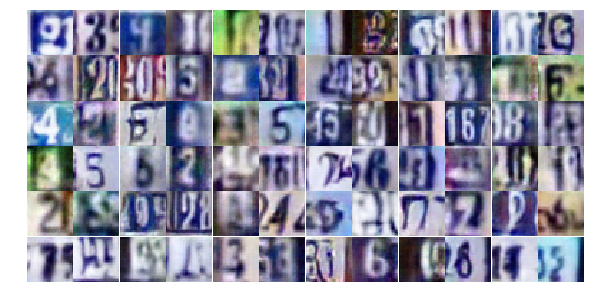

Epoch 23/25... Discriminator Loss: 1.9241... Generator Loss: 0.2783
Epoch 23/25... Discriminator Loss: 0.6374... Generator Loss: 1.7622
Epoch 23/25... Discriminator Loss: 1.4606... Generator Loss: 0.4016
Epoch 23/25... Discriminator Loss: 0.6629... Generator Loss: 1.1792
Epoch 23/25... Discriminator Loss: 0.5505... Generator Loss: 1.3630
Epoch 23/25... Discriminator Loss: 0.5611... Generator Loss: 2.1979
Epoch 23/25... Discriminator Loss: 0.4044... Generator Loss: 1.5159
Epoch 23/25... Discriminator Loss: 1.3966... Generator Loss: 0.3960
Epoch 23/25... Discriminator Loss: 0.6717... Generator Loss: 1.0779
Epoch 23/25... Discriminator Loss: 0.9888... Generator Loss: 1.7727


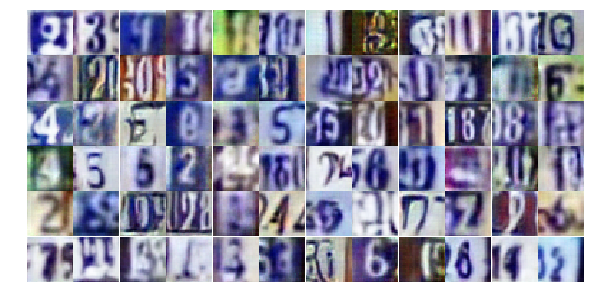

Epoch 23/25... Discriminator Loss: 0.6220... Generator Loss: 1.2493
Epoch 23/25... Discriminator Loss: 0.5257... Generator Loss: 1.4409
Epoch 23/25... Discriminator Loss: 0.8799... Generator Loss: 0.7967
Epoch 23/25... Discriminator Loss: 1.7056... Generator Loss: 0.3701
Epoch 23/25... Discriminator Loss: 0.7193... Generator Loss: 1.6362
Epoch 23/25... Discriminator Loss: 1.4085... Generator Loss: 0.4348
Epoch 23/25... Discriminator Loss: 1.0433... Generator Loss: 0.7158
Epoch 23/25... Discriminator Loss: 0.4975... Generator Loss: 1.5386
Epoch 23/25... Discriminator Loss: 0.5650... Generator Loss: 1.3467
Epoch 23/25... Discriminator Loss: 0.7362... Generator Loss: 0.9880


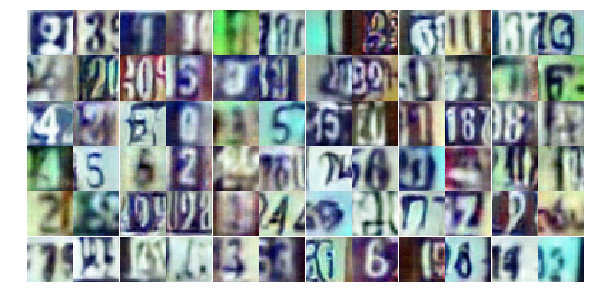

Epoch 23/25... Discriminator Loss: 0.6534... Generator Loss: 1.1034
Epoch 23/25... Discriminator Loss: 0.4425... Generator Loss: 2.0438
Epoch 23/25... Discriminator Loss: 0.6859... Generator Loss: 1.2373
Epoch 23/25... Discriminator Loss: 0.7465... Generator Loss: 0.9243
Epoch 23/25... Discriminator Loss: 1.2292... Generator Loss: 0.5383
Epoch 23/25... Discriminator Loss: 0.9414... Generator Loss: 0.7296
Epoch 23/25... Discriminator Loss: 0.6528... Generator Loss: 1.2194
Epoch 23/25... Discriminator Loss: 1.0238... Generator Loss: 0.7471
Epoch 23/25... Discriminator Loss: 0.7581... Generator Loss: 0.8782
Epoch 23/25... Discriminator Loss: 1.2241... Generator Loss: 0.6060


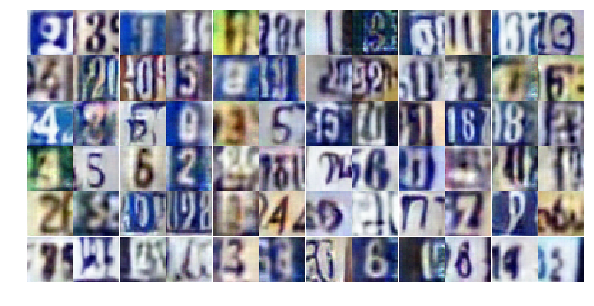

Epoch 23/25... Discriminator Loss: 0.7914... Generator Loss: 0.9171
Epoch 23/25... Discriminator Loss: 1.8089... Generator Loss: 0.2907
Epoch 23/25... Discriminator Loss: 0.9863... Generator Loss: 0.6843
Epoch 23/25... Discriminator Loss: 0.3570... Generator Loss: 1.8324
Epoch 23/25... Discriminator Loss: 1.7680... Generator Loss: 0.2834
Epoch 23/25... Discriminator Loss: 1.0147... Generator Loss: 0.7089
Epoch 23/25... Discriminator Loss: 0.8156... Generator Loss: 0.8771
Epoch 24/25... Discriminator Loss: 0.6414... Generator Loss: 1.1278
Epoch 24/25... Discriminator Loss: 1.2710... Generator Loss: 3.4755
Epoch 24/25... Discriminator Loss: 1.6185... Generator Loss: 1.0223


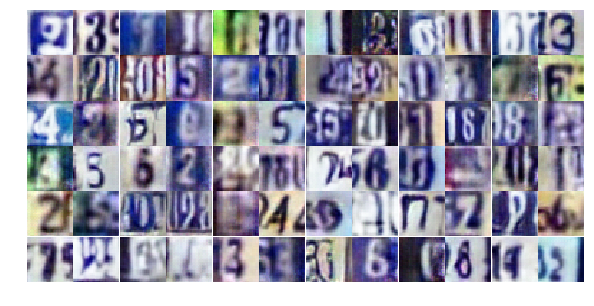

Epoch 24/25... Discriminator Loss: 0.6802... Generator Loss: 1.6303
Epoch 24/25... Discriminator Loss: 0.7301... Generator Loss: 1.0356
Epoch 24/25... Discriminator Loss: 0.6907... Generator Loss: 0.9476
Epoch 24/25... Discriminator Loss: 0.7463... Generator Loss: 1.3243
Epoch 24/25... Discriminator Loss: 0.9703... Generator Loss: 0.7194
Epoch 24/25... Discriminator Loss: 0.5988... Generator Loss: 1.3371
Epoch 24/25... Discriminator Loss: 0.7908... Generator Loss: 0.9102
Epoch 24/25... Discriminator Loss: 1.0939... Generator Loss: 0.6337
Epoch 24/25... Discriminator Loss: 0.3594... Generator Loss: 1.6667
Epoch 24/25... Discriminator Loss: 0.5749... Generator Loss: 1.2376


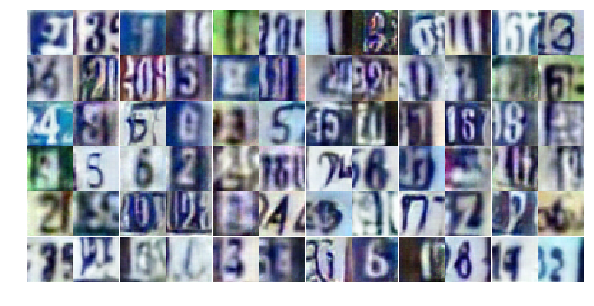

Epoch 24/25... Discriminator Loss: 1.1014... Generator Loss: 0.5745
Epoch 24/25... Discriminator Loss: 1.1891... Generator Loss: 0.5291
Epoch 24/25... Discriminator Loss: 1.3283... Generator Loss: 0.4917
Epoch 24/25... Discriminator Loss: 0.8561... Generator Loss: 0.7666
Epoch 24/25... Discriminator Loss: 0.3737... Generator Loss: 2.0478
Epoch 24/25... Discriminator Loss: 0.6914... Generator Loss: 1.2239
Epoch 24/25... Discriminator Loss: 0.5377... Generator Loss: 1.3596
Epoch 24/25... Discriminator Loss: 1.5949... Generator Loss: 0.3369
Epoch 24/25... Discriminator Loss: 1.1065... Generator Loss: 0.6315
Epoch 24/25... Discriminator Loss: 1.0747... Generator Loss: 0.6873


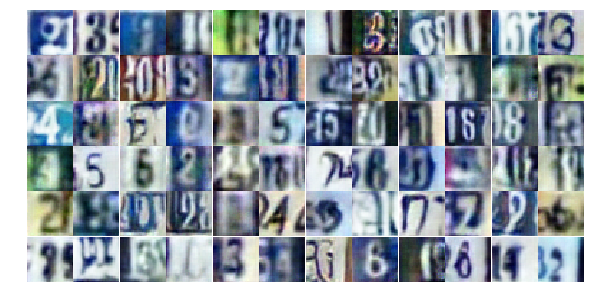

Epoch 24/25... Discriminator Loss: 0.7390... Generator Loss: 1.0232
Epoch 24/25... Discriminator Loss: 0.5932... Generator Loss: 1.2865
Epoch 24/25... Discriminator Loss: 0.6001... Generator Loss: 1.2572
Epoch 24/25... Discriminator Loss: 1.8325... Generator Loss: 0.2876
Epoch 24/25... Discriminator Loss: 0.7848... Generator Loss: 0.9089
Epoch 24/25... Discriminator Loss: 0.6499... Generator Loss: 1.1239
Epoch 24/25... Discriminator Loss: 0.7652... Generator Loss: 0.8642
Epoch 24/25... Discriminator Loss: 0.6632... Generator Loss: 1.1087
Epoch 24/25... Discriminator Loss: 1.1319... Generator Loss: 0.6278
Epoch 24/25... Discriminator Loss: 0.8832... Generator Loss: 0.8036


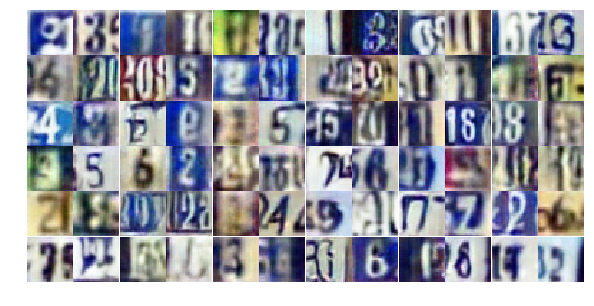

Epoch 24/25... Discriminator Loss: 0.3915... Generator Loss: 1.7363
Epoch 24/25... Discriminator Loss: 0.3941... Generator Loss: 2.3385
Epoch 24/25... Discriminator Loss: 1.8332... Generator Loss: 0.3138
Epoch 24/25... Discriminator Loss: 1.5251... Generator Loss: 0.3757
Epoch 24/25... Discriminator Loss: 1.2663... Generator Loss: 0.4904
Epoch 24/25... Discriminator Loss: 1.1150... Generator Loss: 0.5867
Epoch 24/25... Discriminator Loss: 1.2356... Generator Loss: 0.4791
Epoch 24/25... Discriminator Loss: 0.9347... Generator Loss: 0.6934
Epoch 24/25... Discriminator Loss: 0.9977... Generator Loss: 1.6570
Epoch 24/25... Discriminator Loss: 0.6316... Generator Loss: 1.3298


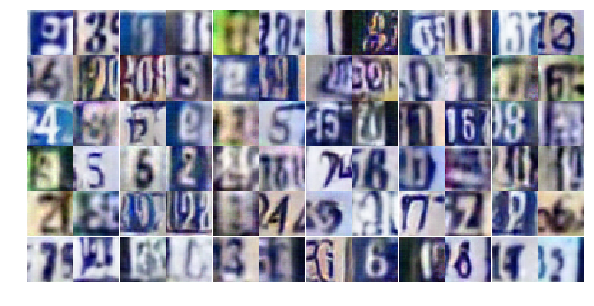

Epoch 24/25... Discriminator Loss: 0.7627... Generator Loss: 1.0309
Epoch 24/25... Discriminator Loss: 1.4743... Generator Loss: 0.4469
Epoch 24/25... Discriminator Loss: 1.3515... Generator Loss: 0.4177
Epoch 24/25... Discriminator Loss: 1.8404... Generator Loss: 0.2504
Epoch 24/25... Discriminator Loss: 1.2197... Generator Loss: 0.5113
Epoch 24/25... Discriminator Loss: 0.7286... Generator Loss: 1.8432
Epoch 24/25... Discriminator Loss: 1.1446... Generator Loss: 0.5566
Epoch 24/25... Discriminator Loss: 0.5532... Generator Loss: 1.2326
Epoch 24/25... Discriminator Loss: 0.8115... Generator Loss: 0.8073
Epoch 24/25... Discriminator Loss: 1.0116... Generator Loss: 0.8297


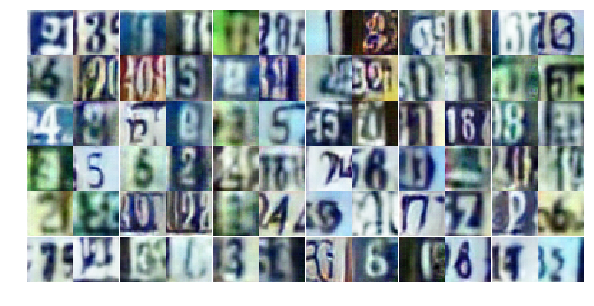

Epoch 24/25... Discriminator Loss: 1.1098... Generator Loss: 0.6028
Epoch 24/25... Discriminator Loss: 1.6971... Generator Loss: 0.3909
Epoch 24/25... Discriminator Loss: 0.6144... Generator Loss: 1.2376
Epoch 24/25... Discriminator Loss: 0.6798... Generator Loss: 1.0887
Epoch 24/25... Discriminator Loss: 1.1086... Generator Loss: 0.5833
Epoch 25/25... Discriminator Loss: 0.5405... Generator Loss: 1.5901
Epoch 25/25... Discriminator Loss: 0.5713... Generator Loss: 1.3408
Epoch 25/25... Discriminator Loss: 0.5153... Generator Loss: 1.4197
Epoch 25/25... Discriminator Loss: 0.7729... Generator Loss: 0.9693
Epoch 25/25... Discriminator Loss: 0.7868... Generator Loss: 0.9191


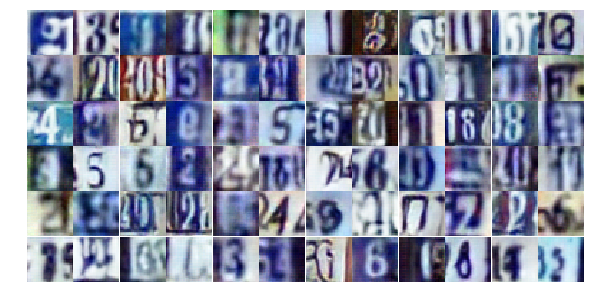

Epoch 25/25... Discriminator Loss: 0.9196... Generator Loss: 0.7099
Epoch 25/25... Discriminator Loss: 0.8075... Generator Loss: 0.9884
Epoch 25/25... Discriminator Loss: 0.8680... Generator Loss: 0.8412
Epoch 25/25... Discriminator Loss: 0.5752... Generator Loss: 1.3097
Epoch 25/25... Discriminator Loss: 1.0857... Generator Loss: 0.6368
Epoch 25/25... Discriminator Loss: 0.8972... Generator Loss: 0.8708
Epoch 25/25... Discriminator Loss: 0.7848... Generator Loss: 0.9481
Epoch 25/25... Discriminator Loss: 0.5714... Generator Loss: 1.3381
Epoch 25/25... Discriminator Loss: 0.5543... Generator Loss: 1.3106
Epoch 25/25... Discriminator Loss: 0.5889... Generator Loss: 1.3124


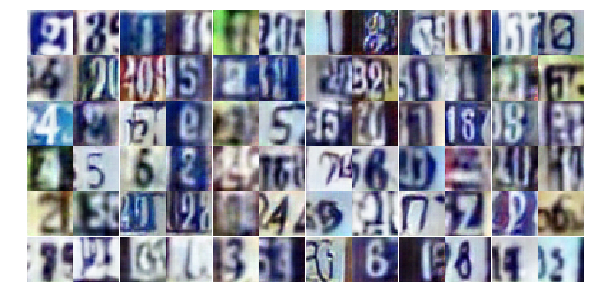

Epoch 25/25... Discriminator Loss: 0.7434... Generator Loss: 0.9841
Epoch 25/25... Discriminator Loss: 0.4710... Generator Loss: 1.7064
Epoch 25/25... Discriminator Loss: 1.6868... Generator Loss: 0.3491
Epoch 25/25... Discriminator Loss: 5.9672... Generator Loss: 0.2696
Epoch 25/25... Discriminator Loss: 1.4465... Generator Loss: 0.5145
Epoch 25/25... Discriminator Loss: 0.7373... Generator Loss: 1.0130
Epoch 25/25... Discriminator Loss: 0.6764... Generator Loss: 1.4414
Epoch 25/25... Discriminator Loss: 1.1977... Generator Loss: 0.5748
Epoch 25/25... Discriminator Loss: 0.6919... Generator Loss: 1.0205
Epoch 25/25... Discriminator Loss: 0.9624... Generator Loss: 0.7092


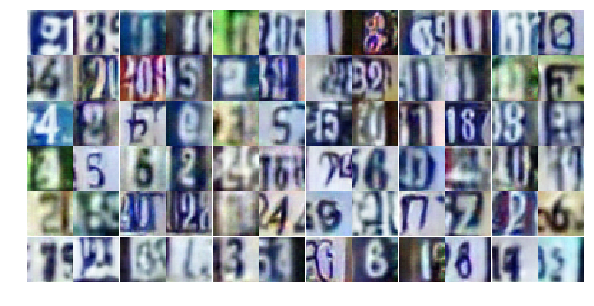

Epoch 25/25... Discriminator Loss: 0.7470... Generator Loss: 0.9071
Epoch 25/25... Discriminator Loss: 0.6017... Generator Loss: 1.2633
Epoch 25/25... Discriminator Loss: 1.6895... Generator Loss: 0.4189
Epoch 25/25... Discriminator Loss: 0.8396... Generator Loss: 0.7856
Epoch 25/25... Discriminator Loss: 0.9714... Generator Loss: 0.7499
Epoch 25/25... Discriminator Loss: 0.5482... Generator Loss: 1.2044
Epoch 25/25... Discriminator Loss: 0.8817... Generator Loss: 0.8647
Epoch 25/25... Discriminator Loss: 0.8771... Generator Loss: 0.8745
Epoch 25/25... Discriminator Loss: 1.1272... Generator Loss: 0.5877
Epoch 25/25... Discriminator Loss: 0.6633... Generator Loss: 1.0998


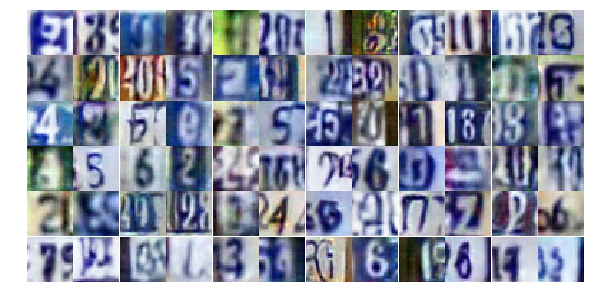

Epoch 25/25... Discriminator Loss: 1.0447... Generator Loss: 0.5994
Epoch 25/25... Discriminator Loss: 0.6340... Generator Loss: 1.4029
Epoch 25/25... Discriminator Loss: 0.8066... Generator Loss: 0.9236
Epoch 25/25... Discriminator Loss: 0.7497... Generator Loss: 0.8703
Epoch 25/25... Discriminator Loss: 1.1512... Generator Loss: 0.6116
Epoch 25/25... Discriminator Loss: 1.1610... Generator Loss: 0.5616
Epoch 25/25... Discriminator Loss: 0.4808... Generator Loss: 1.4017
Epoch 25/25... Discriminator Loss: 0.7353... Generator Loss: 1.0873
Epoch 25/25... Discriminator Loss: 1.6937... Generator Loss: 0.3306
Epoch 25/25... Discriminator Loss: 0.7548... Generator Loss: 0.9413


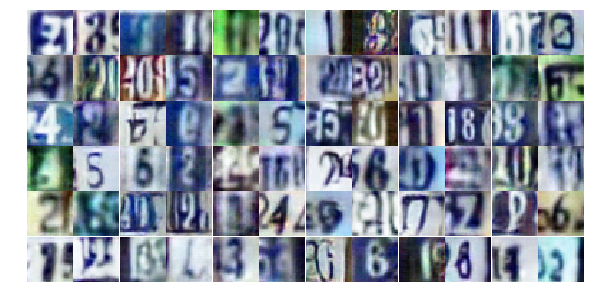

Epoch 25/25... Discriminator Loss: 0.8040... Generator Loss: 1.0654
Epoch 25/25... Discriminator Loss: 1.1737... Generator Loss: 0.5330
Epoch 25/25... Discriminator Loss: 0.8370... Generator Loss: 0.9094
Epoch 25/25... Discriminator Loss: 0.6676... Generator Loss: 1.1045
Epoch 25/25... Discriminator Loss: 1.1117... Generator Loss: 0.5662
Epoch 25/25... Discriminator Loss: 0.5032... Generator Loss: 1.1958
Epoch 25/25... Discriminator Loss: 1.3651... Generator Loss: 0.4757
Epoch 25/25... Discriminator Loss: 0.8929... Generator Loss: 0.9003
Epoch 25/25... Discriminator Loss: 0.7837... Generator Loss: 1.0471
Epoch 25/25... Discriminator Loss: 0.9862... Generator Loss: 0.7473


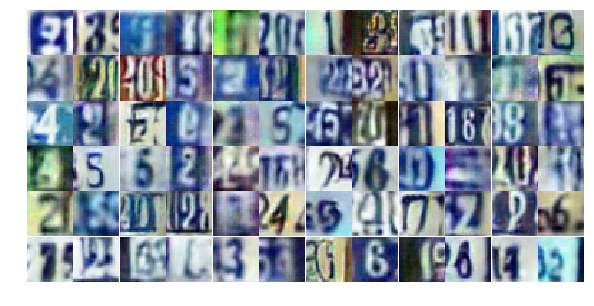

Epoch 25/25... Discriminator Loss: 0.4916... Generator Loss: 1.5216
Epoch 25/25... Discriminator Loss: 2.1565... Generator Loss: 0.2668


In [32]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

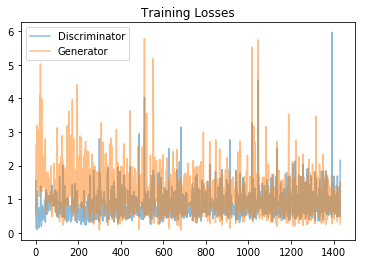

In [33]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

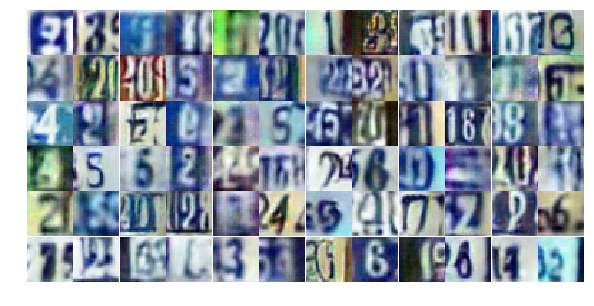

In [34]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))